In [1]:
import sys
import re
import unicodedata
from datetime import datetime, timedelta

import numpy as np
import pandas as pd
from pandas.tseries.offsets import DateOffset

import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.dates as mdates
import matplotlib.ticker as mticker
from matplotlib.ticker import ScalarFormatter, FuncFormatter
from matplotlib.patches import Patch
import seaborn as sns
from scipy.stats import chi2_contingency
import os
# ==== 日本語フォント（japanize-matplotlib） ====
# 未インストールのときだけ入れる（毎回の再インストールを避ける）
try:
    import japanize_matplotlib  # noqa: F401
except ModuleNotFoundError:
    import subprocess
    subprocess.check_call([sys.executable, "-m", "pip", "install", "-q", "japanize-matplotlib"])
    import japanize_matplotlib  # noqa: F401

In [2]:
# === 入出力ディレクトリ設定 ===
# 入力は project_root/inputs
INPUT_DIR = os.path.join(os.getcwd(), "output")
# 出力は project_root/outputs
OUTPUT_DIR = os.path.join(os.getcwd(), "output")

# ディレクトリが無ければ作成
os.makedirs(INPUT_DIR, exist_ok=True)
os.makedirs(OUTPUT_DIR, exist_ok=True)

print("INPUT_DIR:", INPUT_DIR)
print("OUTPUT_DIR:", OUTPUT_DIR)


INPUT_DIR: /Users/okada1015/Desktop/マリサ/marisa/output
OUTPUT_DIR: /Users/okada1015/Desktop/マリサ/marisa/output


In [3]:

# 表示行数・列数・文字数を増やす
pd.set_option("display.max_rows", None)    # 全行表示
pd.set_option("display.max_columns", None) # 全列表示
pd.set_option("display.max_colwidth", None) # 文字切り捨てなし

# 読み込み #

In [4]:
df_all = pd.read_csv(os.path.join(OUTPUT_DIR, "2.ALL_ASSESSMENT_REPORTS_WITH_FLG.csv"), parse_dates=['ASSESSED_ON'])

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3465633030.py:1: DtypeWarning: Columns (21,33,44,45,54,55,56,57,58,59,60,68,70,75,77,78,91,92,93,94,100,106,110,111,120,122,126,127,155,159,209,210,211,226,228,230,241,243,244,245,247,255,257,258,259,260,261,262,263,264,302,303,311,312,313,314,315,317,335,336,337,341,343,346,354,355,356,357,359) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(os.path.join(OUTPUT_DIR, "2.ALL_ASSESSMENT_REPORTS_WITH_FLG.csv"), parse_dates=['ASSESSED_ON'])


In [5]:
df_all.shape

(206788, 369)

In [ ]:
# 不要な列を削除
drop_cols = [
    'PROPERTY_NAME_N',
    'ADDED_ON',
    'LAND_SPACE_NUM',
    'APARTMENT_NAME_N',
    'OWNER_SPACE_NUM_ROUND2',
    '_merge',
    'HIT',
    'BUILDING_SPACE_NUM',
    'CID_N',
    'APARTMENT_NAME'
]

df_all = df_all.drop(columns=drop_cols, errors="ignore")

# 前処理 #

フラグのカラム名を変更

In [10]:
# カラム名の変更
df_all = df_all.rename(columns={"IS_DEAL_MATCH": "成約フラグ"})


築年数カラムの作成

In [11]:
# 日本語の築年月を日付型に変換する関数
def convert_jp_date(date_str):
    if pd.isna(date_str):
        return pd.NaT
    try:
        # Replace Japanese characters with standard format
        date_str = date_str.replace('年', '-').replace('月', '')
        return pd.to_datetime(date_str + '-01')  # Add day component
    except:
        return pd.NaT

# 築年数カラムの作成
df_all['BUILDING_AGE'] = (pd.to_datetime(df_all['ASSESSED_ON']) - df_all['ABOUT_BUILT_IN'].apply(convert_jp_date)).dt.total_seconds() / (365.25 * 24 * 60 * 60)

In [12]:
# BUILDING_AGEを小数点第1位で丸める
df_all['BUILDING_AGE'] = df_all['BUILDING_AGE'].round(1)


In [13]:
# 変換失敗件数の確認
converted_dates = df_all['ABOUT_BUILT_IN'].apply(convert_jp_date)
print(converted_dates.isna().sum())

26223


In [14]:
parsed = df_all['ABOUT_BUILT_IN'].apply(convert_jp_date)

# 非欠損なのにパース失敗した行
bad_mask = df_all['ABOUT_BUILT_IN'].notna() & parsed.isna()
print('非欠損だが解釈失敗件数:', bad_mask.sum())

# 代表的な値を確認（上位20件）
print(df_all.loc[bad_mask, 'ABOUT_BUILT_IN'].astype(str).value_counts().head(20))


非欠損だが解釈失敗件数: 1533
ABOUT_BUILT_IN
不明                     16
1994年　平成6年新築　築30年目      6
1980年　昭和55年新築　築44年目     5
2017年　平成29年新築　築7年目      5
平成18年4月建築               4
1978年　昭和53年新築　築46年目     4
不詳                      4
平成20年2月                 4
1989年　平成元年新築　築35年目      4
1977年　昭和52年新築　築47年目     4
1982年11月19日             3
2007年　平成19年新築　築17年目     3
1983年　昭和58年新築　築41年目     3
平成22年1月                 3
1991年3月19日              3
平成12年11月                3
1979年　昭和54年新築　築45年目     3
平成8年2月建築                3
平成11年4月                 3
平成23年3月建築               3
Name: count, dtype: int64


一部の変数について、欠損を０で埋める処理

In [15]:
#欠損０埋め
df_all['READ_COUNT'] = df_all['READ_COUNT'].fillna(0)

In [16]:
#欠損０埋め
df_all['TXT_NOTIFY_READ_AT'] = df_all['TXT_NOTIFY_READ_AT'].fillna(0)

In [17]:
# BUILDING_AGEを小数点第1位で丸める
df_all['BUILDING_AGE'] = df_all['BUILDING_AGE'].round(1)


築年数をbinに分けたカラムを作成

In [18]:

# ===== ① BUILDING_AGE のビン分け =====
# 仕様：
#   1年目（<=1年）
#   2〜9年
#   10〜19年
#   20〜29年
#   …
#   80年以上（>=80年）
#
# 年数の小数が入っていても意図どおりに分類できるよう、区間は (-inf,1], (1,9], (9,19], … と設計
age_bins   = [-np.inf, 1, 9, 19, 29, 39, 49, 59, 69, 79, np.inf]
age_labels = ["1年目", "2-9年", "10-19年", "20-29年", "30-39年",
              "40-49年", "50-59年", "60-69年", "70-79年", "80年以上"]

df_all["BUILDING_AGE_BIN"] = pd.cut(
    df_all["BUILDING_AGE"],
    bins=age_bins,
    labels=age_labels,
    right=True,              # 右閉区間：例) 9 は「2-9年」に入る
    include_lowest=True
)

# 順序付きカテゴリに
cat_type_age = pd.api.types.CategoricalDtype(categories=age_labels, ordered=True)
df_all["BUILDING_AGE_BIN"] = df_all["BUILDING_AGE_BIN"].astype(cat_type_age)

# ===== ② CONTENT_COUNT：0→0、1以上→1 =====
df_all["CONTENT_COUNT_FLG"] = (pd.to_numeric(df_all["CONTENT_COUNT"], errors="coerce").fillna(0) >= 1).astype(int)

# ===== ③ USER_ID：3730 かどうかでフラグ =====
df_all["USER_ID_3730_FLG"] = (df_all["USER_ID"] == 3730).astype(int)

# ===== ④ EXPENSE1_COMMISSION_RATE：3 か 5 なら 1、それ以外は 0 =====
# 数値/文字/割合(0.03等)混在でも頑健に処理
_rate_raw = pd.to_numeric(df_all["EXPENSE1_COMMISSION_RATE"], errors="coerce")

# 0〜1 の小数はパーセント値に変換（0.03 → 3.0）
_rate_pct = np.where((_rate_raw.notna()) & (_rate_raw <= 1), _rate_raw * 100, _rate_raw)
_rate_pct = pd.Series(_rate_pct, index=df_all.index)

df_all["EXPENSE1_COMMISSION_RATE_FLG"] = _rate_pct.isin([3, 5]).astype(int)


所有権フラグの作成

In [19]:
# 所有権なら1、その他は0
df_all["LAND_PRIVILEGE_FLG"] = (
    df_all["ABOUT_LAND_PRIVILEGE"].str.contains("所有権", na=False).astype(int)
)

用途地域を主要カテゴリに集約

In [20]:


# 代表カテゴリの順序（必要なら位置は調整OK）
usage_order = [
    "第一種低層住居専用地域","第二種低層住居専用地域",
    "第一種中高層住居専用地域","第二種中高層住居専用地域",
    "第一種住居地域","第二種住居地域","準住居地域",
    "近隣商業地域","商業地域",
    "準工業地域","工業地域","工業専用地域",
    "市街化調整区域",     # ← 追加（ここでは最後に置いています）
]

# 「市街化調整区域」検出用のゆるめ正規表現（全角半角/空白のゆらぎに対応）
RE_UA_ADJUST = re.compile(r'市\s*街\s*化\s*調\s*整\s*区\s*域')

def pick_head_or_next(area_str: str):
    """
    文字列から用途地域を抽出して代表カテゴリへ正規化。
    ルール:
      1) 文中に「市街化調整区域」を含む場合は無条件で「市街化調整区域」
      2) それ以外は、左から見て先頭が「無指定」でなければそれを候補、
         先頭が「無指定」なら次の非「無指定」を候補
      3) 候補が usage_order に無ければ None
    """
    if pd.isna(area_str):
        return None

    # 前処理：NFKC正規化
    text = unicodedata.normalize("NFKC", str(area_str)).strip()

    # --- 1) 「市街化調整区域」を最優先で検出（括弧内や注記付きも吸収） ---
    if RE_UA_ADJUST.search(text):
        return "市街化調整区域"

    # --- 2) 区切りで分割して先頭/次候補を選ぶ ---
    tokens = [t for t in re.split(r"[、，,／/・\s]+", text) if t]
    if not tokens:
        return None

    candidate = tokens[0] if tokens[0] != "無指定" else next((t for t in tokens[1:] if t != "無指定"), None)

    # --- 3) 用語ゆらぎがあればここで個別に正規化してから判定（例）---
    # 例: 「準住居」→「準住居地域」などを足したい場合はここで map する
    # alias_map = {"準住居": "準住居地域"}
    # if candidate in alias_map: candidate = alias_map[candidate]

    return candidate if candidate in usage_order else None

# 代表用途地域を作成
df_all["USAGE_AREA_REP"] = df_all["ABOUT_USAGE_AREA"].apply(pick_head_or_next)

# 順序付きカテゴリへ（NaNはNaNのまま）
cat_type = pd.api.types.CategoricalDtype(categories=usage_order, ordered=True)
df_all["USAGE_AREA_REP"] = df_all["USAGE_AREA_REP"].astype(cat_type)


In [21]:
df_all["USAGE_AREA_REP"].value_counts()

USAGE_AREA_REP
第一種住居地域         35589
第一種低層住居専用地域     31876
第一種中高層住居専用地域    27364
商業地域            27033
準工業地域           23601
近隣商業地域          12370
第二種中高層住居専用地域    10003
第二種住居地域          8574
工業地域             5067
準住居地域            2870
第二種低層住居専用地域       903
市街化調整区域           284
工業専用地域            100
Name: count, dtype: int64

In [22]:
# もともと欠損していないのに、抽出後はNaNになったものを抽出
mask = df_all['ABOUT_USAGE_AREA'].notna() & df_all['USAGE_AREA_REP'].isna()
problematic_rows = df_all.loc[mask, 'ABOUT_USAGE_AREA']

print("=== ABOUT_USAGE_AREA では値あり、ABOUT_USAGE_AREA_REP で NaN になった例 ===")
print(problematic_rows.unique()[:50])  # 例として最大50種類だけ表示

=== ABOUT_USAGE_AREA では値あり、ABOUT_USAGE_AREA_REP で NaN になった例 ===
['無指定' '指定無し' '無指定、無指定' '第二種住居専用地域' '第1種中高層住居専用地域' '第1種中高層専用住宅地域'
 '第一種住居専用地域' '第一種住居' '第一種低層住居専用' '第一種中高層地域' '第2種中高層住居専用地域' '第１種住居地域'
 '第2種中高層専用住宅地域' '第１種低層住居専用地域' '2種低層' '都市計画区域外' '無指定地域' '未指定地域' '近隣商業'
 '第一種低層住居' '第1種住居地域' '第１種中高層住居専用地域' '第１ 種中⾼層住居専⽤地域' '第2種住居地域'
 '第1種低層住居専用地域' '都市計画区域外、指定無' '-' '第一種住居住居専用地域' '第２種中高層住居専用地域' '第一種低層'
 '近隣商業 / 第一種高層' '未指定' '第二種中高層住居地域' '第1種中高層' '第 1 種中高層住居専用地域' '第1種低層住居地域'
 '2種住居専用地域' '第一種' '市街化区域、準工業地域' '1種中高層住居専用地域' '一種住居地域' '二種中高層住居専用地域'
 '指定無し地域' '第一種中高層' '準工業地域(特別工業地区)' '第２種住居地域' '第２種低層住居専用地域' '第2種低層住居専用地域'
 '一種中高層住居専用地域' '第二種中低層住居専用地域']


建物構造について主要なものに分類

In [23]:
# 建物構造の分類
def classify_structure(s: str):
    if pd.isna(s):
        return None
    t = str(s)

    # 優先度: SRC → RC → 軽量鉄骨 → 木造 → 鉄骨
    if ("SRC" in t) or ("鉄骨鉄筋コンクリート" in t):
        return "SRC"

    if ("RC" in t) or ("鉄筋コンクリート" in t) or ("PC" in t) or ("プレキャスト" in t):
        return "RC"

    if "軽量鉄骨" in t:
        return "軽量鉄骨"

    # 木造（瓦葺・2x4・ツーバイフォー等も包含）
    t_lower = t.lower()
    if ("木造" in t or "瓦葺" in t or "２×４" in t or "2x4" in t_lower 
        or "ツーバイフォー" in t or "Ｗ造" in t or "W造" in t):
        return "木造"

    if ("鉄骨" in t) or ("S造" in t) or ("Ｓ造" in t):
        return "鉄骨"

    return "その他"

# 変換カラム更新
order = ["SRC", "RC", "鉄骨", "軽量鉄骨", "木造", "その他"]
cat_type = pd.api.types.CategoricalDtype(categories=order, ordered=True)
df_all["STRUCTURE_CAT"] = df_all["ABOUT_STRUCTURE"].apply(classify_structure).astype(cat_type)




In [24]:
# 「その他」に分類された ABOUT_STRUCTURE を確認
others = df_all.loc[df_all["STRUCTURE_CAT"] == "その他", "ABOUT_STRUCTURE"]

others_unique = others.unique()
print(others_unique)


['その他' 'ブロック' '⽊造⽡葺2階建' 'ブロック造' 'けい' '鉄筋軽量コンクリート造' '鉄筋工ンクリート造陸屋根' 'ＲＣ造'
 '未登記建物につき不明' '不明' '木・ブロック造亜鉛メッキ鋼板葺' 'コンクリートブロック造陸屋根平家建' 'ブロック造亜鉛メッキ鋼板葺']


In [25]:
# 構造の分類結果を確認
df_all["STRUCTURE_CAT"].value_counts()

STRUCTURE_CAT
RC      86220
木造      61913
SRC     27917
軽量鉄骨     3396
鉄骨       1947
その他       548
Name: count, dtype: int64

WEB査定書閲覧フラグの作成

In [26]:
# SP_READ_AT が欠損値でなければ 1、欠損なら 0 をフラグ化
df_all['SP_READ_FLG'] = df_all['SP_READ_AT'].notna().astype(int)


バルコニー方向を角度に変換

In [27]:
# DIRECTIONを数値から角度に変換（0〜360度）
# 角度に変換（0〜360度）
df_all["DIRECTION_DEG"] = (df_all["DIRECTION"] - 1) * 45  # DIRECTIONは1〜8の想定

# ラジアン変換
radians = np.deg2rad(df_all["DIRECTION_DEG"])

# sin, cos のカラムを追加
df_all["DIRECTION_SIN"] = np.sin(radians)
df_all["DIRECTION_COS"] = np.cos(radians)

In [28]:
# DIRECTIONを順序付きカテゴリ型へ変換
# 順序定義（整数として扱う）
direction_order = [1, 2, 3, 4, 5, 6, 7, 8]

# CategoricalDtype を定義（順序あり）
cat_type = pd.api.types.CategoricalDtype(categories=direction_order, ordered=True)

# DIRECTION を順序付きカテゴリに変換
df_all["DIRECTION"] = df_all["DIRECTION"].astype(cat_type)

USER_IDについて順序付きカテゴリに変換

In [29]:
# USER_IDを順序付きカテゴリに変換

# USER_ID のユニーク値を昇順に並べる
user_order = sorted(df_all["USER_ID"].dropna().unique())

# CategoricalDtype を作成（順序あり）
cat_type_user = pd.api.types.CategoricalDtype(categories=user_order, ordered=True)

# USER_ID を順序付きカテゴリ型に変換
df_all["USER_ID"] = df_all["USER_ID"].astype(cat_type_user)

# 確認
print(df_all["USER_ID"].dtype)
print(df_all["USER_ID"].cat.categories[:10])  # 上位10カテゴリだけ表示


category
Index([1, 3, 6, 31, 39, 45, 46, 78, 88, 201], dtype='int64')


## 住所を都道府県に変換 ##

In [30]:
df_all['ABOUT_ADDRESS']

0                                                            東京都板橋区前野町２丁目２４－２４
1                                                            大阪府大阪市天王寺区生玉町１－２６
2                                                             長野県松本市村井町南１丁目6-1
3                                                             長野県松本市村井町南１丁目6-1
4                                                              千葉県市川市真間５丁目13-3
5                                                                  茨城県筑西市幸町３丁目
6                                                             大阪府大阪市阿倍野区阪南町１丁目
7                                                             千葉県松戸市東松戸３丁目8−20
8                                                                     長野県中野市中野
9                                                                岡山県倉敷市連島中央５丁目
10                                                               長野県中野市中野306-2
11                                                               岡山県倉敷市連島中央５丁目
12                                                  

In [31]:

s = df_all['ABOUT_ADDRESS'].astype(str).str.strip()

# 都道府県の抽出
PREFS = ['北海道','青森県','岩手県','宮城県','秋田県','山形県','福島県','茨城県','栃木県','群馬県',
         '埼玉県','千葉県','東京都','神奈川県','新潟県','富山県','石川県','福井県','山梨県','長野県',
         '岐阜県','静岡県','愛知県','三重県','滋賀県','京都府','大阪府','兵庫県','奈良県','和歌山県',
         '鳥取県','島根県','岡山県','広島県','山口県','徳島県','香川県','愛媛県','高知県',
         '福岡県','佐賀県','長崎県','熊本県','大分県','宮崎県','鹿児島県','沖縄県']
pref_pattern = r'^(' + '|'.join(PREFS) + r')'

# ① 抽出しつつ string dtype に（<NA> を使える）
df_all['PREFECTURE'] = s.str.extract(pref_pattern, expand=False).astype('string')

# ② まず PREF_SOURCE を string dtype の <NA> で初期化（←ここがポイント）
df_all['PREF_SOURCE'] = pd.Series(pd.NA, index=df_all.index, dtype='string')

# ③ 都道府県が取れた行にだけ 'head_pref' を入れる（np.where は使わない）
mask_head = df_all['PREFECTURE'].notna()
df_all.loc[mask_head, 'PREF_SOURCE'] = 'head_pref'

# 2) 東京23区 → 東京都
TOKYO_WARDS = ['千代田区','中央区','港区','新宿区','文京区','台東区','墨田区','江東区',
               '品川区','目黒区','大田区','世田谷区','渋谷区','中野区','杉並区','豊島区',
               '北区','荒川区','板橋区','練馬区','足立区','葛飾区','江戸川区']
ward_pattern = r'^(' + '|'.join(TOKYO_WARDS) + r')'
mask = df_all['PREFECTURE'].isna()
df_all.loc[mask & s.str.match(ward_pattern), 'PREFECTURE'] = '東京都'
df_all.loc[mask & s.str.match(ward_pattern), 'PREF_SOURCE']  = 'tokyo_ward'

# 3) 市区町村辞書（必要に応じて拡張）
MUNI2PREF = {
    # --- 政令指定都市 ---
    '札幌市': '北海道',
    '仙台市': '宮城県',
    'さいたま市': '埼玉県',
    '千葉市': '千葉県',
    '横浜市': '神奈川県',
    '川崎市': '神奈川県',
    '相模原市': '神奈川県',
    '新潟市': '新潟県',
    '静岡市': '静岡県',
    '浜松市': '静岡県',
    '名古屋市': '愛知県',
    '京都市': '京都府',
    '大阪市': '大阪府',
    '堺市': '大阪府',
    '神戸市': '兵庫県',
    '岡山市': '岡山県',
    '広島市': '広島県',
    '北九州市': '福岡県',
    '福岡市': '福岡県',
    '熊本市': '熊本県',
    # --- よく出る主要市（例） ---
    '松本市': '長野県', '長野市': '長野県', '金沢市': '石川県', '富山市': '富山県',
    '高崎市': '群馬県', '宇都宮市': '栃木県', '前橋市': '群馬県', '水戸市': '茨城県',
    '船橋市': '千葉県', '市川市': '千葉県', '柏市': '千葉県', '川越市': '埼玉県',
    '所沢市': '埼玉県', '越谷市': '埼玉県', '横須賀市': '神奈川県', '藤沢市': '神奈川県',
    '鎌倉市': '神奈川県', '逗子市': '神奈川県', '厚木市': '神奈川県', '平塚市': '神奈川県',
    '西宮市': '兵庫県', '姫路市': '兵庫県', '尼崎市': '兵庫県', '明石市': '兵庫県',
    '奈良市': '奈良県', '和歌山市': '和歌山県',
    '岡崎市': '愛知県', '豊田市': '愛知県', '一宮市': '愛知県',
    '岐阜市': '岐阜県', '大垣市': '岐阜県',
    '静岡市': '静岡県', '沼津市': '静岡県', '富士市': '静岡県',
    '北見市': '北海道', '帯広市': '北海道', '旭川市': '北海道',
    # --- 郡部の例（必要に応じて追加） ---
    '上伊那郡箕輪町': '長野県', '上伊那郡南箕輪村': '長野県', '上益城郡益城町': '熊本県',
    '北佐久郡軽井沢町': '長野県', '南都留郡富士河口湖町': '山梨県',
}

# 市区町村候補の抽出関数（先頭の1トークンを抜く）
def extract_muni_head(addr: str) -> str | None:
    if not isinstance(addr, str) or addr == '':
        return None
    a = addr.strip()
    # 既に都道府県で始まる場合は除去してから見る（東京都台東区… → 台東区…）
    m = re.match(pref_pattern, a)
    if m:
        a = a[m.end():]

    # 代表的なパターン順にマッチ
    # 例：横浜市港北区… → 横浜市
    m = re.match(r'^(.+?市)', a)
    if m: return m.group(1)

    # 例：上伊那郡箕輪町… → 上伊那郡箕輪町
    m = re.match(r'^(.+?郡.+?(町|村))', a)
    if m: return m.group(1)

    # 町・村単独開始（市や郡が無いケース） 例：○○町△△ → ○○町
    m = re.match(r'^(.+?町)', a)
    if m: return m.group(1)
    m = re.match(r'^(.+?村)', a)
    if m: return m.group(1)

    # 区単独（基本は東京23区のみを想定）
    m = re.match(r'^(.+?区)', a)
    if m: return m.group(1)

    return None

# 3) 市区町村辞書で補完
mask = df_all['PREFECTURE'].isna()
muni = s[mask].apply(extract_muni_head)

# ヒットするものを埋める
hit = muni.map(MUNI2PREF)
df_all.loc[mask & hit.notna(), 'PREFECTURE'] = hit[hit.notna()]
df_all.loc[mask & hit.notna(), 'PREF_SOURCE'] = 'muni_dict'

# 4) まだ空のものは、先頭市区町村候補を列に出し、頻出順で一覧表示（辞書拡張用）
df_all.loc[mask & df_all['PREFECTURE'].isna(), 'MUNI_CAND'] = muni[muni.notna()]
unresolved = df_all.loc[df_all['PREFECTURE'].isna(), 'MUNI_CAND'].value_counts().head(50)
print('--- 未解決の市区町村候補Top50（辞書に追加してください） ---')
print(unresolved.to_string())

# 結果の確認
print('抽出率:', round(df_all['PREFECTURE'].notna().mean()*100, 1), '%')
print(df_all['PREF_SOURCE'].value_counts(dropna=False).to_string())



--- 未解決の市区町村候補Top50（辞書に追加してください） ---
MUNI_CAND
熊谷市     304
川口市     235
釧路市     128
調布市     100
戸田市      82
浦安市      82
府中市      81
三鷹市      81
長崎市      75
米子市      68
茅ヶ崎市     64
八王子市     63
朝霞市      63
倉敷市      58
習志野市     57
那覇市      56
鹿児島市     55
網走市      53
津市       52
多摩市      51
町田市      49
天童市      49
立川市      43
吹田市      41
豊中市      39
小金井市     36
武蔵野市     36
草加市      35
小平市      35
東広島市     35
大分市      34
東村山市     33
西東京市     33
宮崎市      33
流山市      32
松戸市      31
山形市      31
狛江市      30
国立市      29
蕨市       28
久留米市     28
和光市      25
大和市      25
浦添市      25
東根市      24
枚方市      23
国分寺市     23
東大阪市     22
日野市      20
緑区       20
抽出率: 98.1 %
PREF_SOURCE
head_pref     190982
muni_dict       6738
tokyo_ward      5154
<NA>            3914


In [32]:
# 既存の MUNI2PREF を上書き延長
MUNI2PREF.update({
    '春日井市': '愛知県','東広島市': '広島県','廿日市': '広島県','川口市': '埼玉県',
    '中野町': '長野県',        # ※複数県に同名あり、長野県中野市中野町想定
    '恵庭市': '北海道','白山市': '石川県',
    '中区住吉町': '愛知県',   # 名古屋市中区住吉町
    '安佐北区': '広島県',     # 広島市安佐北区
    '石狩市': '北海道','下都賀郡野木町': '栃木県','北広島市': '北海道','三原市': '広島県','高石市': '大阪府','武蔵村山市': '東京都','河北郡津幡町': '石川県','網走郡美幌町': '北海道',
    '稲沢市': '愛知県','加賀市': '石川県','茅ヶ崎市': '神奈川県','丹羽郡大口町': '愛知県',
    '北葛飾郡杉戸町': '埼玉県','鯖江市': '福井県','千葉市': '千葉県','松山市': '愛媛県','小牧市': '愛知県','須坂市': '長野県','北名古屋市': '愛知県','小樽市': '北海道','門真市': '大阪府',
    '大野城市': '福岡県','八王子市': '東京都','城陽市': '京都府','藤井寺市': '大阪府','さいたま市': '埼玉県','愛知郡東郷町': '愛知県','筑紫野市': '福岡県','太宰府市': '福岡県',
    '春日市': '福岡県','野々市': '石川県','松戸市': '千葉県',
    '川崎区': '神奈川県',     # 川崎市川崎区
    '緑区': '神奈川県',       # 横浜市緑区（要確認）
    '加古郡播磨町': '兵庫県','加古川市': '兵庫県','佐世保市': '長崎県',
    '渡瀬町': '群馬県',       # 桐生市渡瀬町想定
    '岩倉市': '愛知県','弘前市': '青森県','総社市': '岡山県','別府市': '大分県','大和市': '神奈川県','焼津市': '静岡県','甲賀市': '滋賀県','東伯郡琴浦町': '鳥取県','島田市': '静岡県',
    '保土ケ谷区狩場町': '神奈川県',  # 横浜市保土ケ谷区
    '千歳市': '北海道',
    '金沢区': '神奈川県',     # 横浜市金沢区
    '浦和区': '埼玉県',       # さいたま市浦和区
    '多治見市': '岐阜県','向日市': '京都府',
    '手稲本町': '北海道',     # 札幌市手稲区
    '保土ヶ谷区': '神奈川県', # 横浜市保土ケ谷区
    '江戸川区': '東京都','紋別市': '北海道',
    '西成区': '大阪府',       # 大阪市西成区
    '日進市': '愛知県','浦添市': '沖縄県',
    '練馬区': '東京都','那珂川市': '福岡県',
    '天白区': '愛知県',       # 名古屋市天白区
    'みよし市': '愛知県','大阪市': '大阪府','北見市': '北海道','鳥取市': '鳥取県','古河市': '茨城県',
    '筑後市': '福岡県','瑞穂区': '愛知県',       # 名古屋市瑞穂区
    '西白河郡矢吹町': '福島県','青梅市': '東京都','増毛郡増毛町': '北海道','山形市': '山形県','東大阪市': '大阪府','富谷市': '宮城県',
    '大府市': '愛知県',
    '東根市': '山形県',
    '寝屋川市': '大阪府',
    '西伯郡南部町': '鳥取県',
    '小郡市': '福岡県',
    '富津市': '千葉県',
    '豊明市': '愛知県',
    '岩槻区城町': '埼玉県',   # さいたま市岩槻区
    '港南区': '神奈川県',     # 横浜市港南区
    '中川郡幕別町': '北海道',
    '武蔵野市': '東京都',
    '和泉市': '大阪府',
    '河西郡芽室町': '北海道',
    'ひたちなか市': '茨城県',
    '岩見沢市': '北海道',
    '呉市': '広島県',
    '八女市': '福岡県',
    '寒河江市': '山形県',
    '尾花沢市': '山形県',
    '大分市': '大分県',
    '松江市': '島根県',
    '菊池郡菊陽町': '熊本県',
    '合志市': '熊本県',
    '東区': '福岡県',        # 福岡市東区
    '河東郡音更町': '北海道',
    '西村山郡大江町': '山形県',
    '小清水町': '北海道',
    '清田区': '北海道',      # 札幌市清田区
    '東海市': '愛知県',
    '釧路郡釧路町': '北海道',
    '東彼杵郡川棚町': '長崎県',
    '成田市': '千葉県',
    '湖南市': '滋賀県',
    '栄町': '千葉県',
    '行田市': '埼玉県',
    '海老名市': '神奈川県',
    '新発田市': '新潟県',
    '境港市': '鳥取県',
    '白井市': '千葉県',
    '西伯郡伯耆町': '鳥取県',
    '羽生市': '埼玉県',
    '枚方市': '大阪府',
    '守口市': '大阪府',
    '高知市': '高知県',
    '北見市': '北海道',
    '虻田郡俱知安町': '北海道',
    '伊勢市': '三重県',
    'つくば市': '茨城県',
    '町田市': '東京都',
    '深谷市': '埼玉県',
    '西彼杵郡長与町': '長崎県',
    '泉佐野市': '大阪府',
    '地番：市': None,        # 不明
    '松阪市': '三重県',
    '千種区': '愛知県',      # 名古屋市千種区
    '十勝郡浦幌町': '北海道',
    '印西市': '千葉県',
    '根室市': '北海道',
    '高槻市': '大阪府',
    '安武町': '福岡県',      # 久留米市安武町
    '諫早市': '長崎県',
    '豊橋市': '愛知県',
    '取手市': '茨城県',
    '志木市': '埼玉県',
    '龍ケ崎市': '茨城県',
    '斜里郡斜里町': '北海道',
    '名取市': '宮城県',
    '三浦郡葉山町': '神奈川県',
    '茅野市': '長野県',
    '狛江市': '東京都',
    '春日部市': '埼玉県',
    '亘理郡亘理町': '宮城県',
    '我孫子市': '千葉県',
    '神奈川区三ツ沢東町': '神奈川県', # 横浜市神奈川区
    '葛飾区': '東京都',
    '鶴見区': '神奈川県',    # 横浜市鶴見区
    '日野市': '東京都',
    '丸亀市': '香川県',
    '小山市': '栃木県',
    '磯子区岡村': '神奈川県', # 横浜市磯子区
    '大和田特定土地区': None, # 不明
    '岡崎市': '愛知県',
    'あきる野市': '東京都',
    '港北区': '神奈川県',   # 横浜市港北区
    '長久手市': '愛知県',
    '石神井町': '東京都',   # 練馬区石神井町
    '福山市': '広島県',
    '上尾市': '埼玉県',
    '斜里郡小清水町': '北海道',
    '江別市': '北海道',
    '斜里町': '北海道',
    '西伯郡大山町': '鳥取県',
    '豊中市': '大阪府',
    '座間市': '神奈川県',
    '四街道市': '千葉県',
    '芦屋市': '兵庫県',
    '東村山市': '東京都',
    '和光市': '埼玉県',
    '大阪狭山市': '大阪府',
    '蕨市': '埼玉県',
    '流山市': '千葉県',
    'ふじみ野市': '埼玉県',
    '成田市': '千葉県',
    '草加市': '埼玉県',
    '小金井市': '東京都',
    '貝塚市': '大阪府',
    '小平市': '東京都',
    '富士見市': '埼玉県',
    '沖縄市': '沖縄県',
    '宜野湾市': '沖縄県',
    '宮崎市': '宮崎県',
    '糟屋郡志免町': '福岡県',
    '大分市': '大分県',
    '鶴岡市': '山形県',
    '松原市': '大阪府',
    '小田原市': '神奈川県',
    '尾道市': '広島県',
    '国立市': '東京都',
    '各務原市': '岐阜県',
    '福津市': '福岡県',
    '生駒市': '奈良県',
    '西東京市': '東京都',
    '市原市': '千葉県',
    '茨木市': '大阪府',
    '盛岡市': '岩手県',
    '四日市市': '三重県',
    '知立市': '愛知県',
    '網走郡津別町': '北海道',
    '高石市': '大阪府',
    '摂津市': '大阪府',
    '宗像市': '福岡県',
    '三田市': '兵庫県',
    '三島市': '静岡県',
    '夷隅郡御宿町': '千葉県',
    '野洲市': '滋賀県',
    '福生市': '東京都',
    '河内長野市': '大阪府',
    '八千代市': '千葉県',
    '箕面市': '大阪府',
    '岸和田市': '大阪府',
    '池田市': '大阪府',
    '菊池郡大津町': '熊本県',
    '宇治市': '京都府',
    '伊丹市': '兵庫県',
    '糸島市': '福岡県',
    '野田市': '千葉県',
    '土浦市': '茨城県',
    '豊見城市': '沖縄県',
    '桶川市': '埼玉県',
    '上山市': '山形県',
    '北本市': '埼玉県',
    '島尻郡南風原町': '沖縄県',
    '東久留米市': '東京都',
    '清瀬市': '東京都',
    '鴻巣市': '埼玉県',
    '伊勢原市': '神奈川県',
    '稲城市': '東京都',
    '南埼玉郡宮代町': '埼玉県',
    '三浦市': '神奈川県',
    '白井市': '千葉県',
    '大村市': '長崎県',
    '鶴ヶ島市': '埼玉県',
    '高槻市': '大阪府',
    '糸満市': '沖縄県',
    '吾妻郡草津町': '群馬県',
    '秦野市': '神奈川県',
    'いすみ市': '千葉県',
    '入間郡毛呂山町': '埼玉県',
    '飯能市': '埼玉県',
    '牛久市': '茨城県',
    '刈谷市': '愛知県',
    '東住吉区': '大阪府',   # 大阪市東住吉区
    '阿倍野区昭和町': '大阪府', # 大阪市阿倍野区
    '荒尾市': '熊本県',
    '高松市': '香川県',
    '西彼杵郡時津町': '長崎県',
    '笛吹市': '山梨県',
    '霧島市': '鹿児島県',
    '入間郡越生町': '埼玉県',
    '伊東市': '静岡県',
    '加東市': '兵庫県',
    '茂原市': '千葉県',
    '大牟田市': '福岡県',
    '防府市': '山口県',
    '郡山市': '福島県',
    '太田市': '群馬県',
    '北広島市': '北海道',
    '長岡市': '新潟県',
    '塩竈市': '宮城県',
    '高座郡寒川町': '神奈川県',
    '守山市': '滋賀県',
    '草津市': '滋賀県',
    '新居浜市': '愛媛県',
    '薩摩川内市': '鹿児島県',
    '糟屋郡粕屋町': '福岡県',
    '大東市': '大阪府',
    '橋本市': '和歌山県',
    '熱海市': '静岡県',
    '宝塚市': '兵庫県',
    '熊谷市': '埼玉県',
    '釧路市': '北海道',
    '調布市': '東京都',
    '戸田市': '埼玉県',
    '浦安市': '千葉県',
    '府中市': '東京都',      # 広島県府中市もあるためデータ特性に応じて調整
    '三鷹市': '東京都',
    '長崎市': '長崎県',
    '米子市': '鳥取県',
    '胡麻町': '京都府',      # 現在は南丹市胡麻町
    '倉敷市': '岡山県',
    '習志野市': '千葉県',
    '蒲郡市': '愛知県',
    '鹿児島市': '鹿児島県',
    '網走市': '北海道',
    '津市': '三重県',
    '多摩市': '東京都',
    '天童市': '山形県',
    '立川市': '東京都',
    '吹田市': '大阪府',
    '久留米市': '福岡県',
    '国分寺市': '東京都',
    '八潮市': '埼玉県',
    '朝霞市': '埼玉県',
    '那覇市': '沖縄県',
    '昭島市': '東京都',
    '東大和市': '東京都',
    '新座市': '埼玉県',
    '八尾市': '大阪府',
    '三郷市': '埼玉県',
    '川西市': '兵庫県',
    '八戸市': '青森県',
    '安城市': '愛知県',
    '糟屋郡新宮町': '福岡県',
    '徳島市': '徳島県',
    '久喜市': '埼玉県',
    '鎌ヶ谷市': '千葉県',
    '狭山市': '埼玉県',
    '佐倉市': '千葉県',
    '富田林市': '大阪府',
    '四日市市': '三重県',
    '守谷市': '茨城県',
    '桑名市': '三重県',
    '大和田特定土地区': None,  # 不明・要確認
    '半田市': '愛知県',
    '大津市': '滋賀県',
    '入間市': '埼玉県',
    '鎌ケ谷市': '千葉県',
    '四日市市': '三重県',
    '吉川市': '埼玉県',
    '入間郡三芳町': '埼玉県',
    '地番:市': None,
    '昭和区': '愛知県',               # 名古屋市昭和区
    '大和田特定土地区': None,
    '瑞穂区/割町': '愛知県',          # 名古屋市瑞穂区
    '標津郡標津町': '北海道',
    '北上市': '岩手県',
    '大分県別府市': '大分県',
    '稚内市': '北海道',
    '金沢区町': '神奈川県',            # 横浜市金沢区
    '木更津市': '千葉県',
    '北見市': '北海道',
    '児玉郡神川町': '埼玉県',
    '山口市': '山口県',
    '江戸川区': '東京都',
    '葛飾区': '東京都',
    '福井市': '福井県',
    '〇〇県〇〇市': None,
    '愛知県関崎市': '愛知県',
    

})


In [33]:
MUNI2PREF.update({
    '入間市': '埼玉県',
    '鎌ケ谷市': '千葉県',
    '四日市市': '三重県',
    '吉川市': '埼玉県',
    '入間郡三芳町': '埼玉県',
    '地番:市': None,
    '昭和区': '愛知県',               # 名古屋市昭和区
    '大和田特定土地区': None,
    '瑞穂区/割町': '愛知県',          # 名古屋市瑞穂区
    '標津郡標津町': '北海道',
    '北上市': '岩手県',
    '大分県別府市': '大分県',
    '稚内市': '北海道',
    '金沢区町': '神奈川県',            # 横浜市金沢区
    '木更津市': '千葉県',
    '北見市': '北海道',
    '児玉郡神川町': '埼玉県',
    '山口市': '山口県',
    '江戸川区': '東京都',
    '葛飾区': '東京都',
    '福井市': '福井県',
    '〇〇県〇〇市': None,
    '愛知県関崎市': '愛知県',
    '四日市': '三重県',
    '標津郡中標津町': '北海道',
    '大分県別府市': '大分県',
    '地番:市': None,
    '吉川市': '埼玉県',
    '瑞穂区西/割町': '愛知県',         # 名古屋市瑞穂区
    '大和田特定土地区': None,
    '〒332-0031 埼玉県川口市': '埼玉県',
    '愛知県関崎市': None,
    '昭和区': '愛知県',                 # 名古屋市昭和区
    '豊能郡みく町': None,               # 不明（該当自治体なし）
    '大阪府枚方市': '大阪府',
    '北見市': '北海道',
    '八王子 町田市': None,              # 複合表記で特定困難
    '東京都江戸川区': '東京都',
    '東京都葛飾区': '東京都',
    '平野区': '大阪府',                 # 大阪市平野区
    '彦砂市': None,                     # 不明（おそらく誤記）
    '大分県大分市': '大分県',
    '熊谷市': '埼玉県',
    '足柄下郡真鶴町': '神奈川県',
    '中郡大磯町': '神奈川県',
    '住之江区': '大阪府',
    "〒874-0822 大分県別府市": "大分県",
    "苫小牧市": "北海道",
    "瑞穂区西ノ割町": "愛知県",
    "地番：市": np.nan,
    "大和田特定土地区": np.nan,
    "県多々納市": np.nan,
    "東京都江戸川区": "東京都",
    "熊実市": np.nan,
    "昭和区小坂町": "愛知県",
    "天目区山根町": np.nan,
    "豊頃はみんぐ町": np.nan,
    "大阪府枚方市": "大阪府",
    "北見市": "北海道",
    "戸建 町田市": "東京都",
    "一愛知県岡崎市": "愛知県",
    "東京都葛飾区": "東京都",
    "天白区御嶽場町": "愛知県",
    "高砂市": "兵庫県",
    "大 分県大分市": "大分県",
    "君津市": "千葉県",
    "郡部": np.nan,
    "住居：盛岡市": "岩手県",
    "飯塚市": "福岡県",
    "熊本市": "熊本県",
    "浦添市": "沖縄県",
    "三郷市": "埼玉県",
    "○○県○○市": np.nan,
    "瑞穂区彌富ヶ丘町": "愛知県",
    "瑞穂区洲雲町": "愛知県",
    "〒264-0006 千葉県千葉市": "千葉県",
    "県茅ヶ崎市": "神奈川県",
    "⼋王⼦市": "東京都",
    "-埼玉県さいたま市": "埼玉県",
    "西条御条町": np.nan,
    "〒133-0041 東京都江戸川区": "東京都",
    "1-9東京都練馬区": "東京都",
    "--大阪府大阪市": "大阪府",
    "清水 北見市": "北海道",
    "通称住所：大分県別府市": "大分県",
    "瑞穂区井の元町": "愛知県",
    "昭和区明月町": "愛知県",
    "昭和区元宮町": "愛知県",
    "瑞穂区甲山町": "愛知県",
    "瑞穂区宝田町": "愛知県",
    "瑞穂区弥富町": "愛知県",
    "天白区大根町": "愛知県",
    "瑞穂区柳ケ枝町": "愛知県",
    "見市": np.nan,
    "瑞穂区白砂町": "愛知県",
    "瑞穂区松月町": "愛知県",
    "瑞穂区弥富ケ丘町": "愛知県",
    "天白区高坂町": "愛知県",
    "天白区御前場町": "愛知県",
    "昭和区広路町": "愛知県",
    "能美市": "石川県",
    "天白区山根町": "愛知県",
    "豊幌はみんぐ町": np.nan,
    "-大阪府枚方市": "大阪府",
    "北⾒市": "北海道",
    "地番：市": np.nan,
    "-東京都江戸川区": "東京都",
    "-東京都葛飾区": "東京都",
    "大和田特定土地区": np.nan,
    "-愛知県岡崎市": "愛知県",
    "都城市": "宮崎県",
    "住所：盛岡市": "岩手県",
    "〇〇県〇〇市": np.nan,
    "羽曳野市": "大阪府",
    "地番：市": np.nan,
    "大和田特定土地区": np.nan,
    "西条御条町": np.nan,
    "見市": np.nan,
    "〇〇県〇〇市": np.nan
})


In [34]:
# 先に定義済みの s (ABOUT_ADDRESS) / pref_pattern / extract_muni_head を利用
mask_rest = df_all['PREFECTURE'].isna()
muni_rest = s[mask_rest].apply(extract_muni_head)

hit2 = muni_rest.map(MUNI2PREF)
df_all.loc[mask_rest & hit2.notna(), 'PREFECTURE'] = hit2[hit2.notna()]
df_all.loc[mask_rest & hit2.notna(), 'PREF_SOURCE'] = 'muni_dict'

# まだ残るものを再集計
mask_rest2 = df_all['PREFECTURE'].isna()
df_all.loc[mask_rest2, 'MUNI_CAND'] = muni_rest[mask_rest2]
print('--- 未解決の市区町村候補Top50（辞書に追加してください） ---')
print(df_all.loc[mask_rest2, 'MUNI_CAND'].value_counts().head(50).to_string())

print('\n充足率:', round(df_all['PREFECTURE'].notna().mean()*100, 1), '%')
print(df_all['PREF_SOURCE'].value_counts(dropna=False).to_string())


--- 未解決の市区町村候補Top50（辞書に追加してください） ---
MUNI_CAND
地番：市        2
大和田特定土地区    2
西条御条町       1
見市          1
豊幌はみんぐ町     1
〇〇県〇〇市      1

充足率: 100.0 %
PREF_SOURCE
head_pref     190982
muni_dict      10580
tokyo_ward      5154
<NA>              72


In [35]:
# 未解決サンプルの出力
# unresolved = (df_all.loc[df_all['PREFECTURE'].isna(), ['ABOUT_ADDRESS','MUNI_CAND']]
#                 .assign(sample=1)
#                 .groupby('MUNI_CAND', dropna=True)
#                 .head(3))  # 各候補のサンプル3件
# unresolved.to_csv('/Users/okada1015/Desktop/マリサ/output/unresolved_muni_samples.csv', index=False)
# print('未解決サンプルを書き出しました: unresolved_muni_samples.csv')


In [36]:
df_all['PREFECTURE']

0          東京都
1          大阪府
2          長野県
3          長野県
4          千葉県
5          茨城県
6          大阪府
7          千葉県
8          長野県
9          岡山県
10         長野県
11         岡山県
12         千葉県
13         北海道
14         大阪府
15         埼玉県
16         東京都
17         群馬県
18         千葉県
19         埼玉県
20         千葉県
21         北海道
22         大阪府
23         東京都
24         北海道
25         埼玉県
26         北海道
27         岡山県
28         千葉県
29         北海道
30         香川県
31         東京都
32         北海道
33         香川県
34         栃木県
35         栃木県
36         東京都
37         東京都
38         東京都
39         愛媛県
40         東京都
41         茨城県
42         東京都
43         栃木県
44         東京都
45         長崎県
46         千葉県
47         愛知県
48         東京都
49         福岡県
50         愛媛県
51         東京都
52         東京都
53         埼玉県
54         千葉県
55         千葉県
56         福岡県
57         北海道
58         大阪府
59         福岡県
60         千葉県
61         千葉県
62         大阪府
63         千葉県
64         岡山県
65         岡山県
66        

In [37]:
# 北から順に並べた都道府県リスト（北海道→沖縄）
pref_order = [
    '北海道', '青森県', '岩手県', '宮城県', '秋田県', '山形県', '福島県',
    '茨城県', '栃木県', '群馬県', '埼玉県', '千葉県', '東京都', '神奈川県',
    '新潟県', '富山県', '石川県', '福井県', '山梨県', '長野県',
    '岐阜県', '静岡県', '愛知県', '三重県',
    '滋賀県', '京都府', '大阪府', '兵庫県', '奈良県', '和歌山県',
    '鳥取県', '島根県', '岡山県', '広島県', '山口県',
    '徳島県', '香川県', '愛媛県', '高知県',
    '福岡県', '佐賀県', '長崎県', '熊本県', '大分県', '宮崎県', '鹿児島県',
    '沖縄県'
]

# カテゴリ順を明示的に指定（順番保持）
df_all["PREFECTURE"] = pd.Categorical(df_all["PREFECTURE"], categories=pref_order, ordered=True)


In [38]:
# 都道府県→地方の対応辞書
pref_to_region = {
    '北海道': '北海道',
    '青森県': '東北', '岩手県': '東北', '宮城県': '東北', '秋田県': '東北', '山形県': '東北', '福島県': '東北',
    '茨城県': '関東', '栃木県': '関東', '群馬県': '関東', '埼玉県': '関東', '千葉県': '関東', '東京都': '関東', '神奈川県': '関東',
    '新潟県': '中部', '富山県': '中部', '石川県': '中部', '福井県': '中部', '山梨県': '中部', '長野県': '中部',
    '岐阜県': '中部', '静岡県': '中部', '愛知県': '中部', '三重県': '近畿',
    '滋賀県': '近畿', '京都府': '近畿', '大阪府': '近畿', '兵庫県': '近畿', '奈良県': '近畿', '和歌山県': '近畿',
    '鳥取県': '中国', '島根県': '中国', '岡山県': '中国', '広島県': '中国', '山口県': '中国',
    '徳島県': '四国', '香川県': '四国', '愛媛県': '四国', '高知県': '四国',
    '福岡県': '九州', '佐賀県': '九州', '長崎県': '九州', '熊本県': '九州', '大分県': '九州', '宮崎県': '九州', '鹿児島県': '九州',
    '沖縄県': '沖縄'
}

# 地方カラムを追加
df_all["REGION"] = df_all["PREFECTURE"].map(pref_to_region)

# 2) 地方の並び（北→南）
region_order = ["北海道","東北","関東","中部","近畿","中国","四国","九州","沖縄"]

# 3) 順序付きカテゴリ型に変換（この順で並ぶ）
cat_type = pd.api.types.CategoricalDtype(categories=region_order, ordered=True)
df_all["REGION"] = df_all["REGION"].astype(cat_type)


In [39]:
print(df_all.columns.to_list())

['ID', 'PRICE_DETAIL_COUNT', 'MEDIATION_BUY_COUNT', 'MARKET_CONDITION_COUNT', 'CONSULTATION_MOVE_COUNT', 'TAX_ADVICE_COUNT', 'SELLING_EXPENSE_COUNT', 'THANKS_COUNT', 'THX_NOTIFY_READ_AT_COUNT', 'TEL_NOTIFY_READ_AT_COUNT', 'MTG_NOTIFY_READ_AT_COUNT', 'HOPE_TEL_FLG_COUNT', 'MEETING_FLG_COUNT', 'join_inquiry', 'CONTENT_COUNT', 'TXT_NOTIFY_READ_AT', 'USER_ID', 'IS_DEAL', 'PROPERTY_KIND', 'APARTMENT_ID', 'FLOOR_NUMBER', 'OWNER_SPACE', 'LAND_SPACE', 'BUILDING_SPACE', 'LAND_AND_BUILDING_SPACE', 'DIRECTION', 'ASSESSED_ON', 'CUSTOMER_NAME', 'PROPERTY_NAME', 'STAFF_NAME', 'COMPANY_DESCRIPTION', 'EMAIL', 'TEL', 'LINE_URL', 'HOMEPAGE', 'COVER_ASSESSED_ON', 'COVER_TITLE', 'TITLE_FONT_SIZE', 'COVER_CUSTOMER_NAME', 'COVER_STAFF_AND_COMPANY_NAME', 'COVER_DESCRIPTION', 'COVER_EMAIL', 'COVER_TEL', 'COVER_HOMEPAGE', 'COVER_STAFF_ROUND_IMAGE', 'COVER_STAFF_ROUND_IMAGE_COMMENT', 'ABOUT_PROPERTY_NAME', 'ABOUT_ADDRESS', 'LATITUDE', 'LONGITUDE', 'C_ID', 'ABOUT_TRAFFIC', 'ABOUT_MANAGER', 'ABOUT_LAND_PRIVILEGE'

## 欠損率の確認 ##

In [40]:
# 欠損数・欠損率・欠損有無を確認する関数
def check_missing_info(df, columns=None):
    """
    Parameters:
    ----------
    df : 対象のデータフレーム
    columns : チェック対象のカラムリスト。None の場合は全カラム。
    ----------
    """
    # カラム指定がある場合のみ抽出
    target_df = df[columns] if columns is not None else df

    # 欠損情報の集計
    missing_info = target_df.isnull().sum().to_frame(name='欠損数')
    missing_info['全体件数'] = len(df)
    missing_info['欠損率(%)'] = (missing_info['欠損数'] / missing_info['全体件数'] * 100).round(2)
    missing_info['欠損有無'] = missing_info['欠損数'] > 0

    # インデックスをカラムとして追加（カラム名を保持）
    missing_info = missing_info.reset_index().rename(columns={'index': 'カラム名'})

    return missing_info


# 媒介契約推移をグラフ化 #

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/2139388887.py:10: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  .resample('M')['成約フラグ']
/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/2139388887.py:35: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  .resample('M')['成約フラグ']


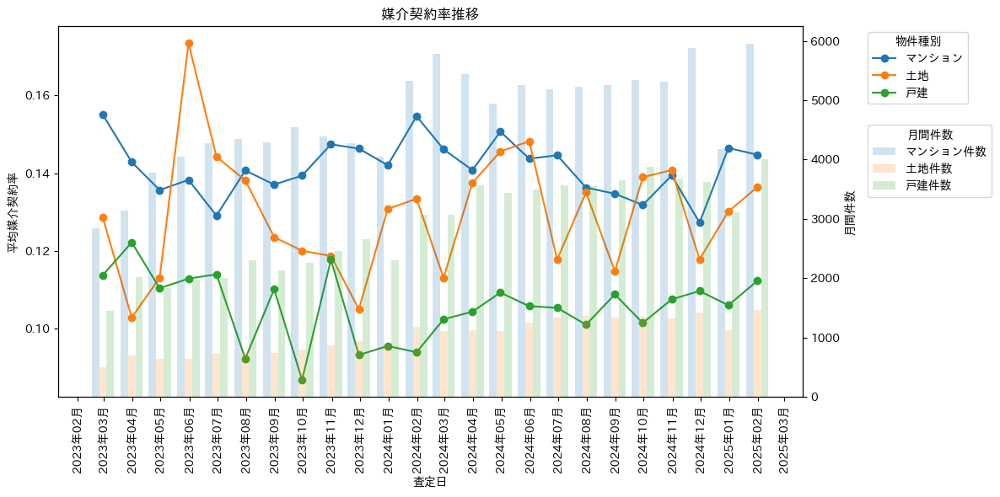

In [41]:
#月別の系列グラフ

df = df_all.copy()
df['ASSESSED_ON'] = pd.to_datetime(df['ASSESSED_ON'], errors='coerce')

# 月ごとに 成約フラグ の平均（=ベース率）を集計、物件種別で並べる
monthly = (df
    .set_index('ASSESSED_ON')
    .groupby('PROPERTY_KIND')
    .resample('M')['成約フラグ']
    .mean()
    .reset_index())

# ピボットして "列=系列（各PROPERTY_KIND） / 行=月"
pv = monthly.pivot(index='ASSESSED_ON', columns='PROPERTY_KIND', values='成約フラグ')

# 物件種別の名前を変更
pv = pv.rename(columns={1.0: 'マンション', 2.0: '土地', 3.0: '戸建'})

fig, ax = plt.subplots(figsize=(12,6))
for col in pv.columns:
    ax.plot(pv.index, pv[col], label=col, marker='o')
ax.set_title('媒介契約率推移')
ax.set_xlabel('査定日')
ax.set_ylabel('平均媒介契約率')
ax.legend(title='物件種別')

# Add a second y-axis for counts
ax2 = ax.twinx()

# Get monthly counts
monthly_counts = (df
    .set_index('ASSESSED_ON')
    .groupby('PROPERTY_KIND')
    .resample('M')['成約フラグ']
    .count()
    .reset_index()
    .pivot(index='ASSESSED_ON', columns='PROPERTY_KIND', values='成約フラグ'))

# Rename columns for counts
monthly_counts = monthly_counts.rename(columns={1.0: 'マンション件数', 2.0: '土地件数', 3.0: '戸建件数'})

# Plot bars with alpha for transparency - grouped bars for better comparison
bar_width = 8  # Narrower bars to fit side by side
x = monthly_counts.index
for i, col in enumerate(monthly_counts.columns):
    ax2.bar(x + pd.Timedelta(days=i*bar_width - bar_width), 
            monthly_counts[col],
            width=bar_width, 
            alpha=0.2, 
            label=col, 
            align='center')
bar_width = 10  # Width in days

# Customize second y-axis
ax2.set_ylabel('月間件数')
ax2.legend(title='月間件数', loc='center right')

# Set grid to be behind both plots
ax.set_axisbelow(True)
# ax.grid(True, alpha=0.3)
for label in ax.get_xticklabels():
    label.set_rotation(90)
# x軸の日付表示を整形
# x軸の日付表示を整形
ax.xaxis.set_major_locator(mdates.MonthLocator())  # 毎月メモリを表示

# 凡例をグラフの外側（右上）に表示
ax.legend(title='物件種別', loc='upper left', bbox_to_anchor=(1.08, 1))
ax2.legend(title='月間件数', loc='upper left', bbox_to_anchor=(1.08, 0.75))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y年%m月'))  # 日本語形式で表示

# x軸のラベルを90度回転させて見やすく
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


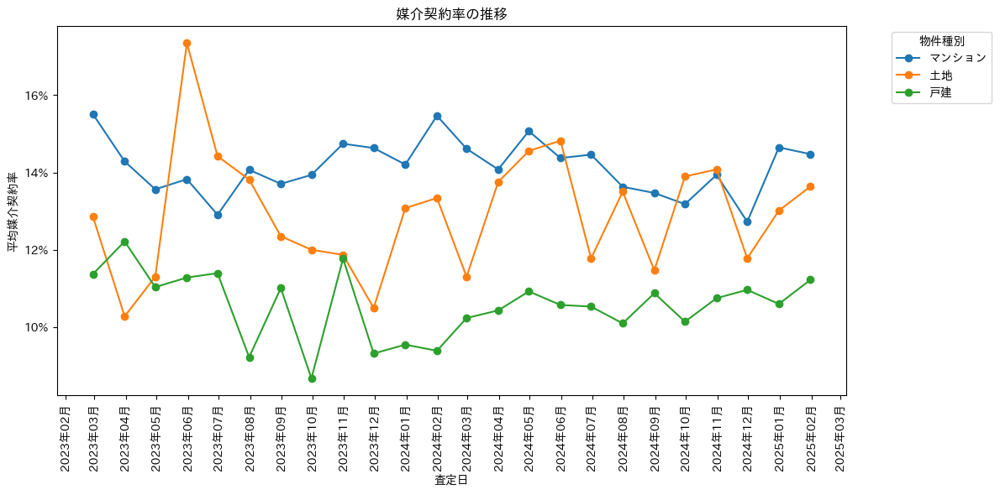

In [42]:
import matplotlib.ticker as mticker
# ここまでで pv（index=月, columns=物件種別, values=成約フラグ平均）ができている前提
# pv = pv.rename(columns={1.0: 'マンション', 2.0: '土地', 3.0: '戸建'})

fig, ax = plt.subplots(figsize=(12, 6))
for col in pv.columns:
    ax.plot(pv.index, pv[col], label=col, marker='o')

ax.set_title('媒介契約率の推移')
ax.set_xlabel('査定日')
ax.set_ylabel('平均媒介契約率')

# ← ここで％表記に
ax.yaxis.set_major_formatter(mticker.PercentFormatter(xmax=1.0, decimals=0))

ax.legend(title='物件種別', loc='upper left', bbox_to_anchor=(1.05, 1))
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y年%m月'))
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [43]:
# ％表示に変換
pv_percent = (pv * 100).round(1)

display(pv_percent)

PROPERTY_KIND,マンション,土地,戸建
ASSESSED_ON,,,
2023-02-28,15.5,12.9,11.4
2023-03-31,14.3,10.3,12.2
2023-04-30,13.6,11.3,11.0
2023-05-31,13.8,17.4,11.3
2023-06-30,12.9,14.4,11.4
2023-07-31,14.1,13.8,9.2
2023-08-31,13.7,12.3,11.0
2023-09-30,13.9,12.0,8.7
2023-10-31,14.7,11.9,11.8


/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3158565535.py:5: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  .resample('M')['成約フラグ']


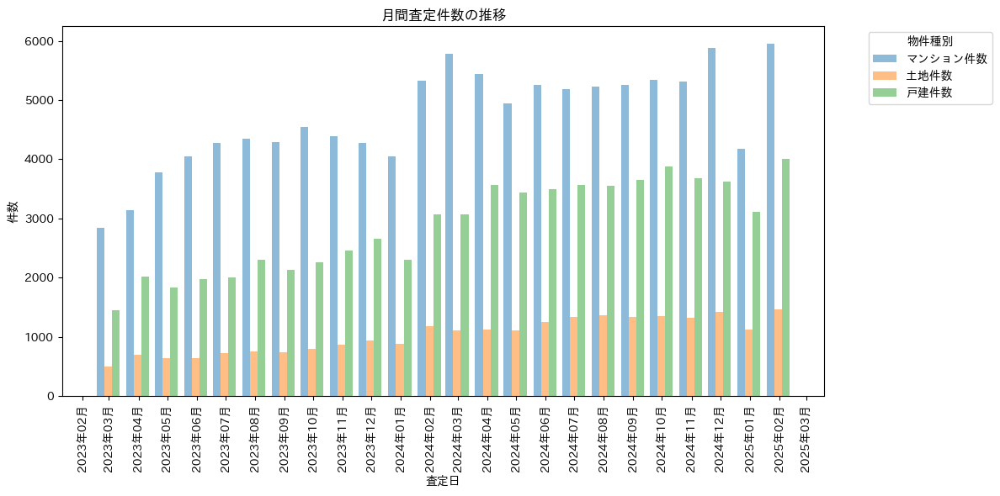

In [44]:
# 月ごとの件数集計
monthly_counts = (df
    .set_index('ASSESSED_ON')
    .groupby('PROPERTY_KIND')
    .resample('M')['成約フラグ']
    .count()
    .reset_index()
    .pivot(index='ASSESSED_ON', columns='PROPERTY_KIND', values='成約フラグ'))

monthly_counts = monthly_counts.rename(columns={1.0: 'マンション件数', 2.0: '土地件数', 3.0: '戸建件数'})

# 棒グラフの描画
fig, ax = plt.subplots(figsize=(12,6))
bar_width = 8  # 横にずらす幅（日単位）
x = monthly_counts.index

for i, col in enumerate(monthly_counts.columns):
    offset = pd.to_timedelta(i * bar_width - bar_width, unit='D')
    ax.bar(x + offset, monthly_counts[col], width=bar_width, alpha=0.5, label=col)

ax.set_title('月間査定件数の推移')
ax.set_xlabel('査定日')
ax.set_ylabel('件数')
ax.legend(title='物件種別', loc='upper left', bbox_to_anchor=(1.05, 1))

# x軸フォーマット調整
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y年%m月'))
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


### 考察（月ごとの媒介契約率・査定件数） ###


・媒介契約率は月毎にマンション・戸建てでは約２％、土地では約7％の差異がある   
・査定件数は月毎に増加傾向である   
・土地については6月に媒介契約率が増加傾向であるが、全体として変動に規則性は見られない   



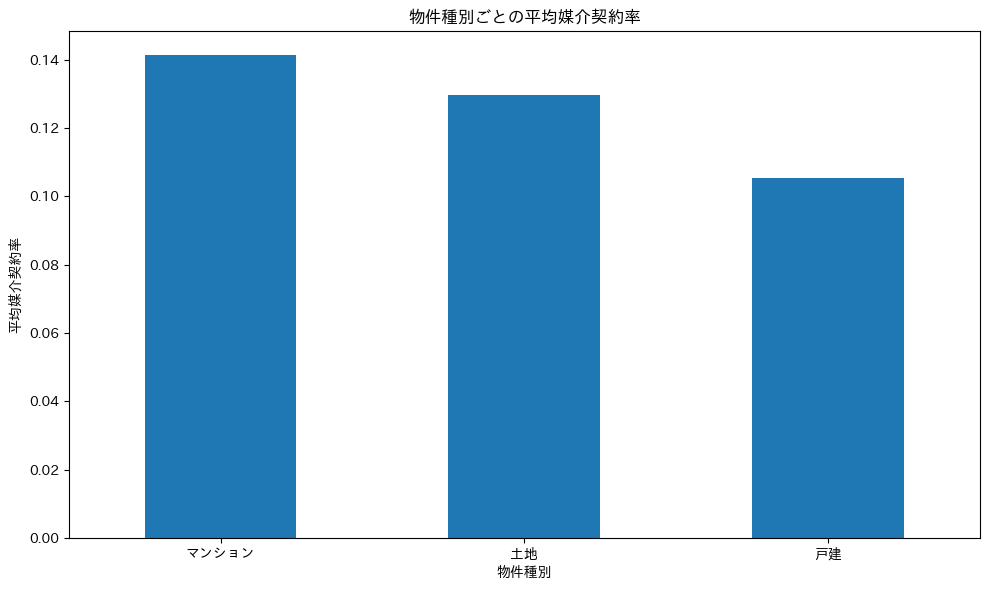

In [45]:
# Calculate mean 成約フラグ for each PROPERTY_KIND
property_means = df_all.groupby('PROPERTY_KIND')['成約フラグ'].mean()

# Rename the indices for better visualization
property_means.index = ['マンション', '土地', '戸建']

# Create bar plot
plt.figure(figsize=(10, 6))
property_means.plot(kind='bar')
plt.title('物件種別ごとの平均媒介契約率')
plt.xlabel('物件種別')
plt.ylabel('平均媒介契約率')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

# 物件種別で分類 #

In [46]:

df_m = df_all[df_all['PROPERTY_KIND'] == 1]
df_l = df_all[df_all['PROPERTY_KIND'] == 2]
df_h = df_all[df_all['PROPERTY_KIND'] == 3]

## マンション ##

### 前処理 ###

In [47]:
#　特に数値として扱うカラムについて、内容を確認
df_m[['ID','ABOUT_FLOOR','FLOOR_NUMBER','ABOUT_UNIT_AMOUNT','ASSESS_RENT_PRICE','ASSESS_SELL_PRICE','ASSESS_SELL_SQUARE_PRICE','ASSESS_SELL_TSUBO_PRICE','EXPENSE1_SELL_PRICE','EXPENSE1_COMMISSION_RATE',"ASSESS_SELL_SQUARE_PRICE","ASSESS_SELL_TSUBO_PRICE","ASSESS_SELL_TERM","ASSESS_PURCHASE_TERM","EXPENSE1_SELL_PRICE","EXPENSE1_COMMISSION_RATE"]].tail(30)

,ID,ABOUT_FLOOR,FLOOR_NUMBER,ABOUT_UNIT_AMOUNT,ASSESS_RENT_PRICE,ASSESS_SELL_PRICE,ASSESS_SELL_SQUARE_PRICE,ASSESS_SELL_TSUBO_PRICE,EXPENSE1_SELL_PRICE,EXPENSE1_COMMISSION_RATE,ASSESS_SELL_SQUARE_PRICE,ASSESS_SELL_TSUBO_PRICE,ASSESS_SELL_TERM,ASSESS_PURCHASE_TERM,EXPENSE1_SELL_PRICE,EXPENSE1_COMMISSION_RATE
206726,270694,8階,2.0,68戸,5.4,660,9,29,"6,600,000",3.0,9,29,NaN,1,"6,600,000",3.0
206728,270696,13階（地下1階）,10.0,106戸,19.8〜21.0,"4,680～4980",64,212,49800000,5.0,64,212,NaN,1週間,49800000,5.0
206729,270697,7階,1.0,20戸,11.0〜13.0,3410,82,270,34100000,5.0,82,270,3,1週間,34100000,5.0
206731,270699,14階,9.0,439戸,18.0〜22.0,5630,80,263,56300000,5.0,80,263,3,1週間,56300000,5.0
206734,270705,7階,4.0,51戸,NaN,1330,15,51,13300000,5.0,15,51,3,1週間,13300000,5.0
206735,270706,3階,2.0,99戸,29.0〜40.0,7700～8000,98,326,83700000,5.0,98,326,3,1週間,83700000,5.0
206737,270713,14階,3.0,90戸,18.0,5480～5680,61,202,54900000,5.0,61,202,3,1週間,54900000,5.0
206744,270720,9階,7.0,23戸,13.3〜16.7,3750,60,198,37500000,5.0,60,198,3,1週間,37500000,5.0
206745,270721,9階,7.0,23戸,13.3〜16.7,3750,60,198,37500000,5.0,60,198,3,1週間,37500000,5.0
206747,270724,13階（地下1階）,2.0,84戸,12.0〜13.0,2630,34,111,26300000,5.0,34,111,3,1週間,26300000,5.0


In [48]:
# 数字部分だけ抽出して float に変換
df_m['ABOUT_UNIT_AMOUNT_NUM'] = (
    df_m['ABOUT_UNIT_AMOUNT']
    .astype(str)
    .str.strip()
    .str.extract(r'(\d+)')[0]   # 正規表現で最初の数字だけ取り出し
    .astype(float)              # 数値型に変換（必要なら int にしてもOK）
)

# 確認
print(df_m[['ABOUT_UNIT_AMOUNT', 'ABOUT_UNIT_AMOUNT_NUM']].head())

   ABOUT_UNIT_AMOUNT  ABOUT_UNIT_AMOUNT_NUM
0                77戸                   77.0
1                92戸                   92.0
14              143戸                  143.0
15              168戸                  168.0
16               38戸                   38.0


/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/684749914.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_m['ABOUT_UNIT_AMOUNT_NUM'] = (


In [49]:
# もともと欠損していないのに、抽出後はNaNになったものを抽出
mask = df_m['ABOUT_UNIT_AMOUNT'].notna() & df_m['ABOUT_UNIT_AMOUNT_NUM'].isna()
problematic_rows = df_m.loc[mask, 'ABOUT_UNIT_AMOUNT']

print("=== ABOUT_UNIT_AMOUNT では値あり、ABOUT_UNIT_AMOUNT_NUM で NaN になった例 ===")
print(problematic_rows.unique()[:50])  # 例として最大50種類だけ表示


=== ABOUT_UNIT_AMOUNT では値あり、ABOUT_UNIT_AMOUNT_NUM で NaN になった例 ===
['-' '戸' '―' 'ー']


In [50]:

def extract_floor_number(s):
    if pd.isna(s):
        return np.nan
    text = str(s).strip()

    # 1) 「〇階」を含む場合
    m = re.search(r'(\d+)\s*階', text)
    if m:
        return int(m.group(1))

    # 2) 数字だけが入っている場合（例: "8", "50"）
    if re.fullmatch(r'\d+', text):
        return int(text)

    # 3) それ以外は NaN
    return np.nan

# 適用
df_m['ABOUT_FLOOR_NUM'] = df_m['ABOUT_FLOOR'].apply(extract_floor_number)

# 確認
print(df_m[['ABOUT_FLOOR', 'ABOUT_FLOOR_NUM']].head(20))


   ABOUT_FLOOR  ABOUT_FLOOR_NUM
0           5階              5.0
1    15階（地下1階）             15.0
14         15階             15.0
15         22階             22.0
16          8階              8.0
19         10階             10.0
21          8階              8.0
22         10階             10.0
23    7階（地下1階）              7.0
24   11階（地下1階）             11.0
26          8階              8.0
31         11階             11.0
33         14階             14.0
36          8階              8.0
37          8階              8.0
38          8階              8.0
40    7階（地下1階）              7.0
42    7階（地下1階）              7.0
45    9階（地下1階）              9.0
46          2階              2.0


/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/1937556364.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_m['ABOUT_FLOOR_NUM'] = df_m['ABOUT_FLOOR'].apply(extract_floor_number)


In [51]:
# もともと欠損していないのに、抽出後はNaNになったものを抽出
mask = df_m['ABOUT_FLOOR'].notna() & df_m['ABOUT_FLOOR_NUM'].isna()
problematic_rows = df_m.loc[mask, 'ABOUT_FLOOR']

print("=== ABOUT_FLOOR では値あり、ABOUT_FLOOR_NUM で NaN になった例 ===")
print(problematic_rows.unique()[:50])  # 例として最大50種類だけ表示

=== ABOUT_FLOOR では値あり、ABOUT_FLOOR_NUM で NaN になった例 ===
['-階' 'ー']


In [52]:
import re
import numpy as np
import pandas as pd
import unicodedata

# --- ダミー値（---, ＿＿, ー 等）検出用
PLACEHOLDER_PAT = re.compile(r'^[-_ー―＿\s]+$')

def normalize_text(x: str) -> str:
    t = unicodedata.normalize("NFKC", str(x))
    # 括弧内削除（全角/半角）
    t = re.sub(r'[\(\（].*?[\)\）]', '', t)
    # カンマ除去 & 前後空白
    t = t.replace(',', '').strip()
    # よくある語句
    t = re.sub(r'(約|前後)', '', t)
    # 単位除去（必要に応じて増やせる）
    t = re.sub(r'(円|万円|万|千円|百万円|ヶ月|ケ月|か月|月|週間|週|日)', '', t)
    # 区切りゆらぎを ~ に正規化
    t = re.sub(r'[~\-–—〜～]', '~', t)
    # 重複ドットを1つに
    t = re.sub(r'\.{2,}', '.', t)
    # 連続 ~ を1つに
    t = re.sub(r'~{2,}', '~', t)
    return t.strip()

def to_avg_number_series(s: pd.Series) -> pd.Series:
    """文字列正規化 → 範囲は平均、単数はそのまま。抽出不能/ダミーは NaN"""
    if s is None:
        return pd.Series(dtype='float64')

    # 文字正規化（常に文字列に）
    t = s.astype(str).map(normalize_text)

    # === ここを安全に（bool化してから where） ===
    # 空文字 → NaN
    empty_cond = (t.str.len() == 0)
    t = t.where(~empty_cond, other=np.nan)

    # ダミー（---, ＿＿ 等） → NaN
    dummy_cond = t.str.match(PLACEHOLDER_PAT).fillna(False)
    t = t.where(~dummy_cond, other=np.nan)

    num_pat = re.compile(r'(\d+(?:\.\d+)?)')

    def parse_one(txt):
        if pd.isna(txt):
            return np.nan
        # 含まれる数値を全部拾う
        nums = [float(m) for m in num_pat.findall(txt)]
        if len(nums) >= 2 and '~' in str(txt):
            # 範囲 → 両端の平均
            return float((nums[0] + nums[-1]) / 2.0)
        if len(nums) >= 1:
            return float(nums[0])
        return np.nan

    return t.map(parse_one).astype('float64')


In [53]:
# 適用（SettingWithCopyWarning を避けるため loc を使う）
df_m.loc[:, 'ASSESS_RENT_PRICE_NUM']        = to_avg_number_series(df_m['ASSESS_RENT_PRICE'])
df_m.loc[:, 'ASSESS_SELL_PRICE_NUM']        = to_avg_number_series(df_m['ASSESS_SELL_PRICE'])
df_m.loc[:, 'ASSESS_SELL_SQUARE_PRICE_NUM'] = to_avg_number_series(df_m['ASSESS_SELL_SQUARE_PRICE'])
df_m.loc[:, 'ASSESS_SELL_TSUBO_PRICE_NUM']  = to_avg_number_series(df_m['ASSESS_SELL_TSUBO_PRICE'])
df_m.loc[:, 'ASSESS_SELL_TERM_NUM']         = to_avg_number_series(df_m['ASSESS_SELL_TERM'])
df_m.loc[:, 'ASSESS_PURCHASE_TERM_NUM']     = to_avg_number_series(df_m['ASSESS_PURCHASE_TERM'])
df_m.loc[:, 'EXPENSE1_SELL_PRICE_NUM']      = to_avg_number_series(df_m['EXPENSE1_SELL_PRICE'])


/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/522536101.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_m.loc[:, 'ASSESS_RENT_PRICE_NUM']        = to_avg_number_series(df_m['ASSESS_RENT_PRICE'])
/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/411437284.py:41: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  dummy_cond = t.str.match(PLACEHOLDER_PAT).fillna(False)
/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/522536101.py:3: SettingWithCopyWarning: 
A value is trying to be s

In [54]:
#元カラムではNaNではなかったのに、数値化後カラムではNaNになってしまったものを確認

# 対象の「元カラム → 数値化後カラム」ペアを定義
pairs = [
    ('ASSESS_RENT_PRICE',        'ASSESS_RENT_PRICE_NUM'),
    ('ASSESS_SELL_PRICE',        'ASSESS_SELL_PRICE_NUM'),
    ('ASSESS_SELL_SQUARE_PRICE', 'ASSESS_SELL_SQUARE_PRICE_NUM'),
    ('ASSESS_SELL_TSUBO_PRICE',  'ASSESS_SELL_TSUBO_PRICE_NUM'),
    ('ASSESS_SELL_TERM',         'ASSESS_SELL_TERM_NUM'),
    ('ASSESS_PURCHASE_TERM',     'ASSESS_PURCHASE_TERM_NUM'),
    ('EXPENSE1_SELL_PRICE',      'EXPENSE1_SELL_PRICE_NUM'),
]

# 1) 件数サマリ
rows = []
for src, num in pairs:
    mask = df_m[src].notna() & df_m[num].isna()
    rows.append({
        'src_col': src,
        'num_col': num,
        'n_problem': int(mask.sum()),
        'n_unique_problem_values': int(df_m.loc[mask, src].nunique(dropna=True))
    })
summary_parse_fail = pd.DataFrame(rows).sort_values('n_problem', ascending=False).reset_index(drop=True)
print("=== 変換失敗（元値あり→数値NaN） 件数サマリ ===")
print(summary_parse_fail)

# 2) 各列の「問題となった元値」を上位例で確認（value_counts 上位20）
for src, num in pairs:
    mask = df_m[src].notna() & df_m[num].isna()
    if mask.any():
        print(f"\n=== {src} → {num} 変換失敗: {mask.sum()}件 ===")
        # 問題となった値の上位20種を表示（頻度順）
        print(df_m.loc[mask, src].astype(str).value_counts().head(20))


=== 変換失敗（元値あり→数値NaN） 件数サマリ ===
                    src_col                       num_col  n_problem  \
0          ASSESS_SELL_TERM          ASSESS_SELL_TERM_NUM       1292   
1   ASSESS_SELL_TSUBO_PRICE   ASSESS_SELL_TSUBO_PRICE_NUM        175   
2  ASSESS_SELL_SQUARE_PRICE  ASSESS_SELL_SQUARE_PRICE_NUM        149   
3         ASSESS_SELL_PRICE         ASSESS_SELL_PRICE_NUM         48   
4      ASSESS_PURCHASE_TERM      ASSESS_PURCHASE_TERM_NUM         32   
5         ASSESS_RENT_PRICE         ASSESS_RENT_PRICE_NUM          0   
6       EXPENSE1_SELL_PRICE       EXPENSE1_SELL_PRICE_NUM          0   

   n_unique_problem_values  
0                       14  
1                        1  
2                        1  
3                       28  
4                       12  
5                        0  
6                        0  

=== ASSESS_SELL_PRICE → ASSESS_SELL_PRICE_NUM 変換失敗: 48件 ===
ASSESS_SELL_PRICE
＿＿＿＿＿          8
＿＿＿＿           4
＿＿＿＿＿＿＿＿＿      4
-              4
_____        

### 外れ値処理 ###

In [55]:
# OWNER_SPACE_NUM（600㎡以上 → 外れ値）
cond = df_m["OWNER_SPACE_NUM"] >= 600
print(f"OWNER_SPACE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "OWNER_SPACE_NUM"] = np.nan

# READ_COUNT（100以上 → 異常値）
cond = df_m["READ_COUNT"] >= 100
print(f"READ_COUNTで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "READ_COUNT"] = np.nan

# ABOUT_FLOOR_NUM（70階以上 → 外れ値）
cond = df_m["ABOUT_FLOOR_NUM"] >= 70
print(f"ABOUT_FLOOR_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "ABOUT_FLOOR_NUM"] = np.nan

# FLOOR_NUMBER（70階以上 → 外れ値）
cond = df_m["FLOOR_NUMBER"] >= 70
print(f"FLOOR_NUMBERで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "FLOOR_NUMBER"] = np.nan

# BUILDING_AGE（80年超 → 外れ値）
cond = df_m["BUILDING_AGE"] >= 80
print(f"BUILDING_AGEで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "BUILDING_AGE"] = np.nan

# ABOUT_UNIT_AMOUNT_NUM（2800超 → 外れ値）
cond = df_m["ABOUT_UNIT_AMOUNT_NUM"] >= 2800
print(f"ABOUT_UNIT_AMOUNT_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "ABOUT_UNIT_AMOUNT_NUM"] = np.nan

# ASSESS_SELL_PRICE_NUM（2億超 → 外れ値）
cond = df_m["ASSESS_SELL_PRICE_NUM"] >= 200_000
print(f"ASSESS_SELL_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "ASSESS_SELL_PRICE_NUM"] = np.nan

# ASSESS_RENT_PRICE_NUM（2億超 → 外れ値）
cond = df_m["ASSESS_RENT_PRICE_NUM"] >= 200_000
print(f"ASSESS_RENT_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "ASSESS_RENT_PRICE_NUM"] = np.nan

# ASSESS_SELL_SQUARE_PRICE_NUM（1000万円/㎡超 → 外れ値）
cond = df_m["ASSESS_SELL_SQUARE_PRICE_NUM"] >= 1000
print(f"ASSESS_SELL_SQUARE_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "ASSESS_SELL_SQUARE_PRICE_NUM"] = np.nan

# ASSESS_SELL_TSUBO_PRICE_NUM（2000万円/坪超 → 外れ値）
cond = df_m["ASSESS_SELL_TSUBO_PRICE_NUM"] >= 2000
print(f"ASSESS_SELL_TSUBO_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "ASSESS_SELL_TSUBO_PRICE_NUM"] = np.nan

# ASSESS_SELL_TERM_NUM（30ヶ月超 → 外れ値）
cond = df_m["ASSESS_SELL_TERM_NUM"] >= 30
print(f"ASSESS_SELL_TERM_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "ASSESS_SELL_TERM_NUM"] = np.nan

# ASSESS_PURCHASE_TERM_NUM（30ヶ月超 → 外れ値）
cond = df_m["ASSESS_PURCHASE_TERM_NUM"] >= 30
print(f"ASSESS_PURCHASE_TERM_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "ASSESS_PURCHASE_TERM_NUM"] = np.nan

# EXPENSE1_SELL_PRICE_NUM（10億円超 → 外れ値）
cond = df_m["EXPENSE1_SELL_PRICE_NUM"] >= 1_000_000_000
print(f"EXPENSE1_SELL_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_m.loc[cond, "EXPENSE1_SELL_PRICE_NUM"] = np.nan


OWNER_SPACE_NUMで外れ値として除外された件数: 20件
READ_COUNTで外れ値として除外された件数: 1件
ABOUT_FLOOR_NUMで外れ値として除外された件数: 4件
FLOOR_NUMBERで外れ値として除外された件数: 2件
BUILDING_AGEで外れ値として除外された件数: 1件
ABOUT_UNIT_AMOUNT_NUMで外れ値として除外された件数: 17件
ASSESS_SELL_PRICE_NUMで外れ値として除外された件数: 18件
ASSESS_RENT_PRICE_NUMで外れ値として除外された件数: 3件
ASSESS_SELL_SQUARE_PRICE_NUMで外れ値として除外された件数: 12件
ASSESS_SELL_TSUBO_PRICE_NUMで外れ値として除外された件数: 21件
ASSESS_SELL_TERM_NUMで外れ値として除外された件数: 21件
ASSESS_PURCHASE_TERM_NUMで外れ値として除外された件数: 4件
EXPENSE1_SELL_PRICE_NUMで外れ値として除外された件数: 24件


In [56]:
print(df_m["ASSESS_SELL_SQUARE_PRICE_NUM"].value_counts())
# 最大値を表示
print(df_m["ASSESS_SELL_SQUARE_PRICE_NUM"].max())

# 上位15件の値を表示したい場合はこちら
print(df_m["ASSESS_SELL_SQUARE_PRICE_NUM"].nlargest(15))

ASSESS_SELL_SQUARE_PRICE_NUM
50.000     1602
53.000     1586
42.000     1580
48.000     1571
54.000     1568
52.000     1536
51.000     1535
45.000     1530
44.000     1523
41.000     1514
43.000     1512
46.000     1503
55.000     1475
47.000     1473
40.000     1468
56.000     1461
49.000     1456
57.000     1455
39.000     1429
58.000     1418
59.000     1408
38.000     1407
60.000     1394
33.000     1346
36.000     1342
61.000     1330
37.000     1300
34.000     1297
66.000     1296
35.000     1294
31.000     1276
62.000     1264
63.000     1259
64.000     1242
32.000     1226
65.000     1225
30.000     1196
29.000     1138
28.000     1128
70.000     1119
69.000     1108
67.000     1103
68.000     1082
71.000     1070
25.000     1068
27.000     1065
72.000     1037
26.000     1027
23.000     1009
73.000      974
24.000      961
22.000      959
75.000      948
74.000      940
20.000      940
76.000      926
21.000      889
77.000      851
78.000      845
79.000      840
82.000     

### 保存 ###

In [57]:
df_m.shape

(113031, 394)

In [58]:
df_m.to_csv(os.path.join(OUTPUT_DIR, "3.ASSESSMENT_REPORTS_WITH_FLG_EDA_mansion.csv"), index=False, encoding="utf-8-sig")

### 不要なカラムの削除 ###

In [59]:
#不要なカラムを削除
columns_to_drop = [
    'ID',
    'USER_ID',
    'USER_ID_3730_FLG',
    'IS_DEAL',
    'PROPERTY_KIND',
    'APARTMENT_ID',
    'FLOOR_NUMBER',
    'OWNER_SPACE',
    'LAND_SPACE',
    'BUILDING_SPACE',
    'LAND_AND_BUILDING_SPACE',
    'DIRECTION_DEG',
    'ASSESSED_ON',
    'CUSTOMER_NAME',
    'PROPERTY_NAME',
    'STAFF_NAME',
    'COMPANY_DESCRIPTION',
    'EMAIL',
    'TEL',
    'LINE_URL',
    'HOMEPAGE',
    'COVER_ASSESSED_ON',
    'COVER_TITLE',
    'TITLE_FONT_SIZE',
    'COVER_CUSTOMER_NAME',
    'COVER_STAFF_AND_COMPANY_NAME',
    'COVER_DESCRIPTION',
    'COVER_EMAIL',
    'COVER_TEL',
    'COVER_HOMEPAGE',
    'COVER_STAFF_ROUND_IMAGE',
    'COVER_STAFF_ROUND_IMAGE_COMMENT',
    'ABOUT_PROPERTY_NAME',
    'ABOUT_ADDRESS',
    'LATITUDE',
    'LONGITUDE',
    'C_ID',
    'ABOUT_TRAFFIC',
    'ABOUT_MANAGER',
    'ABOUT_LAND_PRIVILEGE',
    'ABOUT_REGISTRY_GROUND',
    'ABOUT_CITY_PLAN',
    'ABOUT_TERRAIN',
    'ABOUT_LAND_SHAPE',
    'ABOUT_SETBACK_SPACE',
    'ABOUT_CURRENT_STATE',
    'ABOUT_RECONSTRUCT_DISABLED',
    'ABOUT_USAGE_AREA',
    'ABOUT_STRUCTURE',
    'STRUCTURE_ID',
    'ABOUT_BUILT_IN',
    'ABOUT_FLOOR',
    'ABOUT_BUILDING_COVERAGE',
    'ABOUT_CONNECT_ROAD_STATE',
    'ABOUT_CONNECT_ROAD',
    'ABOUT_CAPACITY_RATIO',
    'ABOUT_BUILDING_COVERAGE_AND_CAPACITY_RATIO',
    'ABOUT_UNIT_AMOUNT',
    'ABOUT_SELLER',
    'ABOUT_CONSTRUCTOR',
    'ABOUT_REMARKS',
    'ASSESS_SELL_TITLE',
    'ASSESS_SELL_PRICE',
    'ASSESS_SELL_SQUARE_PRICE',
    'ASSESS_SELL_TSUBO_PRICE',
    'ASSESS_SELL_TERM',
    'ASSESS_SELL_PRICE_FROM',
    'ASSESS_SELL_PRICE_TO',
    'ASSESS_SELL_SELF_STORY_COUNT',
    'ASSESS_SELL_SIMILAR_STORY_COUNT',
    'ASSESS_SELL_BUILDING_PRICE',
    'ASSESS_SELL_BUILDING_UNIT_PRICE',
    'ASSESS_SELL_HOUSE_LAND_PRICE',
    'ASSESS_SELL_COMMENT',
    'ASSESS_HOUSE_COMMENT',
    'ASSESS_SELL_PAGE_BREAK',
    'INDICATE_VISIT_ASSESSMENT',
    'VISIT_ASSESSMENT_PRICE',
    'VISIT_ASSESSMENT_COMMENT',
    'VISIT_ASSESSMENT_MEMO',
    'VISIT_ASSESSMENT_TITLE',
    'ASSESS_SUGGEST_PRICE',
    'ASSESS_SUGGEST_COMMENT',
    'ASSESS_SUGGEST_PAGE_BREAK',
    'CHALLENGE1_TITLE',
    'CHALLENGE1_PRICE',
    'CHALLENGE1_TSUBO_PRICE',
    'CHALLENGE1_TERM',
    'CHALLENGE1_COMMENT',
    'CHALLENGE1_PAGE_BREAK',
    'CHALLENGE2_TITLE',
    'CHALLENGE2_PRICE',
    'CHALLENGE2_TSUBO_PRICE',
    'CHALLENGE2_TERM',
    'CHALLENGE2_COMMENT',
    'CHALLENGE2_PAGE_BREAK',
    'CHALLENGE3_TITLE',
    'CHALLENGE3_PRICE',
    'CHALLENGE3_TSUBO_PRICE',
    'CHALLENGE3_TERM',
    'CHALLENGE3_COMMENT',
    'CHALLENGE3_PAGE_BREAK',
    'ASSESS_PURCHASE_PRICE',
    'ASSESS_PURCHASE_TERM',
    'ASSESS_PURCHASE_COMMENT',
    'ASSESS_PURCHASE_PAGE_BREAK',
    'ASSESS_RENT_TITLE',
    'ASSESS_RENT_PRICE',
    'ASSESS_RENT_YIELD',
    'ASSESS_RENT_COMMENT',
    'ASSESS_RENT_PAGE_BREAK',
    'INDICATE_DEMOLITION_COST',
    'DEMOLITION_P_NAME',
    'DEMOLITION_ABOUT_STRUCTURE',
    'DEMOLITION_BUILDING_SPACE_TSUBO',
    'DEMOLITION_ROAD_WIDTH',
    'DEMOLITION_HOUSE_DISTANCE',
    'DEMOLITION_COST',
    'DEMOLITION_MIN_COST',
    'DEMOLITION_MAX_COST',
    'COVER_STATISTICS_TITLE',
    'COVER_MARKET_TITLE',
    'ASSESS_VISIT_PAGE_BREAK',
    'ASSESS_STAFF_COMMENT',
    'ASSESS_STAFF_PAGE_BREAK',
    'AREA_HUMAN_COMMENT',
    'SELL_FLOW1_TITLE',
    'SELL_FLOW1_DETAIL',
    'SELL_FLOW2_TITLE',
    'SELL_FLOW2_DETAIL',
    'SELL_FLOW3_TITLE',
    'SELL_FLOW3_DETAIL',
    'SELL_FLOW4_TITLE',
    'SELL_FLOW4_DETAIL',
    'SELL_FLOW5_TITLE',
    'SELL_FLOW5_DETAIL',
    'SELL_FLOW6_TITLE',
    'SELL_FLOW6_DETAIL',
    'SELL_FLOW7_TITLE',
    'SELL_FLOW7_DETAIL',
    'LAST_COMMENT',
    'LAST_STAFF_IMAGE',
    'LAST_STAFF_NAME',
    'LAST_TEL',
    'LAST_EMAIL',
    'LAST_PROFILE',
    'INDICATE_COVER_ASSESSED_ON',
    'INDICATE_COVER_LOGO',
    'INDICATE_COVER_CUSTOMER_NAME',
    'INDICATE_COVER_ABOUT',
    'INDICATE_COVER_STAFF_AND_COMPANY_NAME',
    'INDICATE_COVER_DESCRIPTION',
    'INDICATE_COVER_EMAIL',
    'INDICATE_COVER_TEL',
    'INDICATE_COVER_HOMEPAGE',
    'INDICATE_COVER_STAFF_ROUND_IMAGE',
    'INDICATE_STAFF_ROUND_IMAGE',
    'INDICATE_COVER_STAFF_ROUND_IMAGE_COMMENT',
    'INDICATE_ABOUT_INFO',
    'INDICATE_ABOUT_EXCLUSIVE_INFO',
    'INDICATE_ABOUT_MAP',
    'INDICATE_ASSESS_VALUE',
    'INDICATE_ASSESS_SELL',
    'INDICATE_ASSESS_SELL_RANGE',
    'INDICATE_ASSESS_SELL_COUNT',
    'INDICATE_ASSESS_TK_BREAKDOWN',
    'INDICATE_ASSESS_SUGGEST',
    'INDICATE_ASSESS_PURCHASE',
    'INDICATE_ASSESS_RENT',
    'INDICATE_ASSESS_PROPERTY_INFO',
    'INDICATE_ASSESS_VISIT',
    'INDICATE_ASSESS_STAFF_COMMENT',
    'INDICATE_SELL_STORY_SELF',
    'INDICATE_SELL_STORY_SIMILAR',
    'INDICATE_RENT_STORY_SELF',
    'INDICATE_RENT_STORY_SIMILAR',
    'INDICATE_MARKET_LAYOUT_PRICE',
    'INDICATE_MARKET_TK_SPACE_PRICE',
    'INDICATE_MARKET_OLD_PRICE',
    'INDICATE_TEN_YEARS_FIXED_INTEREST_COMMENT',
    'INDICATE_ALL_YEARS_FIXED_INTEREST_COMMENT',
    'FLOATING_INTEREST_COMMENT',
    'TEN_YEARS_FIXED_INTEREST_COMMENT',
    'ALL_YEARS_FIXED_INTEREST_COMMENT',
    'INDICATE_EXPENSE',
    'INDICATE_EXPENSE1',
    'IS_EXPENSE1_REGULAR',
    'EXPENSE1_SELL_PRICE',
    'EXPENSE1_COMMISSION',
    'EXPENSE1_STAMP',
    'EXPENSE1_REGISTRATION',
    'EXPENSE1_RESIDUAL',
    'EXPENSE1_DEMOLITION_COST_INDICATE',
    'EXPENSE1_OTHER1_LABEL',
    'EXPENSE1_OTHER1',
    'EXPENSE1_OTHER2_LABEL',
    'EXPENSE1_OTHER2',
    'EXPENSE1_OTHER3_LABEL',
    'EXPENSE1_OTHER3',
    'EXPENSE1_COMMENT',
    'EXPENSE1_TITLE',
    'INDICATE_EXPENSE2',
    'IS_EXPENSE2_REGULAR',
    'EXPENSE2_SELL_PRICE',
    'EXPENSE2_COMMISSION',
    'EXPENSE2_COMMISSION_RATE',
    'EXPENSE2_STAMP',
    'EXPENSE2_REGISTRATION',
    'EXPENSE2_RESIDUAL',
    'EXPENSE2_DEMOLITION_COST_INDICATE',
    'EXPENSE2_OTHER1_LABEL',
    'EXPENSE2_OTHER1',
    'EXPENSE2_OTHER2_LABEL',
    'EXPENSE2_OTHER2',
    'EXPENSE2_OTHER3_LABEL',
    'EXPENSE2_OTHER3',
    'EXPENSE2_COMMENT',
    'EXPENSE2_TITLE',
    'INDICATE_EXPENSE3',
    'IS_EXPENSE3_REGULAR',
    'EXPENSE3_SELL_PRICE',
    'EXPENSE3_COMMISSION',
    'EXPENSE3_COMMISSION_RATE',
    'EXPENSE3_STAMP',
    'EXPENSE3_REGISTRATION',
    'EXPENSE3_RESIDUAL',
    'EXPENSE3_DEMOLITION_COST_INDICATE',
    'EXPENSE3_OTHER1_LABEL',
    'EXPENSE3_OTHER1',
    'EXPENSE3_OTHER2_LABEL',
    'EXPENSE3_OTHER2',
    'EXPENSE3_OTHER3_LABEL',
    'EXPENSE3_OTHER3',
    'EXPENSE3_COMMENT',
    'EXPENSE3_TITLE',
    'INDICATE_SELL_FLOW',
    'INDICATE_SELL_FLOW1',
    'INDICATE_SELL_FLOW2',
    'INDICATE_SELL_FLOW3',
    'INDICATE_SELL_FLOW4',
    'INDICATE_SELL_FLOW5',
    'INDICATE_SELL_FLOW6',
    'INDICATE_SELL_FLOW7',
    'INDICATE_CHALLENGE1',
    'INDICATE_CHALLENGE2',
    'INDICATE_CHALLENGE3',
    'INDICATE_LAST_COMMENT',
    'PAGE_BREAK_SELL_FLOW_AFTER4',
    'PAGE_BREAK_SELL_FLOW_AFTER5',
    'PAGE_BREAK_SELL_FLOW_AFTER6',
    'PAGE_BREAK_BEFORE_LAST_COMMENT',
    'CSS_DESIGN',
    'CSS_COLOR',
    'SP_DESIGN',
    'INDICATE_COVER_INFO',
    'INDICATE_ASSESS_INFO',
    'INDICATE_STORIES_INFO',
    'INDICATE_STATISTICS_INFO',
    'INDICATE_MARKET_INFO',
    'INDICATE_SELL_FLOW_INFO',
    'INDICATE_INSERT_PAGE_TITLE_COVER',
    'INDICATE_INSERT_PAGE_TITLE_ABOUT',
    'INDICATE_INSERT_PAGE_TITLE_ASSESS',
    'INDICATE_INSERT_PAGE_TITLE_STORIES',
    'INDICATE_INSERT_PAGE_TITLE_STATISTICS',
    'INDICATE_INSERT_PAGE_TITLE_MARKET',
    'INDICATE_INSERT_PAGE_TITLE_SELL_FLOW',
    'INDICATE_INSERT_PAGE_TITLE_EXPENSE',
    'INDICATE_PAGE_NUM',
    'COMPANY_SUMMARY',
    'ABOUT_LAND_SPACE',
    'ABOUT_BUILDING_SPACE',
    'ABOUT_BUILDING_COVERAGE_UNIT',
    'ABOUT_CAPACITY_RATIO_UNIT',
    'COVER_COMPANY_TEL',
    'INDICATE_COVER_COMPANY_TEL',
    'PDF',
    'COVER_PDF_TITLE',
    'ABOUT_PDF_TITLE',
    'ASSESS_PDF_TITLE',
    'STORIES_PDF_TITLE',
    'STATISTICS_PDF_TITLE',
    'MARKET_PDF_TITLE',
    'SELL_FLOW_PDF_TITLE',
    'EXPENSE_PDF_TITLE',
    'SECTION_ORDER',
    'FONT',
    'SP_READ_AT',
    'SP_TOKEN',
    'UPDATED_AT',
    'IS_DELETED',
    'join_inquiry',
    'ASSESSMENT_REPORT_ID',
    'FIRST_READ_AT',
    'LAST_READ_AT',
    'PREVIOUS_LAST_READ_AT',
    'LAST_FIRST_TIME',
    'LAST_PREVIOS_TIME',
    'IS_SEND_FIRST_SP_OPEN',
    'IS_SEND_SP_REOPEN',
    'CREATED_AT',
    'UPDATED_AT_read',
    'join_read',
    'USER_ID_txt',
    'ASSESSMENT_REPORT_ID_txt',
    'CONTENT',
    'CREATED_AT_txt',
    'UPDATED_AT_txt',
    'join_text',
    'USER_ID_inq',
    'ASSESSMENT_REPORT_ID_inq',
    'FP_UPDATED_AT',
    'FP_NOTIFY_READ_AT',
    'DELIVERY_SCHEDULE_FPS',
    'IS_FP_DELIVERY',
    'THX_UPDATED_AT',
    'TEL_DATE',
    'TEL_TIME_ZONE_0',
    'TEL_TIME_ZONE_1',
    'TEL_TIME_ZONE_2',
    'TEL_TIME_ZONE_3',
    'TEL_TIME_ZONE_4',
    'TEL_TIME_ZONE_5',
    'CUSTOMER_PHONE_NUMBER',
    'TEL_UPDATED_AT',
    'MEETING_DATETIME_0',
    'MEETING_DATETIME_1',
    'MEETING_DATETIME_2',
    'ONLINE_DESIRED',
    'MTG_UPDATED_AT',
    'CREATED_AT_inq',
    'UPDATED_AT_inq',
]
df_m= df_m.drop(columns=columns_to_drop)

In [60]:
print(df_m.columns.to_list())
print(df_m.shape)

['PRICE_DETAIL_COUNT', 'MEDIATION_BUY_COUNT', 'MARKET_CONDITION_COUNT', 'CONSULTATION_MOVE_COUNT', 'TAX_ADVICE_COUNT', 'SELLING_EXPENSE_COUNT', 'THANKS_COUNT', 'THX_NOTIFY_READ_AT_COUNT', 'TEL_NOTIFY_READ_AT_COUNT', 'MTG_NOTIFY_READ_AT_COUNT', 'HOPE_TEL_FLG_COUNT', 'MEETING_FLG_COUNT', 'CONTENT_COUNT', 'TXT_NOTIFY_READ_AT', 'DIRECTION', 'INDICATE_COVER_STATISTICS', 'INDICATE_MARKET_REPORTS', 'INDICATE_PRICE_HISTORY', 'INDICATE_PRICE_HISTORY_GRAPH', 'INDICATE_PRICE_HISTORY_SELF_COMPARE', 'INDICATE_PRICE_HISTORY_AREA_COMPARE', 'INDICATE_AREA_HUMAN', 'INDICATE_AREA_HUMAN_AGE_GRAPH', 'INDICATE_AREA_HUMAN_TRANSITION_GRAPH', 'INDICATE_COVER_MARKET', 'INDICATE_MARKET_SIZE', 'INDICATE_MARKET_SELL_TERM', 'INDICATE_MORTGAGE_INTEREST', 'INDICATE_FLOATING_INTEREST_COMMENT', 'INDICATE_MEDIATION_CONTRACT', 'EXPENSE1_COMMISSION_RATE', 'TUTORIAL_SP', 'OWNER_SPACE_NUM', 'READ_COUNT', 'READ_FLG', 'RENT_PRICE_FLG', 'VISIT_ASSESSMENT_FLG', 'INTEREST_COMMENT_FLG', '成約フラグ', 'BUILDING_AGE', 'BUILDING_AGE_BIN

### 相関係数の出力 ###

In [61]:
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2, p, dof, expected = chi2_contingency(confusion_matrix)
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    # bias correction
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))  
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

In [62]:
# ===== 1) 相関の準備（数値化→定数列除外） =====
ycol = '成約フラグ'
num = df_m.apply(pd.to_numeric, errors='coerce')              # 文字数値も強制数値化
const = num.columns[num.nunique(dropna=True) <= 1]  
# 3) 特定の列（カテゴリ変数など）を除外
exclude_cols = ['ID', 'DIRECTION']
num2 = num.drop(columns=exclude_cols, errors='ignore')
          # 分散0（定数）列
base = (num2.drop(columns=const, errors='ignore')
          .corrwith(num[ycol], method='pearson')    
          .drop(labels=[ycol], errors='ignore')
          .dropna())

In [63]:
base

PRICE_DETAIL_COUNT                     -0.002058
MEDIATION_BUY_COUNT                    -0.002696
MARKET_CONDITION_COUNT                 -0.007861
CONSULTATION_MOVE_COUNT                -0.002047
TAX_ADVICE_COUNT                       -0.005226
SELLING_EXPENSE_COUNT                   0.005308
TEL_NOTIFY_READ_AT_COUNT               -0.004075
MTG_NOTIFY_READ_AT_COUNT                0.001539
HOPE_TEL_FLG_COUNT                     -0.002569
MEETING_FLG_COUNT                      -0.001851
CONTENT_COUNT                           0.000597
TXT_NOTIFY_READ_AT                      0.001449
INDICATE_COVER_STATISTICS               0.003379
INDICATE_MARKET_REPORTS                 0.013794
INDICATE_PRICE_HISTORY                 -0.004832
INDICATE_PRICE_HISTORY_GRAPH           -0.005436
INDICATE_PRICE_HISTORY_SELF_COMPARE    -0.002343
INDICATE_PRICE_HISTORY_AREA_COMPARE    -0.001894
INDICATE_AREA_HUMAN                    -0.010519
INDICATE_AREA_HUMAN_AGE_GRAPH          -0.002095
INDICATE_AREA_HUMAN_

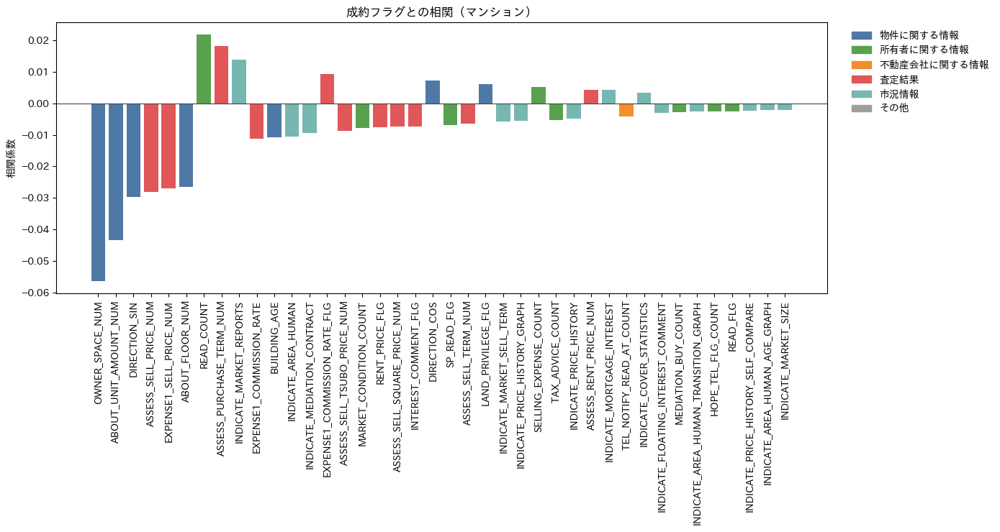

In [64]:


# ===== 2) カテゴリ定義（必要に応じて追記） =====
C_PROP   = '物件に関する情報'
C_OWNER  = '所有者に関する情報'
C_AGENT  = '不動産会社に関する情報'
C_RESULT = '査定結果'
C_MARKET = '市況情報'
C_OTHER  = 'その他'

# 画像の表に合わせて“明示的に”割り当てたい列をここで指定
EXPLICIT = {
    # 物件
    'OWNER_SPACE_NUM': C_PROP, 'FLOOR_NUMBER_NUM': C_PROP, 'BUILDING_AGE': C_PROP,
    'DIRECTION': C_PROP,'PROPERTY_KIND': C_PROP,'ABOUT_ADDRESS': C_PROP,
    'ABOUT_TRAFFIC': C_PROP, 'ABOUT_LAND_PRIVILEGE': C_PROP,
    'ABOUT_USAGE_AREA': C_PROP, 'ABOUT_STRUCTURE': C_PROP, 'BUILDING_AGE': C_PROP,
    'ABOUT_FLOOR': C_PROP, 'ABOUT_UNIT_AMOUNT_NUM': C_PROP,
    'ABOUT_SELLER': C_PROP,'LAND_PRIVILEGE_FLG': C_PROP,'BUILDING_AGE_BIN': C_PROP,
    
    # 査定結果
    'ASSESSED_ON': C_RESULT,'ASSESS_SELL_PRICE_NUM': C_RESULT,
    'ASSESS_SELL_TSUBO_PRICE_NUM': C_RESULT, 'ASSESS_SELL_SQUARE_PRICE_NUM': C_RESULT,
    'ASSESS_SELL_TERM_NUM': C_RESULT, 'ASSESS_PURCHASE_TERM_NUM': C_RESULT,
    'RENT_PRICE_FLG': C_RESULT, 'EXPENSE1_SELL_PRICE_NUM': C_RESULT,
    'EXPENSE1_COMMISSION_RATE': C_RESULT, 'INTEREST_COMMENT_FLG': C_RESULT,
    'VISIT_ASSESSMENT_FLG': C_RESULT,'EXPENSE1_COMMISSION_RATE_FLG': C_RESULT,
    # 市況
    'INDICATE_MARKET_REPORTS': C_MARKET, 'INDICATE_COVER_STATISTICS': C_MARKET,
    'INDICATE_PRICE_HISTORY': C_MARKET, 'INDICATE_PRICE_HISTORY_GRAPH': C_MARKET,
    'INDICATE_PRICE_HISTORY_SELF_COMPARE': C_MARKET, 'INDICATE_PRICE_HISTORY_AREA_COMPARE': C_MARKET,
    'INDICATE_AREA_HUMAN': C_MARKET, 'INDICATE_AREA_HUMAN_GRAPH': C_MARKET,
    'INDICATE_AREA_HUMAN_TRANSITION_GRAPH': C_MARKET, 'INDICATE_COVER_MARKET': C_MARKET,
    'INDICATE_MARKET_SIZE': C_MARKET, 'INDICATE_MARKET_SELL_TERM': C_MARKET,
    'INDICATE_MORTGAGE_INTEREST': C_MARKET, 'INDICATE_FLOATING_INTEREST_COMMENT': C_MARKET,
    'INDICATE_MEDIATION_CONTRACT': C_MARKET,
    # 不動産会社（接客/通知ログ系）
    'USER_ID': C_AGENT, 'THX_NOTIFY_READ_AT_COUNT': C_AGENT,'COVER_STAFF_AND_COMPANY_NAME': C_AGENT,
    'TXT_NOTIFY_READ_AT': C_AGENT, 'MTG_NOTIFY_READ_AT_COUNT': C_AGENT,
    'TEL_NOTIFY_READ_AT_COUNT': C_AGENT,'USER_ID_3730_FLG': C_AGENT,
    # 所有者（必要なら追加）
    'SELLING_EXPENSE_COUNT': C_OWNER,'READ_FLG': C_OWNER,
    'MEDIATION_BUY_COUNT': C_OWNER, 'MARKET_CONDITION_COUNT': C_OWNER,
    'PRICE_DETAIL_COUNT': C_OWNER,'CONSULTATION_MOVE_COUNT': C_OWNER,
    'TUTORIAL_SP': C_OWNER,'READ_COUNT': C_OWNER, 'CONTENT_COUNT': C_OWNER, 
    'MEETING_FLG_COUNT': C_OWNER,'TAX_ADVICE_COUNT': C_OWNER,
    'HOPE_TEL_FLG_COUNT': C_OWNER,'THANKS_COUNT': C_OWNER,'CONTENT_COUNT_FLG': C_OWNER,'SP_READ_FLG': C_OWNER,
    # 迷うもの・未定義はその他に落とす
}

# ルール（接頭辞・含有語）での自動振り分け
def infer_category(col: str) -> str:
    if col in EXPLICIT: 
        return EXPLICIT[col]
    c = col.lower()
    if c.startswith('about_') or any(k in c for k in ['owner_space', 'floor_number', 'building_age', 'direction', 'land_space', 'building_space']):
        return C_PROP
    if c.startswith('assess') or c.startswith('expense'):
        return C_RESULT
    if c.startswith('indicate') or 'market' in c or 'price_history' in c:
        return C_MARKET
    if any(k in c for k in ['read', 'notify', 'content', 'meeting', 'consultation', 'advice', 'hope_tel', 'visit_assessment']):
        return C_AGENT
    if 'seller' in c or 'owner' in c:
        return C_OWNER
    return C_OTHER

# ===== 3) 可視化（色分けバー） =====
PALETTE = {
    C_PROP:   '#4E79A7',
    C_OWNER:  '#59A14F',
    C_AGENT:  '#F28E2B',
    C_RESULT: '#E15759',
    C_MARKET: '#76B7B2',
    C_OTHER:  '#9E9E9E'
}

def plot_corr_colored(corr_series: pd.Series, top_n=40, sort_abs=True, add_prefix=False):
    dfc = corr_series.rename('corr').to_frame()
    dfc['feature']  = dfc.index
    dfc['category'] = dfc['feature'].map(infer_category)
    if sort_abs:
        dfc = dfc.reindex(dfc['corr'].abs().sort_values(ascending=False).index)
    else:
        dfc = dfc.sort_values('corr', ascending=False)
    if top_n is not None:
        dfc = dfc.head(top_n)

    labels = (dfc['category'] + ':' + dfc['feature']) if add_prefix else dfc['feature']
    colors = dfc['category'].map(PALETTE)

    fig_h = max(3.0, 0.35 * len(dfc))
    plt.figure(figsize=(max(12, 0.35*len(dfc)), 7.5))
    plt.bar(range(len(dfc)), dfc['corr'].values, color=colors)
    plt.axhline(0, color='#444', linewidth=0.8)
    plt.xticks(range(len(dfc)), labels, rotation=90)
    plt.ylabel('相関係数')
    plt.title('成約フラグとの相関（マンション）')

    # 凡例
    handles = [Patch(color=PALETTE[k], label=k) for k in [C_PROP, C_OWNER, C_AGENT, C_RESULT, C_MARKET, C_OTHER]]
    plt.legend(handles=handles, bbox_to_anchor=(1.02, 1), loc='upper left', frameon=False)

    plt.tight_layout()
    plt.show()

# 実行
plot_corr_colored(base, top_n=40, sort_abs=True, add_prefix=False)


In [65]:
# 相関係数の絶対値でソート → TOP20を抽出
top20 = (base.reindex(base.abs().sort_values(ascending=False).index)
              .head(20)
              .reset_index())

top20.columns = ["column", "correlation"]

# 小数点2桁に丸める
top20["correlation"] = top20["correlation"].round(2)

display(top20)


,column,correlation
0,OWNER_SPACE_NUM,-0.06
1,ABOUT_UNIT_AMOUNT_NUM,-0.04
2,DIRECTION_SIN,-0.03
3,ASSESS_SELL_PRICE_NUM,-0.03
4,EXPENSE1_SELL_PRICE_NUM,-0.03
5,ABOUT_FLOOR_NUM,-0.03
6,READ_COUNT,0.02
7,ASSESS_PURCHASE_TERM_NUM,0.02
8,INDICATE_MARKET_REPORTS,0.01
9,EXPENSE1_COMMISSION_RATE,-0.01


### 各説明変数と成約フラグとの関係（散布図・棒グラフの描画） ###

In [66]:
numeric_cols = [
'DIRECTION_SIN',
'DIRECTION_COS',
'BUILDING_AGE',
'ABOUT_FLOOR_NUM',
'ABOUT_UNIT_AMOUNT_NUM',
'ASSESS_SELL_PRICE_NUM',
'ASSESS_SELL_SQUARE_PRICE_NUM',
'ASSESS_SELL_TSUBO_PRICE_NUM',
'ASSESS_SELL_TERM_NUM',
'ASSESS_PURCHASE_TERM_NUM',
'EXPENSE1_SELL_PRICE_NUM',
'EXPENSE1_COMMISSION_RATE',
'READ_COUNT',
'CONTENT_COUNT',
'PRICE_DETAIL_COUNT',
'MEDIATION_BUY_COUNT',
'MARKET_CONDITION_COUNT',
'CONSULTATION_MOVE_COUNT',
'TAX_ADVICE_COUNT',
'SELLING_EXPENSE_COUNT',
'THANKS_COUNT'
]

binary_cols  = ['LAND_PRIVILEGE_FLG',
'VISIT_ASSESSMENT_FLG',
'RENT_PRICE_FLG',
'INDICATE_COVER_STATISTICS',
'INDICATE_MARKET_REPORTS',
'INDICATE_PRICE_HISTORY',
'INDICATE_PRICE_HISTORY_GRAPH',
'INDICATE_PRICE_HISTORY_SELF_COMPARE',
'INDICATE_PRICE_HISTORY_AREA_COMPARE',
'INDICATE_AREA_HUMAN',
'INDICATE_AREA_HUMAN_AGE_GRAPH',
'INDICATE_AREA_HUMAN_TRANSITION_GRAPH',
'INDICATE_COVER_MARKET',
'INDICATE_MARKET_SIZE',
'INDICATE_MARKET_SELL_TERM',
'INDICATE_MORTGAGE_INTEREST',
'INDICATE_FLOATING_INTEREST_COMMENT',
'INTEREST_COMMENT_FLG',
'INDICATE_MEDIATION_CONTRACT',
'EXPENSE1_COMMISSION_RATE_FLG',
'SP_READ_FLG',
'TUTORIAL_SP',
'READ_FLG',
'CONTENT_COUNT_FLG',
'TXT_NOTIFY_READ_AT',
'THX_NOTIFY_READ_AT_COUNT',
'HOPE_TEL_FLG_COUNT',
'TEL_NOTIFY_READ_AT_COUNT',
'MEETING_FLG_COUNT',
'MTG_NOTIFY_READ_AT_COUNT'
]

categorical_cols = ['DIRECTION',
'PREFECTURE',
'REGION',
'USAGE_AREA_REP',
'STRUCTURE_CAT',
'BUILDING_AGE_BIN']

In [67]:
# 1. クラメールのVの結果を格納
cramers_results = []

for col in binary_cols:
    try:
        v = cramers_v(df_m[col], df_m[target])
        cramers_results.append((col, round(v, 4)))
    except Exception as e:
        cramers_results.append((col, f"Error: {e}"))  # エラーがあっても続行
        

# 2. DataFrame に変換
df_cramers = pd.DataFrame(cramers_results, columns=["変数", "クラメールV"])

# 3. クラメールV列を数値化（エラーはNaNにする）
df_cramers["クラメールV"] = pd.to_numeric(df_cramers["クラメールV"], errors="coerce")

# 4. 並び替え（降順）
df_cramers = df_cramers.sort_values(by="クラメールV", ascending=False)

# 5. 表示
display(df_cramers)


,変数,クラメールV
0,LAND_PRIVILEGE_FLG,NaN
1,VISIT_ASSESSMENT_FLG,NaN
2,RENT_PRICE_FLG,NaN
3,INDICATE_COVER_STATISTICS,NaN
4,INDICATE_MARKET_REPORTS,NaN
5,INDICATE_PRICE_HISTORY,NaN
6,INDICATE_PRICE_HISTORY_GRAPH,NaN
7,INDICATE_PRICE_HISTORY_SELF_COMPARE,NaN
8,INDICATE_PRICE_HISTORY_AREA_COMPARE,NaN
9,INDICATE_AREA_HUMAN,NaN


In [68]:

# 散布図・割合棒グラフ可視化関数の定義
def visualize_with_base(df, base, target="成約フラグ", top_n=None, jitter=0.25):
    """
    base: 相関係数Series（index=列名, values=相関係数）
    target: 目的変数
    top_n: 上位N件だけ描画（Noneなら全件）
    """

    # 1) 相関の絶対値で並べ替え（数値・バイナリに限定）
    candidates = set(numeric_cols) | set(binary_cols)   # ← 既に定義済みの変数を利用
    base_sorted = (base.loc[base.index.intersection(candidates)]
                        .reindex(base.abs().sort_values(ascending=False).index)
                        .dropna())
    if top_n is not None:
        base_sorted = base_sorted.head(top_n)

    # 2) 数値カラム（連続値）→ scatterplot + y軸 jitter + x軸整形
    for col in [c for c in base_sorted.index if c in numeric_cols]:
        plt.figure(figsize=(6, 4))
        sns.scatterplot(
            x=df[col],
            y=df[target] + np.random.uniform(-jitter, jitter, size=len(df)),
            alpha=0.3,
            s=10
        )
        plt.title(f"{target} vs {col}  (r={base_sorted[col]:.2f})")
        plt.xlabel(col)
        plt.ylabel(target)

        # X軸の目盛りを見やすく調整（指数表記禁止 + カンマ区切り）
        ax = plt.gca()
        ax.xaxis.set_major_locator(ticker.MaxNLocator(nbins=10))
        ax.xaxis.set_major_formatter(FuncFormatter(lambda x, _: f"{int(x):,}"))  # 👈 カンマ区切り

        plt.xticks(rotation=0, fontsize=9)
        plt.yticks([0, 1], ["0", "1"], fontsize=9)

        plt.tight_layout()
        plt.show()


    # 3) バイナリカラム → クロス集計の割合棒（相関をタイトルに表示）
    # for col in [c for c in base_sorted.index if c in binary_cols]:
    #     ct = pd.crosstab(df[col], df[target], normalize="index")
    #     ax = ct.plot(kind="bar", stacked=True, figsize=(6,4))
    #     plt.title(f"{col} vs {target}  (r={base_sorted[col]:.2f})")
    #     plt.ylabel("割合"); plt.xlabel(col)
    #     plt.xticks(rotation=0)
    #     # plt.legend(title=target, bbox_to_anchor=(1.05, 1), loc="upper left")
    #     ax.get_legend().remove()
    #     plt.tight_layout(); plt.show()
    # 各バイナリ変数について、割合テーブル＋差分を表示
    for col in [c for c in base_sorted.index if c in binary_cols]:
        # クロス集計（割合）
        ct = pd.crosstab(df[col], df[target], normalize="index")
        
        # 成約率（target=1）の差分を計算
        if 1 in ct.columns and 0 in ct.index and 1 in ct.index:
            diff = ct.loc[1, 1] - ct.loc[0, 1]  # 1のときの成約率 - 0のときの成約率
        else:
            diff = None
        
        # 表示用に列追加
        ct["成約率差分(1-0)"] = diff
        
        print(f"\n=== {col} vs {target} ===")
        print(ct)

        # グラフ描画
        ax = ct.drop(columns="成約率差分(1-0)").plot(
            kind="bar", stacked=True, figsize=(6,4)
        )
        plt.title(f"{col} vs {target}  (r={base_sorted[col]:.2f}")
        plt.ylabel("割合"); plt.xlabel(col)
        plt.xticks(rotation=0)
        ax.get_legend().remove()
        plt.tight_layout(); plt.show()


    # 4) カテゴリカラム
    for col in categorical_cols:
        ct = pd.crosstab(df[col], df[target], normalize="index")

        # PREFECTURE カラムのときだけ、順番を明示的に指定
        if col == "PREFECTURE":
            ct = ct.reindex(pref_order)  # 北から順に並び替え

        ax = ct.plot(kind="bar", stacked=True, figsize=(10, 6))
        plt.title(f"{col} vs {target} (割合 by category)")
        plt.ylabel("割合")
        plt.xlabel(col)
        plt.xticks(rotation=90)
        ax.get_legend().remove()
        plt.tight_layout()
        plt.show()


In [69]:

# 散布図・割合棒グラフ可視化関数の定義
def visualize_with_base(df, base, target="成約フラグ", top_n=None, jitter=0.25):
    """
    base: 相関係数Series（index=列名, values=相関係数）
    target: 目的変数
    top_n: 上位N件だけ描画（Noneなら全件）
    """

    # 1) 相関の絶対値で並べ替え（数値・バイナリに限定）
    candidates = set(numeric_cols) | set(binary_cols)   # ← 既に定義済みの変数を利用
    base_sorted = (base.loc[base.index.intersection(candidates)]
                        .reindex(base.abs().sort_values(ascending=False).index)
                        .dropna())
    if top_n is not None:
        base_sorted = base_sorted.head(top_n)

    # 2) 数値カラム（連続値）→ scatterplot + y軸 jitter + x軸整形
    for col in [c for c in base_sorted.index if c in numeric_cols]:
        plt.figure(figsize=(6, 4))
        sns.scatterplot(
            x=df[col],
            y=df[target] + np.random.uniform(-jitter, jitter, size=len(df)),
            alpha=0.3,
            s=10
        )
        plt.title(f"{target} vs {col}  (r={base_sorted[col]:.2f})")
        plt.xlabel(col)
        plt.ylabel(target)

        # X軸の目盛りを見やすく調整（指数表記禁止 + カンマ区切り）
        ax = plt.gca()
        ax.xaxis.set_major_locator(ticker.MaxNLocator(nbins=10))
        ax.xaxis.set_major_formatter(FuncFormatter(lambda x, _: f"{int(x):,}"))  # 👈 カンマ区切り

        plt.xticks(rotation=0, fontsize=9)
        plt.yticks([0, 1], ["0", "1"], fontsize=9)

        plt.tight_layout()
        plt.show()


    # 3) バイナリカラム → クロス集計の割合棒（相関をタイトルに表示）
    summary_list = []  # ← 追加：まとめ表用のリスト

    for col in [c for c in base_sorted.index if c in binary_cols]:
        # クロス集計（割合）
        ct = pd.crosstab(df[col], df[target], normalize="index")

        # 成約率（target=1）の差分を計算
        if 1 in ct.columns and 0 in ct.index and 1 in ct.index:
            rate_0 = ct.loc[0, 1]
            rate_1 = ct.loc[1, 1]
            diff = rate_1 - rate_0
        else:
            rate_0, rate_1, diff = None, None, None

        # 表示用に列追加
        ct["成約率差分(1-0)"] = diff

        print(f"\n=== {col} vs {target} ===")
        print(ct)

        # グラフ描画
        ax = ct.drop(columns="成約率差分(1-0)").plot(
            kind="bar", stacked=True, figsize=(6,4)
        )
        plt.title(f"{col} vs {target}  (r={base_sorted[col]:.2f})")
        plt.ylabel("割合"); plt.xlabel(col)
        plt.xticks(rotation=0)
        ax.get_legend().remove()
        plt.tight_layout(); plt.show()

        # まとめ表用に格納
        summary_list.append({
            "カラム": col,
            "成約率(0)": rate_0,
            "成約率(1)": rate_1,
            "差分(1-0)": diff,
            "相関係数": base_sorted[col]
        })

    # === 最後にまとめ表を出力 ===
    summary_df = pd.DataFrame(summary_list)

    # 相関係数の絶対値が大きい順にソート
    summary_df = summary_df.reindex(
        summary_df["相関係数"].abs().sort_values(ascending=False).index
    ).reset_index(drop=True)

    pd.set_option("display.float_format", "{:.3f}".format)
    print("\n=== binary_cols まとめ表 ===")
    display(summary_df)

    # 4) カテゴリカラム
    # for col in categorical_cols:
    #     ct = pd.crosstab(df[col], df[target], normalize="index")

    #     # PREFECTURE カラムのときだけ、順番を明示的に指定
    #     if col == "PREFECTURE":
    #         ct = ct.reindex(pref_order)  # 北から順に並び替え

    #     ax = ct.plot(kind="bar", stacked=True, figsize=(10, 6))
    #     plt.title(f"{col} vs {target} (割合 by category)")
    #     plt.ylabel("割合")
    #     plt.xlabel(col)
    #     plt.xticks(rotation=90)
    #     ax.get_legend().remove()
    #     plt.tight_layout()
    #     plt.show()

    for col in categorical_cols:
        # 割合（行方向で正規化）
        ct_pct = pd.crosstab(df[col], df[target], normalize="index", dropna=True)

        # 列0/1が欠けるケースを補完
        for v in [0, 1]:
            if v not in ct_pct.columns:
                ct_pct[v] = 0.0
        ct_pct = ct_pct[[0, 1]]  # 列の並びを固定（0→1）

        # PREFECTURE だけ北からの順番に
        if col == "PREFECTURE":
            ct_pct = ct_pct.reindex(pref_order)

        # 件数（分母）
        counts = df[col].value_counts(dropna=False)
        counts = counts.reindex(ct_pct.index)  # インデックスを合わせる

        # ===== まとめ表を作成 =====
        summary = pd.DataFrame({
            "件数": counts.fillna(0).astype(int),
            "非成約割合(0)": ct_pct[0],
            "成約割合(1)": ct_pct[1],
        })
        summary["成約率(%)"] = (summary["成約割合(1)"] * 100).round(1)

        print(f"\n=== {col} のまとめ表 ===")
        display(summary)  # Jupyter想定。print(summary)でもOK

        # ===== グラフ描画（割合スタック） =====
        ax = ct_pct.plot(kind="bar", stacked=True, figsize=(10, 6))
        plt.title(f"{col} vs {target} (割合 by category)")
        plt.ylabel("割合"); plt.xlabel(col)
        plt.xticks(rotation=90)
        ax.get_legend().remove()
        plt.tight_layout()
        plt.show()


In [70]:
# import matplotlib.pyplot as plt

# def plot_categorical_distribution(df, categorical_cols):
#     """
#     各カテゴリ変数の件数分布を棒グラフで表示（ヒストグラム風）
#     - 件数制限なし
#     - ソートなし（データ内のカテゴリ順で表示）
#     """
#     for col in categorical_cols:
#         counts = df[col].value_counts(sort=False)  # sort=Falseで出現順のまま
#         plt.figure(figsize=(10, 6))
#         counts.plot(kind='bar')
#         plt.title(f"{col} の件数分布")
#         plt.ylabel("件数")
#         plt.xlabel(col)
#         plt.xticks(rotation=90, ha='right')
#         plt.tight_layout()
#         plt.show()


In [71]:
# 件数分布を棒グラフで表示する関数
def plot_categorical_distribution(df, categorical_cols):
    """
    各カテゴリ変数の件数分布を棒グラフで表示
    - 順序付きカテゴリ型ならカテゴリ順に表示
    - 通常カテゴリ/オブジェクト型なら出現順
    """
    for col in categorical_cols:
        s = df[col]

        # カテゴリ型かどうか判定
        if pd.api.types.is_categorical_dtype(s):
            counts = s.value_counts().reindex(s.cat.categories)
        else:
            counts = s.value_counts(sort=False)

        plt.figure(figsize=(10, 6))
        counts.plot(kind='bar')
        plt.title(f"{col} の件数分布")
        plt.ylabel("件数")
        plt.xlabel(col)
        plt.xticks(rotation=90, ha='right')
        plt.tight_layout()
        plt.show()


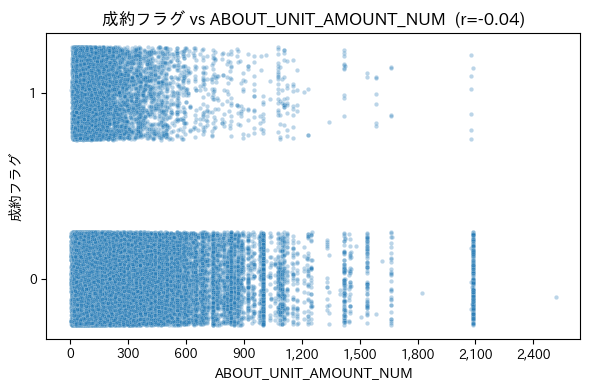

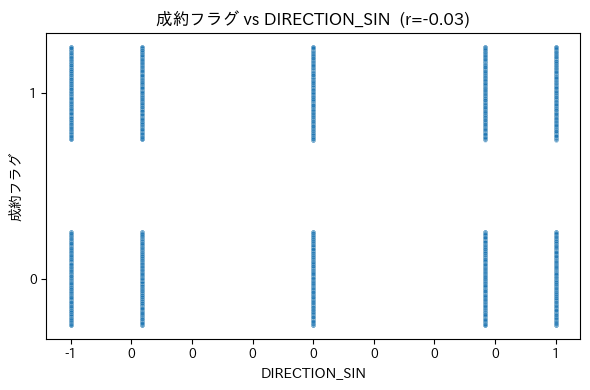

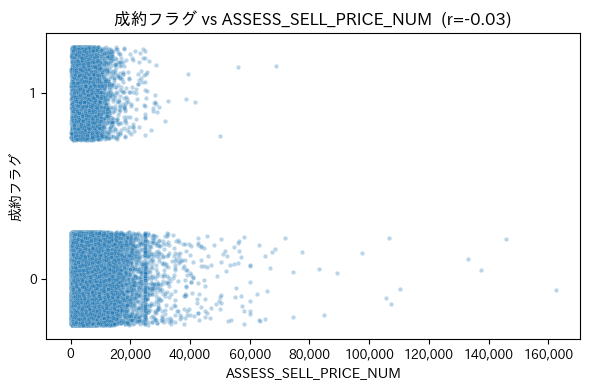

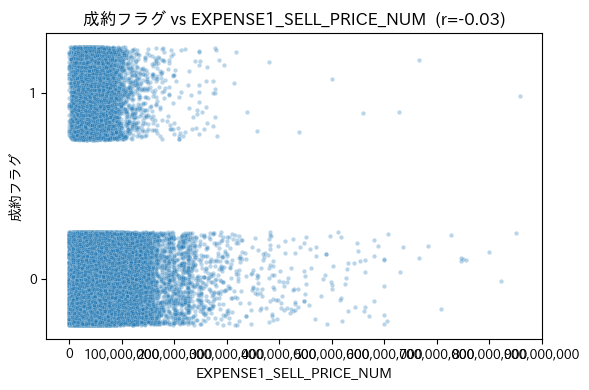

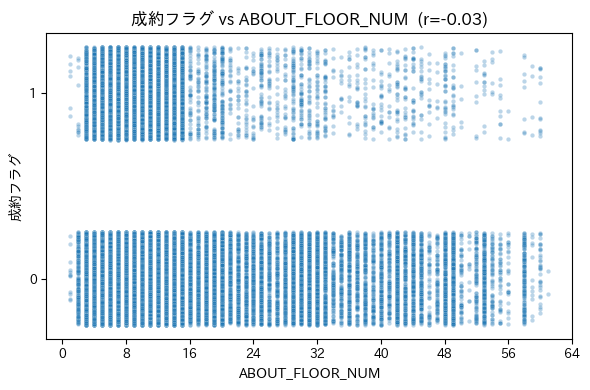

...

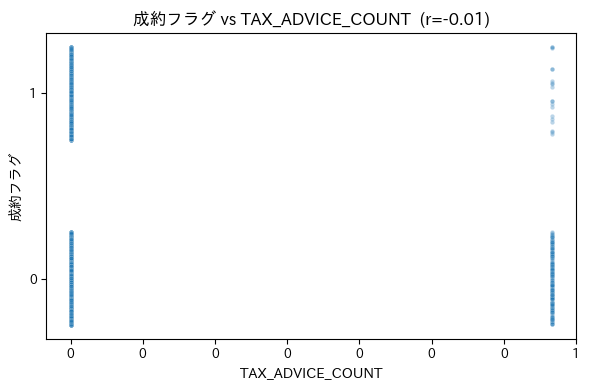

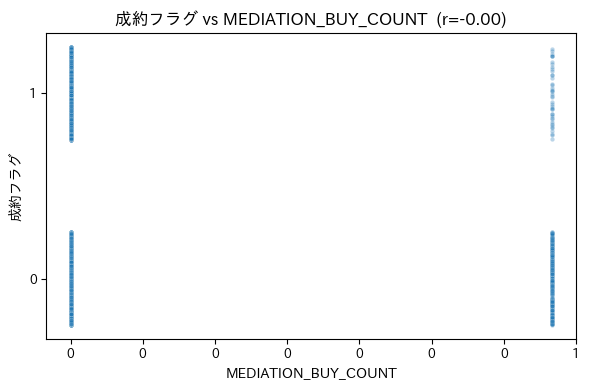

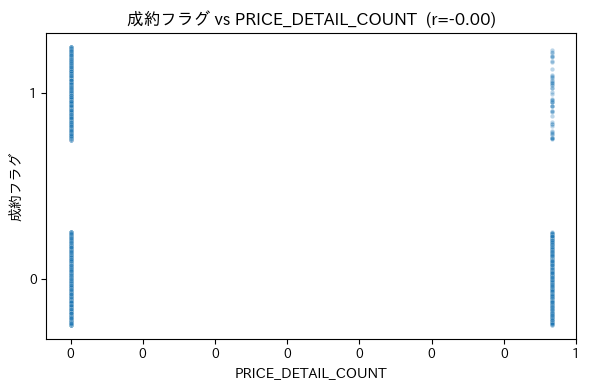

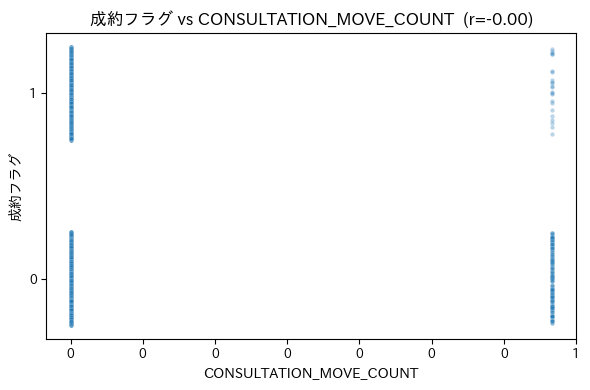

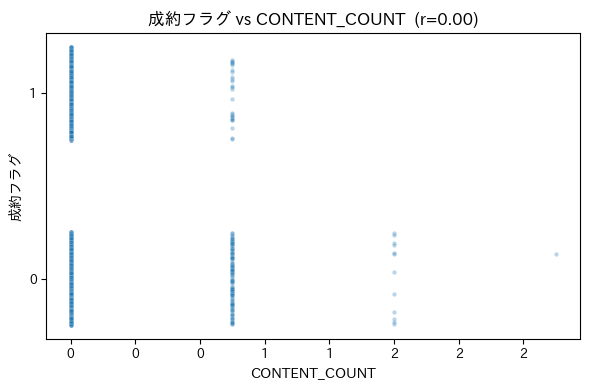


=== INDICATE_MARKET_REPORTS vs 成約フラグ ===
成約フラグ                           0         1  成約率差分(1-0)
INDICATE_MARKET_REPORTS                                
0                        0.872342  0.127658    0.015262
1                        0.857080  0.142920    0.015262


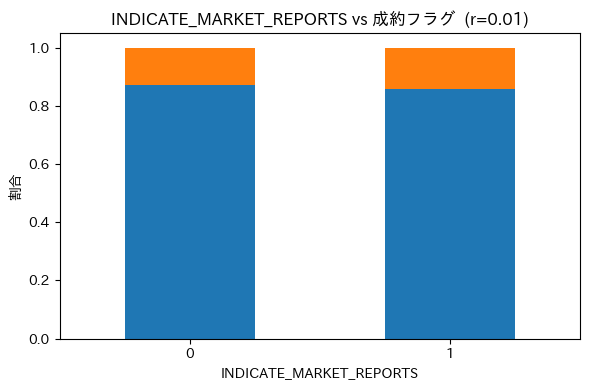


=== INDICATE_AREA_HUMAN vs 成約フラグ ===
成約フラグ                       0         1  成約率差分(1-0)
INDICATE_AREA_HUMAN                                
0                    0.820488  0.179512   -0.038645
1                    0.859133  0.140867   -0.038645


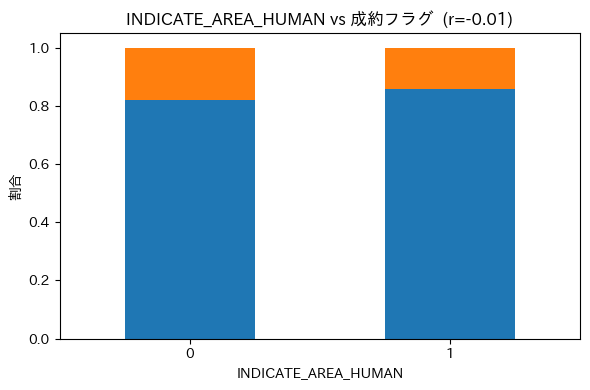


=== INDICATE_MEDIATION_CONTRACT vs 成約フラグ ===
成約フラグ                               0         1  成約率差分(1-0)
INDICATE_MEDIATION_CONTRACT                                
0                            0.815336  0.184664   -0.043693
1                            0.859029  0.140971   -0.043693


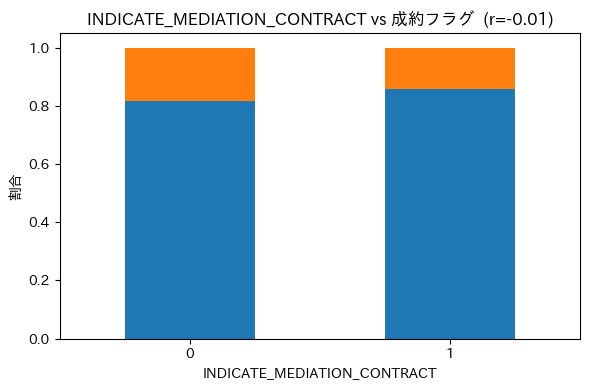


=== EXPENSE1_COMMISSION_RATE_FLG vs 成約フラグ ===
成約フラグ                                0         1  成約率差分(1-0)
EXPENSE1_COMMISSION_RATE_FLG                                
0                             0.865176  0.134824    0.008046
1                             0.857130  0.142870    0.008046


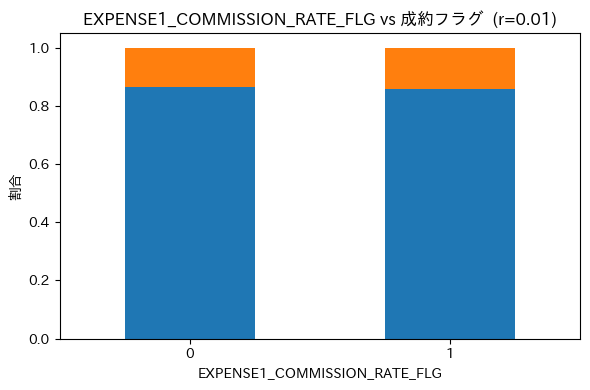


=== RENT_PRICE_FLG vs 成約フラグ ===
成約フラグ                  0         1  成約率差分(1-0)
RENT_PRICE_FLG                                
0               0.857613  0.142387   -0.007221
1               0.864834  0.135166   -0.007221


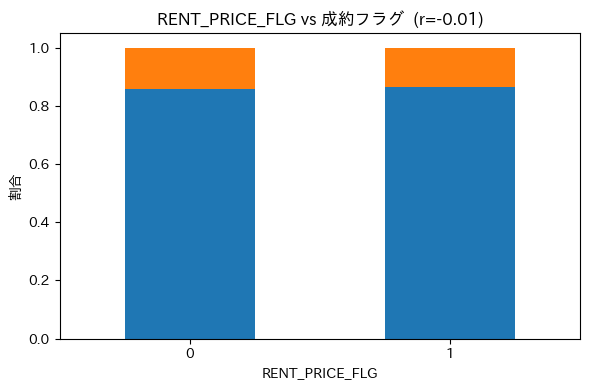


=== INTEREST_COMMENT_FLG vs 成約フラグ ===
成約フラグ                       0        1  成約率差分(1-0)
INTEREST_COMMENT_FLG                              
0                     0.85681  0.14319    -0.00522
1                     0.86203  0.13797    -0.00522


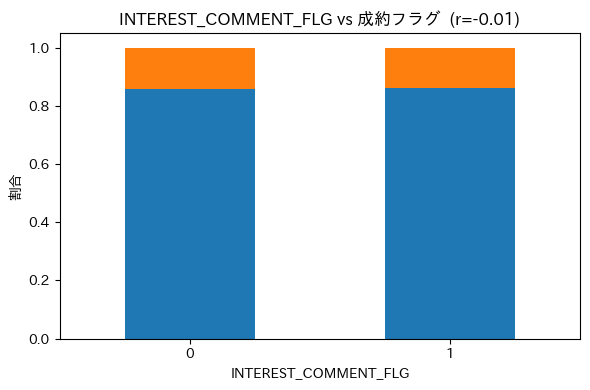


=== SP_READ_FLG vs 成約フラグ ===
成約フラグ               0         1  成約率差分(1-0)
SP_READ_FLG                                
0            0.857991  0.142009   -0.008188
1            0.866178  0.133822   -0.008188


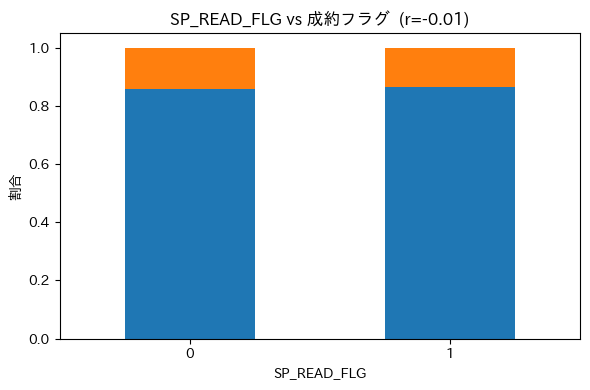


=== LAND_PRIVILEGE_FLG vs 成約フラグ ===
成約フラグ                      0         1  成約率差分(1-0)
LAND_PRIVILEGE_FLG                                
0                   0.875277  0.124723    0.016763
1                   0.858515  0.141485    0.016763


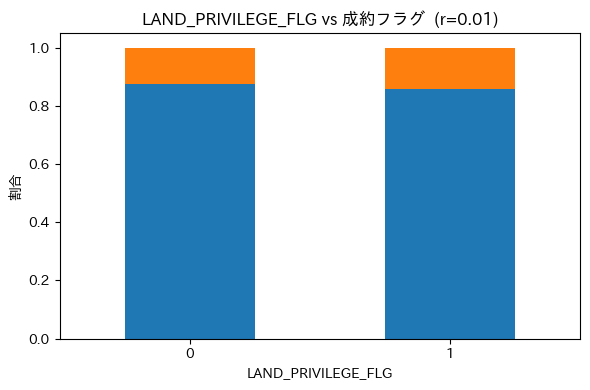


=== INDICATE_MARKET_SELL_TERM vs 成約フラグ ===
成約フラグ                             0         1  成約率差分(1-0)
INDICATE_MARKET_SELL_TERM                                
0                          0.831960  0.168040   -0.026966
1                          0.858927  0.141073   -0.026966


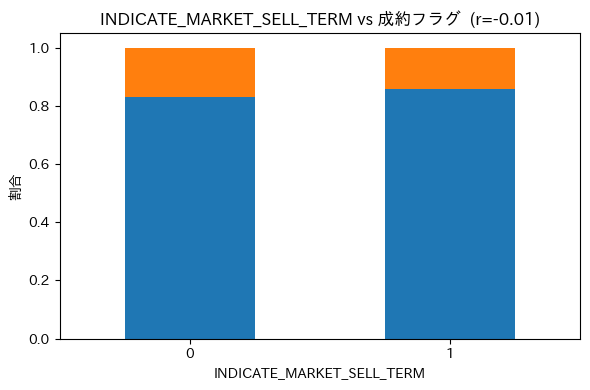


=== INDICATE_PRICE_HISTORY_GRAPH vs 成約フラグ ===
成約フラグ                                0         1  成約率差分(1-0)
INDICATE_PRICE_HISTORY_GRAPH                                
0                             0.765957  0.234043   -0.092863
1                             0.858821  0.141179   -0.092863


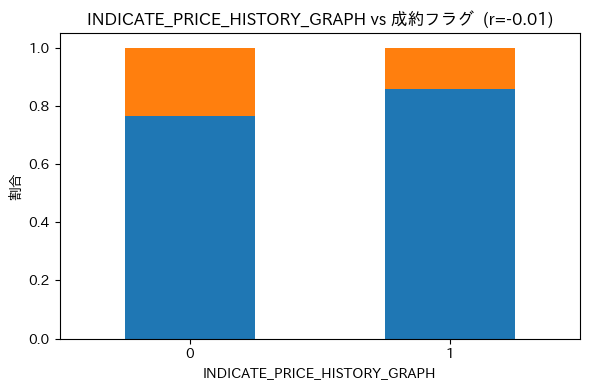


=== INDICATE_PRICE_HISTORY vs 成約フラグ ===
成約フラグ                          0         1  成約率差分(1-0)
INDICATE_PRICE_HISTORY                                
0                       0.833333  0.166667    -0.02556
1                       0.858893  0.141107    -0.02556


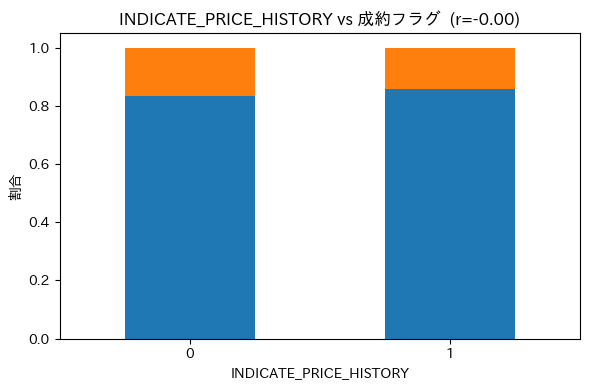


=== INDICATE_MORTGAGE_INTEREST vs 成約フラグ ===
成約フラグ                              0         1  成約率差分(1-0)
INDICATE_MORTGAGE_INTEREST                                
0                           0.870349  0.129651    0.011752
1                           0.858598  0.141402    0.011752


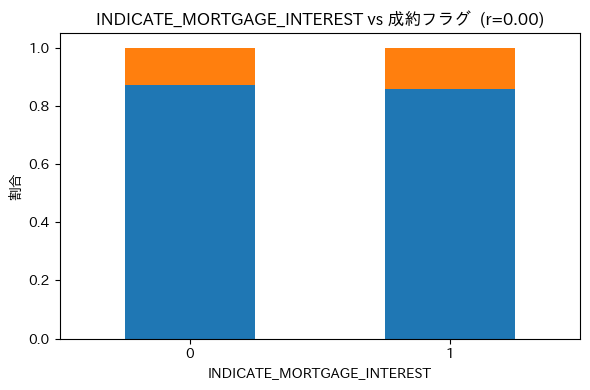


=== TEL_NOTIFY_READ_AT_COUNT vs 成約フラグ ===
成約フラグ                            0         1  成約率差分(1-0)
TEL_NOTIFY_READ_AT_COUNT                                
0                         0.858749  0.141251   -0.060606
1                         0.919355  0.080645   -0.060606


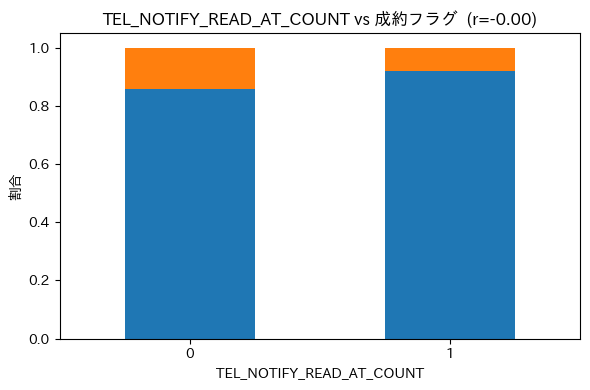


=== INDICATE_COVER_STATISTICS vs 成約フラグ ===
成約フラグ                             0         1  成約率差分(1-0)
INDICATE_COVER_STATISTICS                                
0                          0.884615  0.115385    0.025887
1                          0.858729  0.141271    0.025887


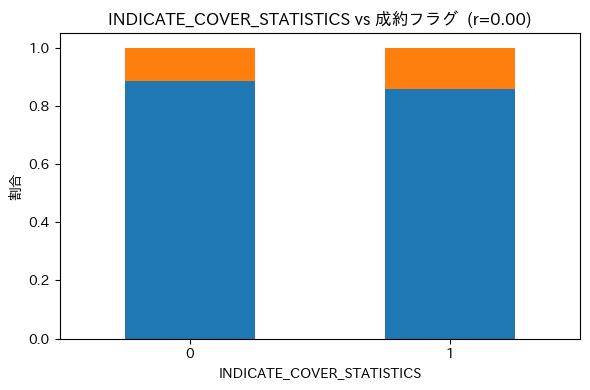


=== INDICATE_FLOATING_INTEREST_COMMENT vs 成約フラグ ===
成約フラグ                                      0         1  成約率差分(1-0)
INDICATE_FLOATING_INTEREST_COMMENT                                
0                                   0.824561  0.175439   -0.034255
1                                   0.858817  0.141183   -0.034255


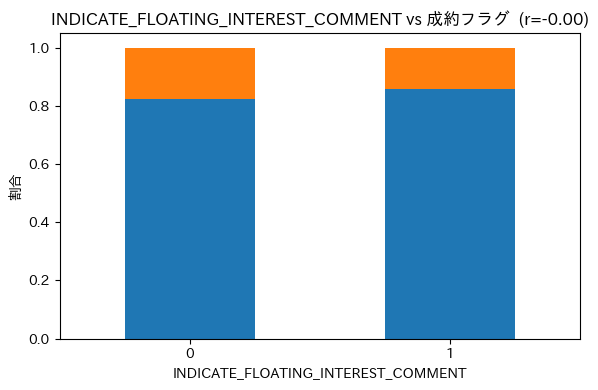


=== INDICATE_AREA_HUMAN_TRANSITION_GRAPH vs 成約フラグ ===
成約フラグ                                        0         1  成約率差分(1-0)
INDICATE_AREA_HUMAN_TRANSITION_GRAPH                                
0                                     0.819672  0.180328   -0.039131
1                                     0.858803  0.141197   -0.039131


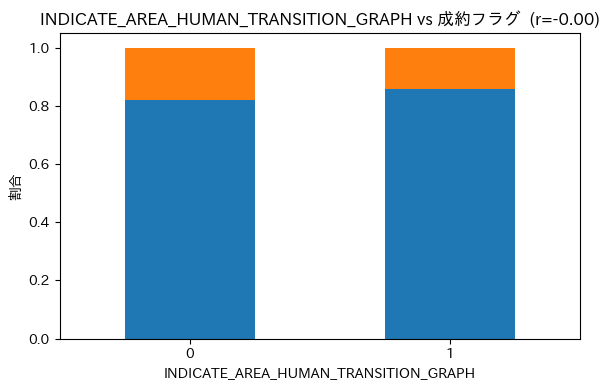


=== HOPE_TEL_FLG_COUNT vs 成約フラグ ===
成約フラグ                      0         1  成約率差分(1-0)
HOPE_TEL_FLG_COUNT                                
0                   0.858760  0.141240   -0.036762
1                   0.895522  0.104478   -0.036762


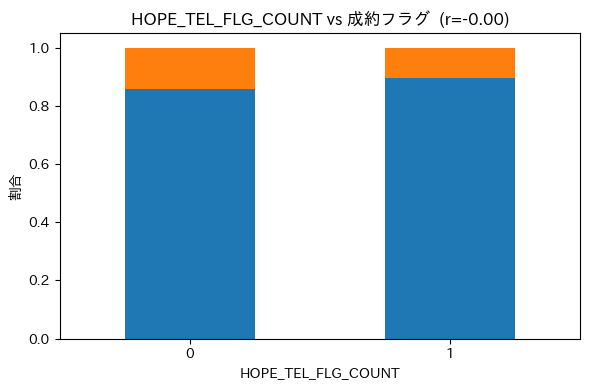


=== READ_FLG vs 成約フラグ ===
成約フラグ            0         1  成約率差分(1-0)
READ_FLG                                
0         0.858342  0.141658   -0.002231
1         0.860574  0.139426   -0.002231


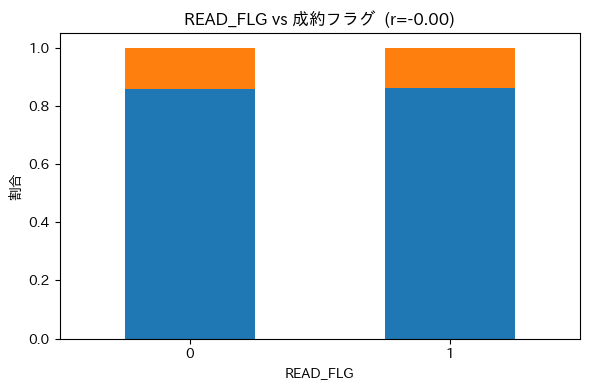


=== INDICATE_PRICE_HISTORY_SELF_COMPARE vs 成約フラグ ===
成約フラグ                                       0         1  成約率差分(1-0)
INDICATE_PRICE_HISTORY_SELF_COMPARE                                
0                                    0.820000  0.180000   -0.038799
1                                    0.858799  0.141201   -0.038799


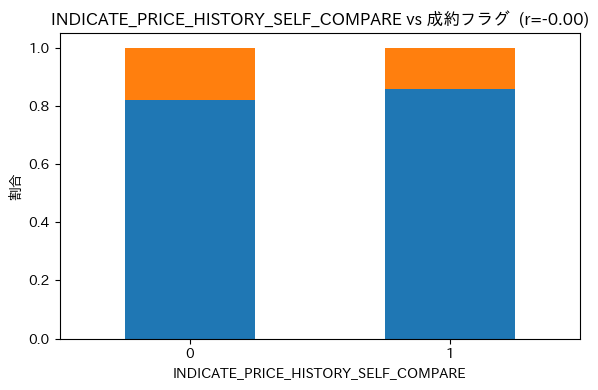


=== INDICATE_AREA_HUMAN_AGE_GRAPH vs 成約フラグ ===
成約フラグ                                 0         1  成約率差分(1-0)
INDICATE_AREA_HUMAN_AGE_GRAPH                                
0                              0.822222  0.177778   -0.036574
1                              0.858797  0.141203   -0.036574


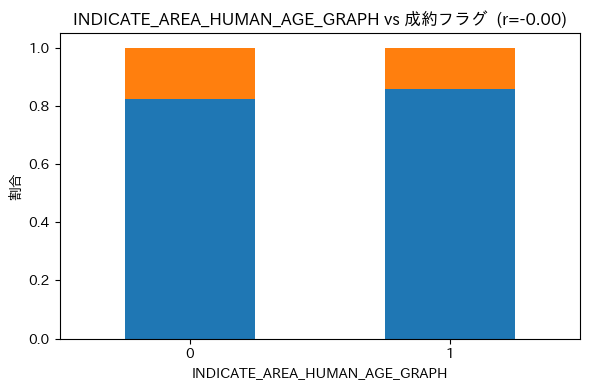


=== INDICATE_MARKET_SIZE vs 成約フラグ ===
成約フラグ                        0         1  成約率差分(1-0)
INDICATE_MARKET_SIZE                                
0                     0.844595  0.155405   -0.014225
1                     0.858819  0.141181   -0.014225


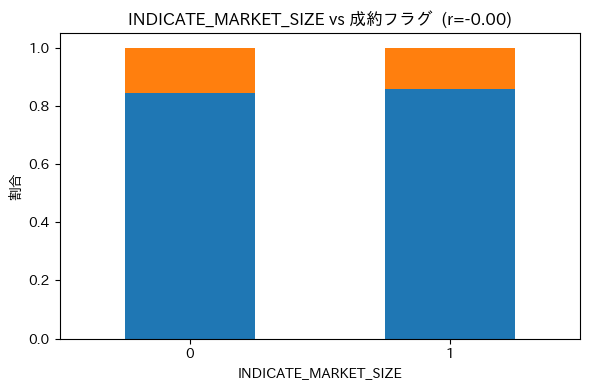


=== CONTENT_COUNT_FLG vs 成約フラグ ===
成約フラグ                     0         1  成約率差分(1-0)
CONTENT_COUNT_FLG                                
0                  0.858809  0.141191    0.018318
1                  0.840491  0.159509    0.018318


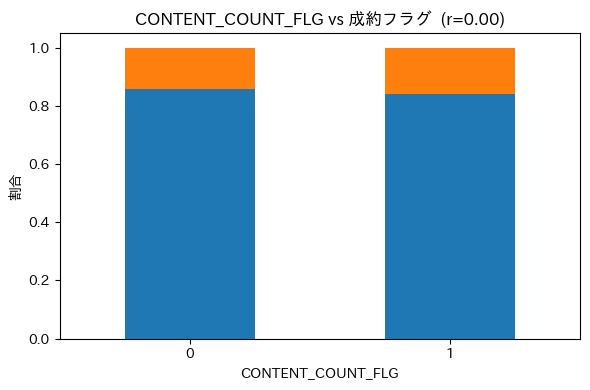


=== TUTORIAL_SP vs 成約フラグ ===
成約フラグ               0         1  成約率差分(1-0)
TUTORIAL_SP                                
0            0.859023  0.140977    0.002232
1            0.856791  0.143209    0.002232


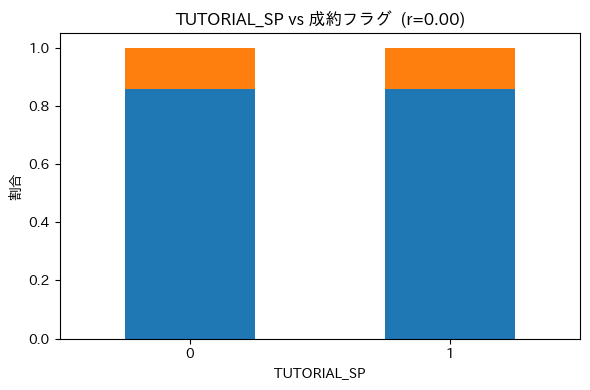


=== INDICATE_PRICE_HISTORY_AREA_COMPARE vs 成約フラグ ===
成約フラグ                                       0         1  成約率差分(1-0)
INDICATE_PRICE_HISTORY_AREA_COMPARE                                
0                                    0.826087  0.173913   -0.032708
1                                    0.858795  0.141205   -0.032708


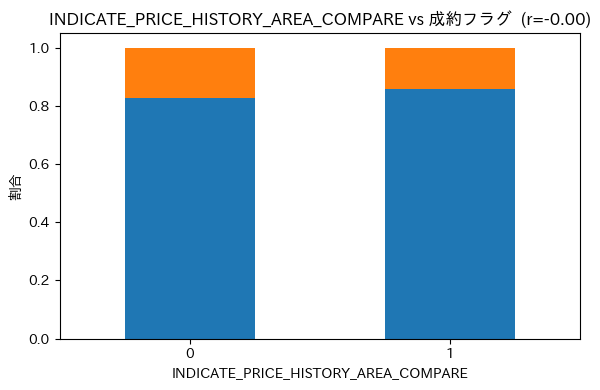


=== MEETING_FLG_COUNT vs 成約フラグ ===
成約フラグ                     0         1  成約率差分(1-0)
MEETING_FLG_COUNT                                
0                  0.858762  0.141238   -0.020867
1                  0.879630  0.120370   -0.020867


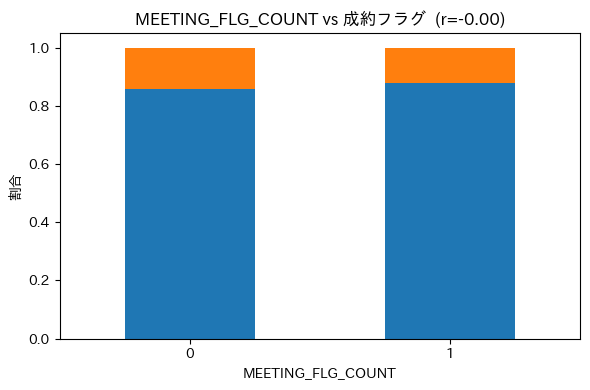


=== VISIT_ASSESSMENT_FLG vs 成約フラグ ===
成約フラグ                        0         1  成約率差分(1-0)
VISIT_ASSESSMENT_FLG                                
0                     0.858790  0.141210    0.040608
1                     0.818182  0.181818    0.040608


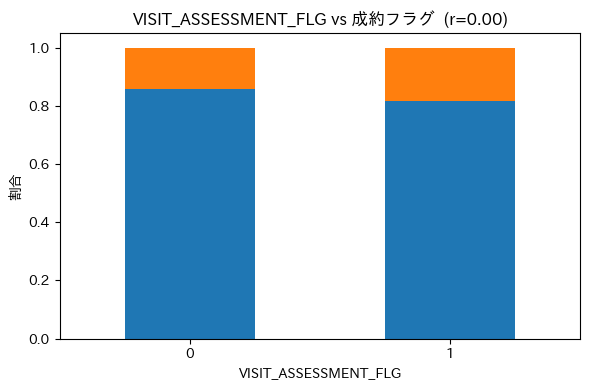


=== MTG_NOTIFY_READ_AT_COUNT vs 成約フラグ ===
成約フラグ                            0         1  成約率差分(1-0)
MTG_NOTIFY_READ_AT_COUNT                                
0                         0.858796  0.141204    0.020958
1                         0.837838  0.162162    0.020958


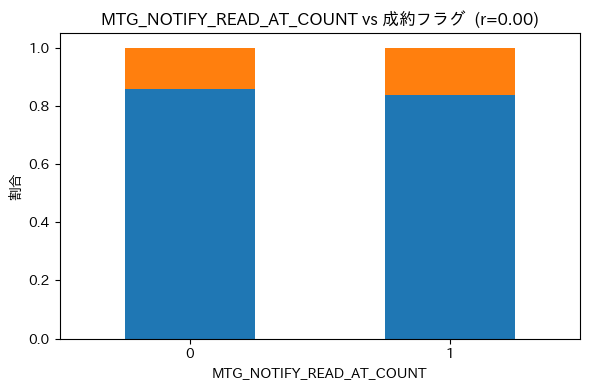


=== TXT_NOTIFY_READ_AT vs 成約フラグ ===
成約フラグ                      0         1  成約率差分(1-0)
TXT_NOTIFY_READ_AT                                
0.0                 0.858801  0.141199     0.01364
1.0                 0.845161  0.154839     0.01364


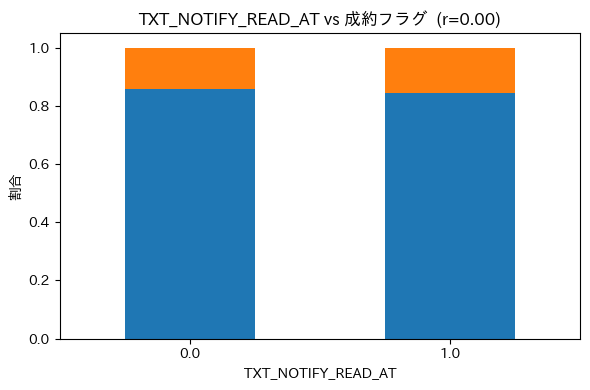


=== INDICATE_COVER_MARKET vs 成約フラグ ===
成約フラグ                         0         1  成約率差分(1-0)
INDICATE_COVER_MARKET                                
0                      0.858974  0.141026    0.000193
1                      0.858782  0.141218    0.000193


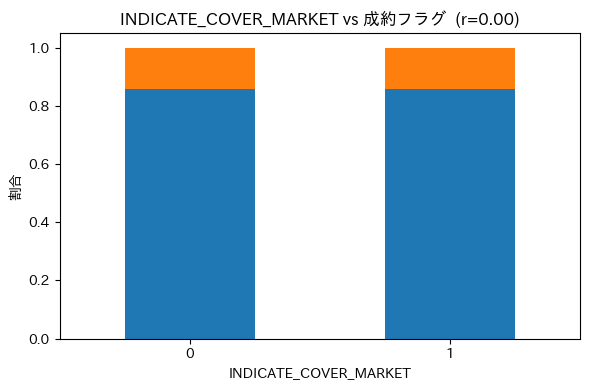


=== binary_cols まとめ表 ===


,カラム,成約率(0),成約率(1),差分(1-0),相関係数
0,INDICATE_MARKET_REPORTS,0.128,0.143,0.015,0.014
1,INDICATE_AREA_HUMAN,0.180,0.141,-0.039,-0.011
2,INDICATE_MEDIATION_CONTRACT,0.185,0.141,-0.044,-0.009
3,EXPENSE1_COMMISSION_RATE_FLG,0.135,0.143,0.008,0.009
4,RENT_PRICE_FLG,0.142,0.135,-0.007,-0.008
5,INTEREST_COMMENT_FLG,0.143,0.138,-0.005,-0.007
6,SP_READ_FLG,0.142,0.134,-0.008,-0.007
7,LAND_PRIVILEGE_FLG,0.125,0.141,0.017,0.006
8,INDICATE_MARKET_SELL_TERM,0.168,0.141,-0.027,-0.006
9,INDICATE_PRICE_HISTORY_GRAPH,0.234,0.141,-0.093,-0.005



=== DIRECTION のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
DIRECTION,,,,
1,1362,0.841,0.159,15.900
2,2064,0.831,0.169,16.900
3,21986,0.880,0.120,12.000
4,16690,0.840,0.160,16.000
5,40332,0.870,0.130,13.000
6,15990,0.837,0.163,16.300
7,9464,0.833,0.167,16.700
8,2241,0.836,0.164,16.400


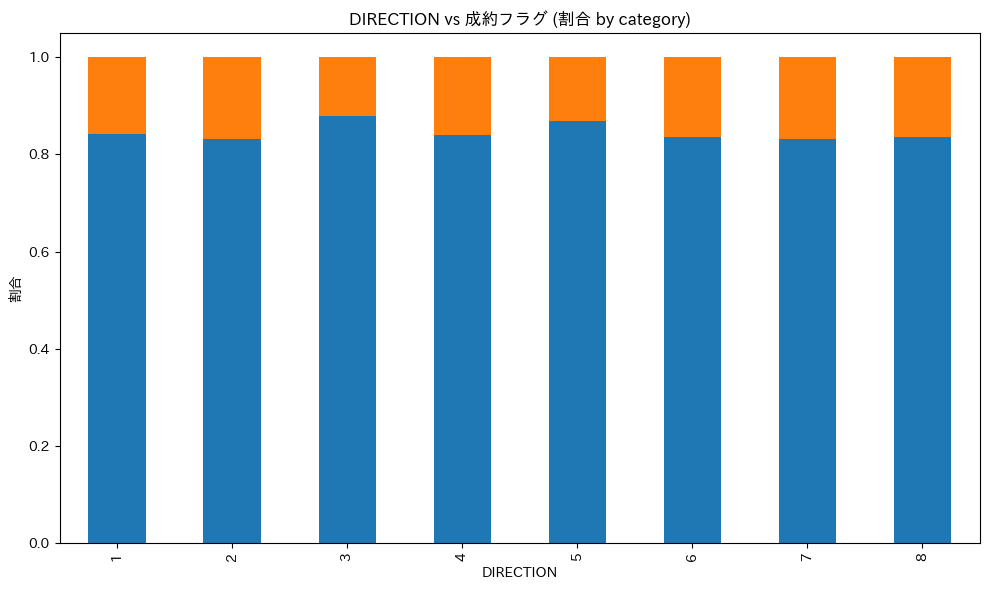


=== PREFECTURE のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
PREFECTURE,,,,
北海道,1896,0.916,0.084,8.400
青森県,7,1.000,0.000,0.000
岩手県,58,0.897,0.103,10.300
宮城県,421,0.850,0.150,15.000
秋田県,2,1.000,0.000,0.000
山形県,20,0.800,0.200,20.000
福島県,35,0.886,0.114,11.400
茨城県,474,0.951,0.049,4.900
栃木県,170,0.865,0.135,13.500


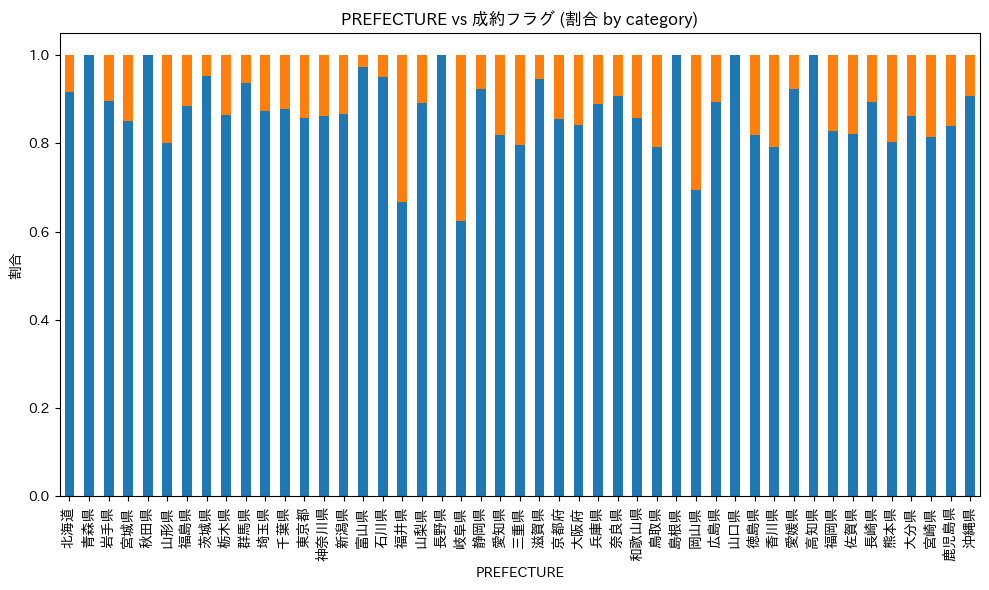


=== REGION のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
REGION,,,,
北海道,1896,0.916,0.084,8.400
東北,543,0.858,0.142,14.200
関東,87945,0.862,0.138,13.800
中部,2729,0.837,0.163,16.300
近畿,10491,0.852,0.148,14.800
中国,1050,0.773,0.227,22.700
四国,763,0.831,0.169,16.900
九州,7287,0.833,0.167,16.700
沖縄,324,0.907,0.093,9.300


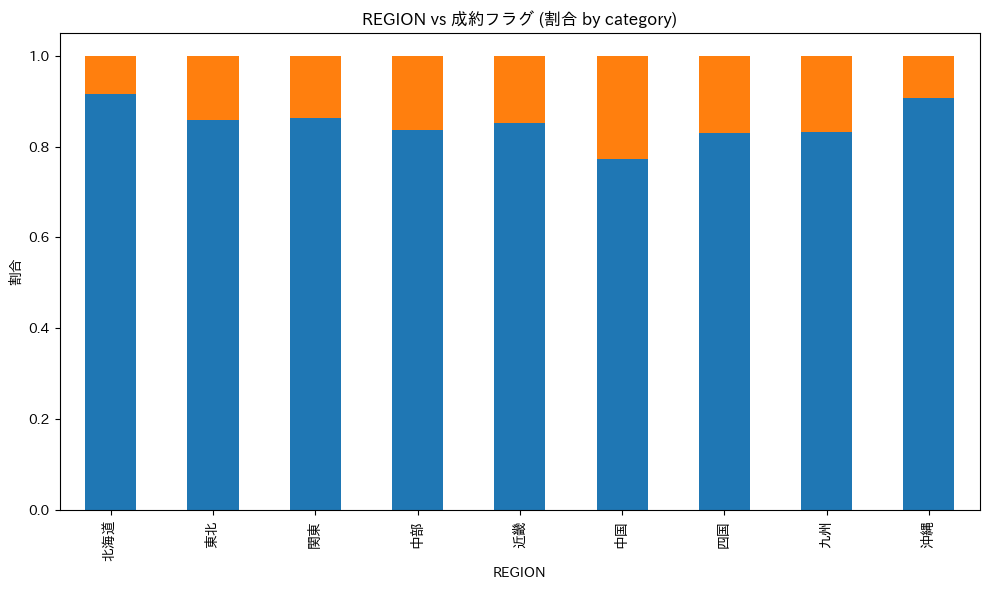


=== USAGE_AREA_REP のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
USAGE_AREA_REP,,,,
第一種低層住居専用地域,4715,0.872,0.128,12.800
第二種低層住居専用地域,169,0.811,0.189,18.900
第一種中高層住居専用地域,14280,0.880,0.120,12.000
第二種中高層住居専用地域,4494,0.871,0.129,12.900
第一種住居地域,18454,0.866,0.134,13.400
第二種住居地域,6192,0.873,0.127,12.700
準住居地域,2173,0.854,0.146,14.600
近隣商業地域,9841,0.853,0.147,14.700
商業地域,25231,0.846,0.154,15.400


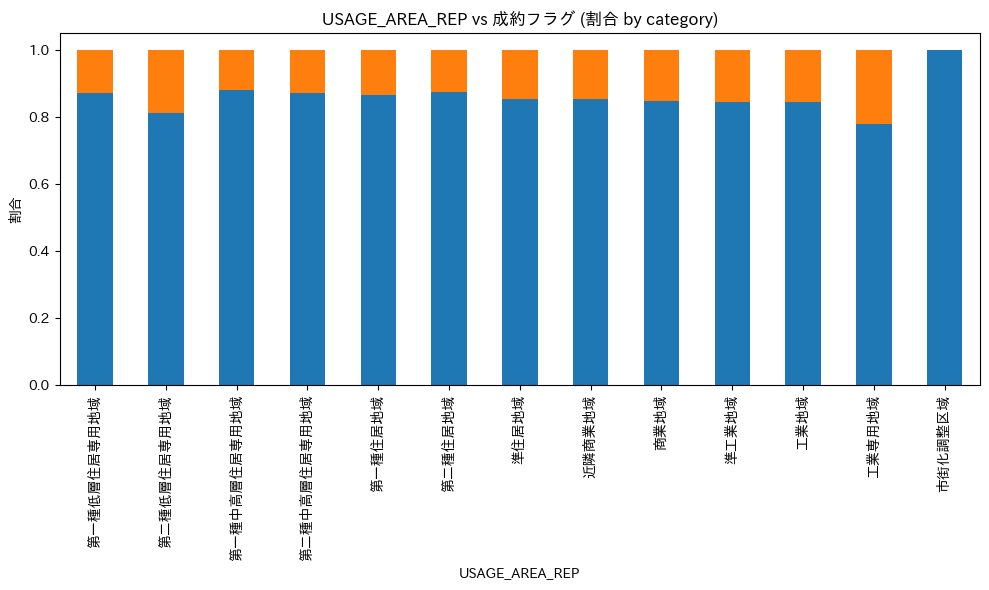


=== STRUCTURE_CAT のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
STRUCTURE_CAT,,,,
SRC,27825,0.856,0.144,14.400
RC,84963,0.860,0.140,14.000
鉄骨,121,0.917,0.083,8.300
軽量鉄骨,18,0.889,0.111,11.100
木造,73,0.877,0.123,12.300
その他,12,0.917,0.083,8.300


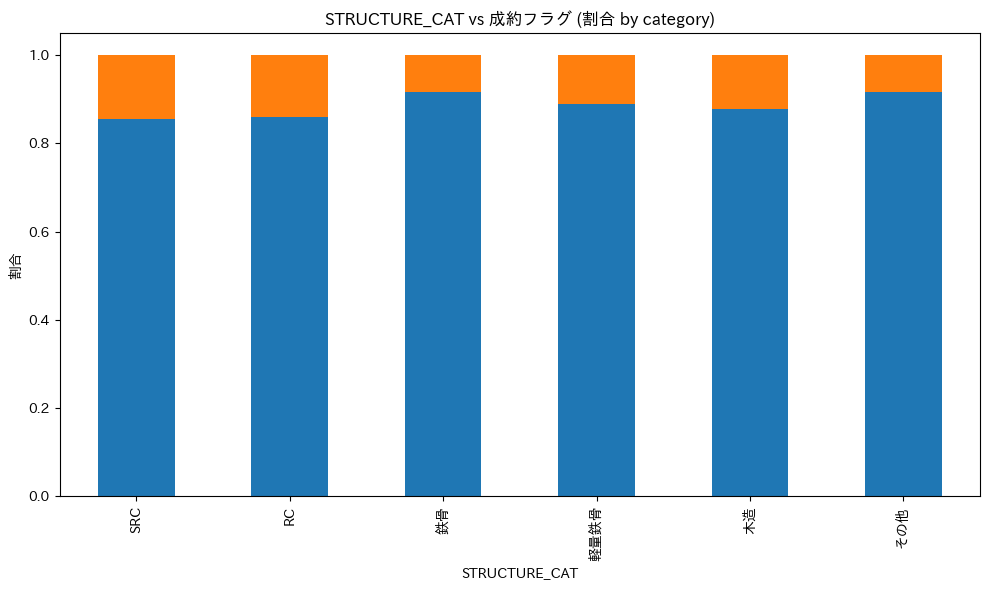


=== BUILDING_AGE_BIN のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
BUILDING_AGE_BIN,,,,
1年目,955,0.849,0.151,15.100
2-9年,14328,0.831,0.169,16.900
10-19年,27240,0.865,0.135,13.500
20-29年,34320,0.868,0.132,13.200
30-39年,15108,0.863,0.137,13.700
40-49年,15204,0.852,0.148,14.800
50-59年,5464,0.858,0.142,14.200
60-69年,109,0.872,0.128,12.800
70-79年,2,1.000,0.000,0.000


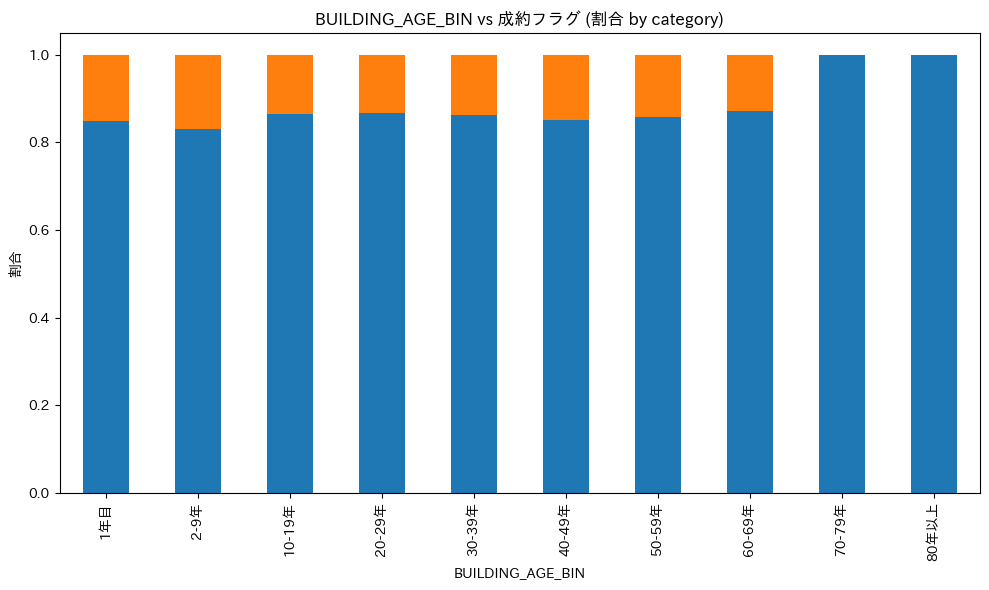

In [72]:
# すでに numeric_cols / binary_cols / categorical_cols を定義済みとする

visualize_with_base(df_m, base, target="成約フラグ")


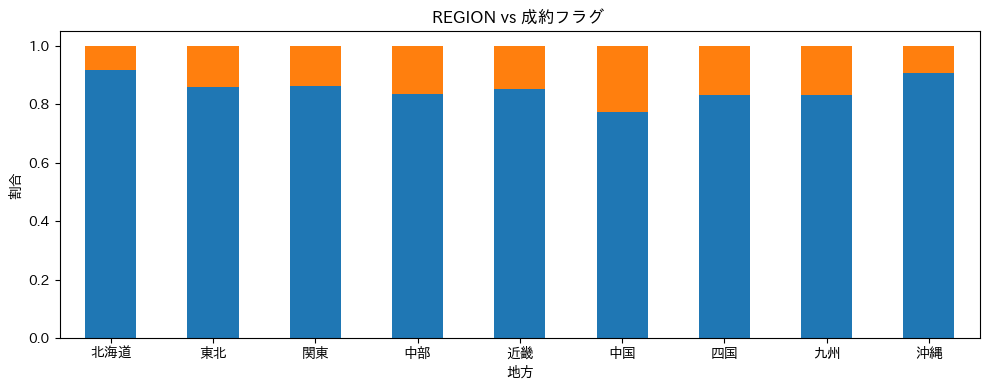

In [73]:
# 地方ごとの成約フラグの割合を棒グラフで表示
target="成約フラグ"
ct = pd.crosstab(df_m["REGION"], df_m[target], normalize="index")
region_order = ['北海道', '東北', '関東', '中部', '近畿', '中国', '四国', '九州', '沖縄']
ct = ct.reindex(region_order)

ax = ct.plot(kind="bar", stacked=True, figsize=(10, 4))
plt.title(f"REGION vs {target} ")
plt.ylabel("割合")
plt.xlabel("地方")
plt.xticks(rotation=0)
ax.get_legend().remove()
plt.tight_layout()
plt.show()

### カテゴリ変数の件数分布 ###

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


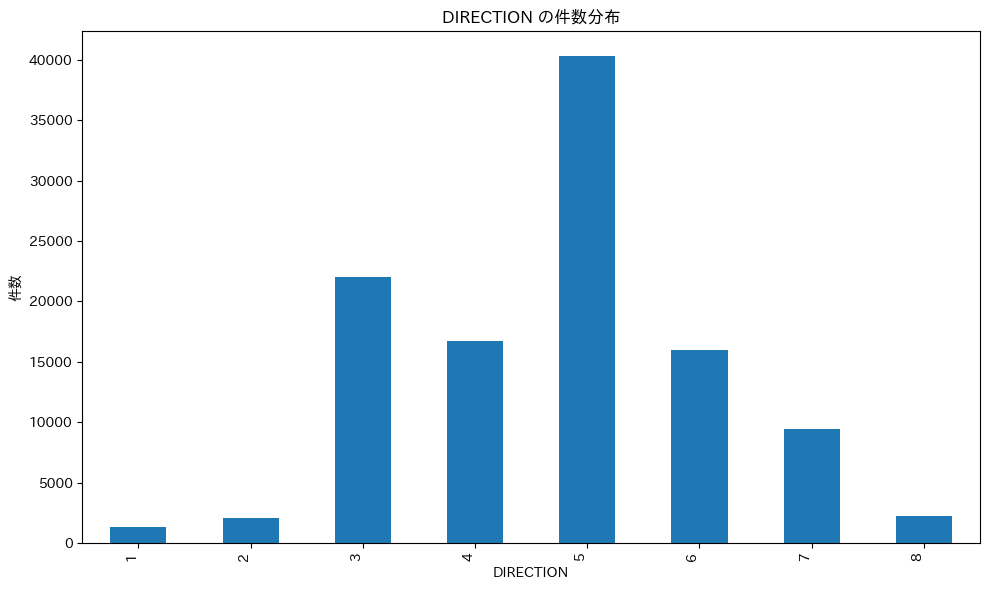

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


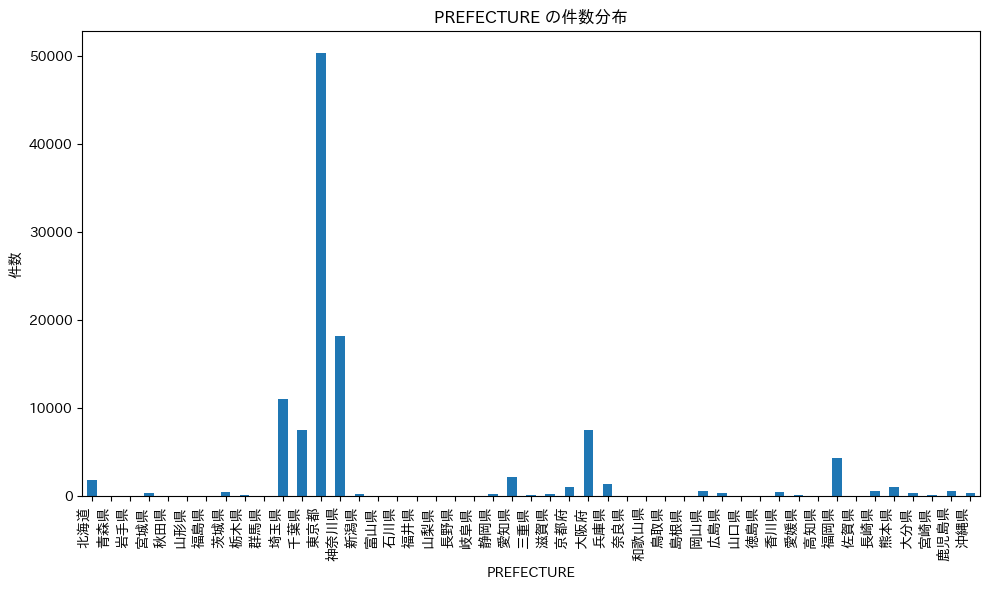

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


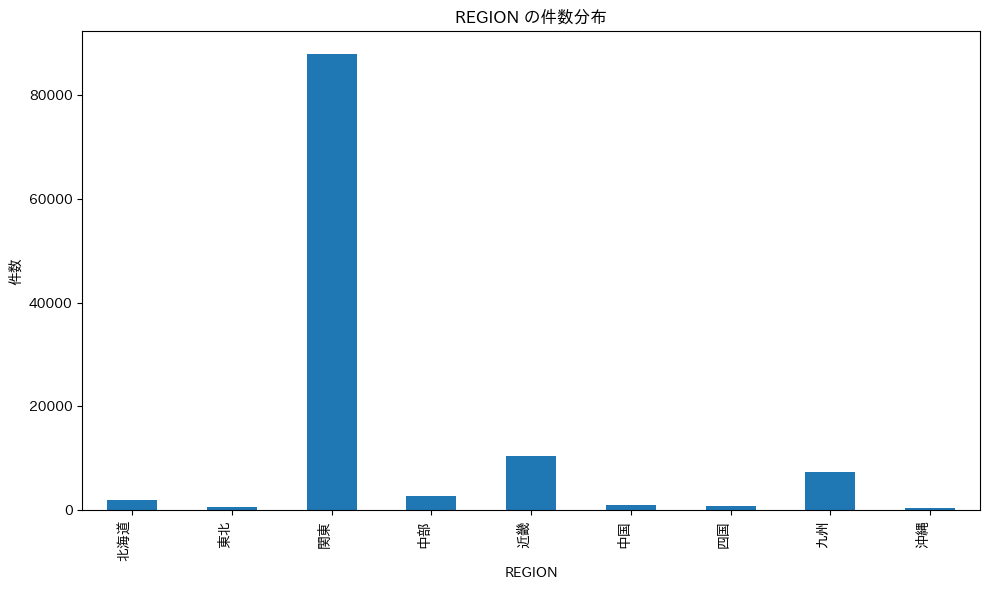

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


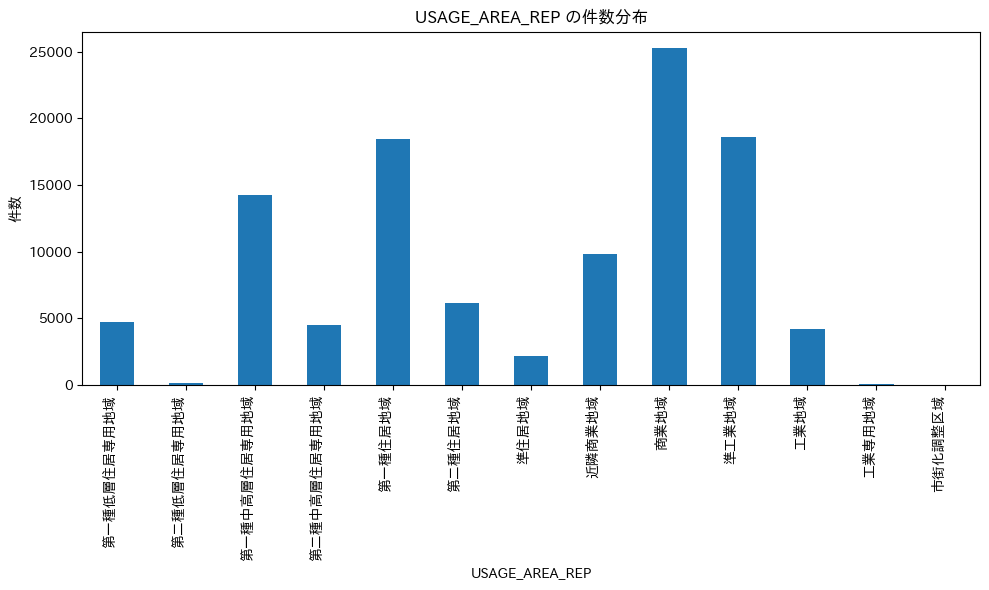

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


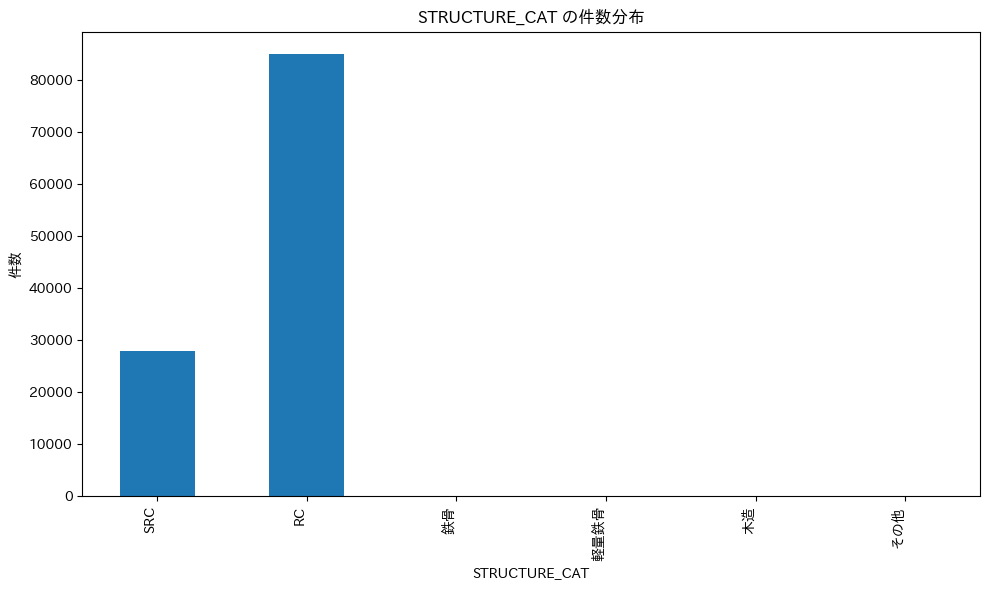

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


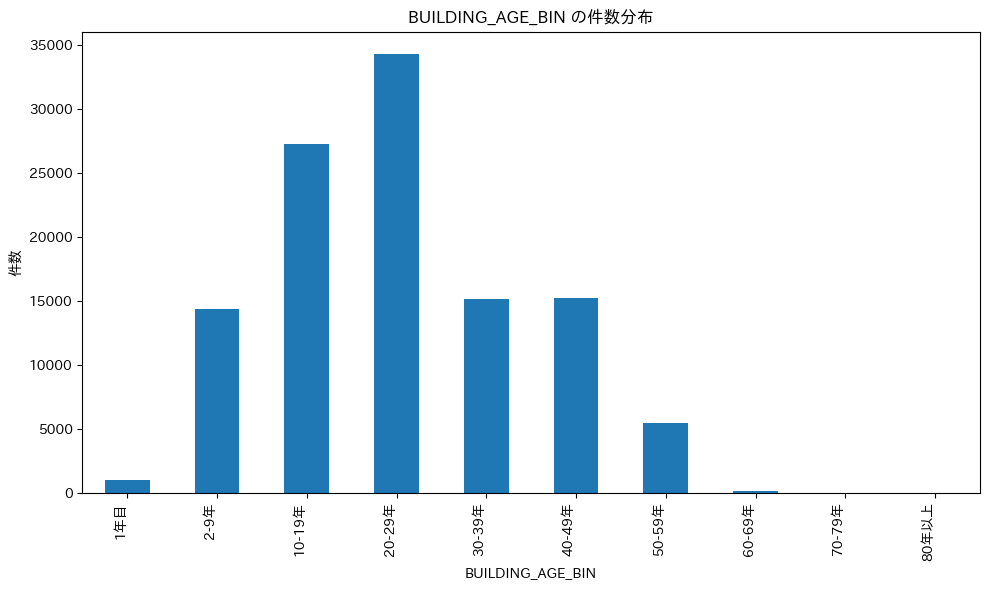

In [74]:
plot_categorical_distribution(df_m, categorical_cols)

### 考察(マンション) ###

**【数値変数について】**  
基本は相関係数の順番で関係はありそう  
※DIRECSION_SINについては散布図を見ても相関の有無は読み取れず、微妙  
・BUILDING_AGE(築年数)は、築30年が境目となってフラグ１分布に少し変化がある（築３０年以降は1の割合がさらに少なくなっていそう）  
→10年ごとにbinで分けて見てみるなどの工夫が必要  
・CONTENT_COUNTは現時点で相関はない。フラグ化をすれば相関出るかも？  
**----------------------------------------------------------**  
→→→基本は相関係数上位を特徴量として検討。一部変数については工夫をして再度相関を見る  

**【バイナリ変数について】**  
相関係数が小さい/0.0であっても、0と1で割合の差分が大きいものもあった  
◾️相関係数が0.01以上あるが、割合の差分かかなり小さい  
・RENT_PRICE_FLG  
・INTEREST_COMMENT_FLG  
は特徴量として入れても無意味  

◾️相関係数は0.00だが、割合の差分が3.5%以上ある  
・TEL_NOTIFY_READ_AT_COUNT  
・INDICATE_COVER_STATISTICS  
・HOPE_TEL_FLG_COUNT  
・INDICATE_AREA_HUMAN_TRANSITION_GRAPH  
・INDICATE_PRICE_HISTORY_SELF_COMPARE  
・INDICATE_AREA_HUMAN_AGE_GRAPH  
・VISIT_ASSESSMENT_FLG  
は特徴量に入れた方が良い可能性  
**----------------------------------------------------------**  
→→→基本は相関係数上位を特徴量として検討。一部変数については特徴量から外す、特徴量に追加を検討  

**【カテゴリ変数について】**   
・USER_IDについては、件数が2500件超と比較的多いUSER_ID=3730について、成約率も１０％以下と他のUSER_IDと比較しても低めなので特徴量にしても良いかも   
・都道府県別では、成約割合が高い/低い都道府県は全体に占める件数も少ない    
・地方別でも都道府県と同様で、比較的成約割合が高い/低い地方は全体に占める件数も少ない    
・DIRECTION(バルコニー方向)については、件数上位の3,5が他の方向より少し成約割合が少ない。他の方向との差にもよるが、特徴量にできる可能性がある    
・用途地域については、成約割合が高い/低い用途地域は全体に占める件数も少ない   
・構造についてはほとんどがRCとSRCで構成されており、両者の成約割合にほぼ差異はなかった   
**----------------------------------------------------------**  
→→→USER_IDとDIRECTIONについては特徴量として検討  





### 欠損率の算出・保存 ###

In [77]:
# 関数の結果を変数に格納
missing_info = check_missing_info(df_m)

# CSVとして出力
missing_info.to_csv(os.path.join(OUTPUT_DIR, "missing_info_m.csv"), index=False, encoding="utf-8-sig")

## 土地 ##

In [78]:
df_l['ASSESSED_ON']

2        2023-02-01
8        2023-02-01
10       2023-02-01
44       2023-02-01
68       2023-02-02
69       2023-02-02
70       2023-02-02
71       2023-02-02
82       2023-02-02
102      2023-02-02
115      2023-02-02
117      2023-02-02
127      2023-02-02
130      2023-02-02
135      2023-02-02
151      2023-02-02
173      2023-02-02
177      2023-02-02
195      2023-02-02
223      2023-02-02
241      2023-02-02
250      2023-02-02
257      2023-02-02
258      2023-02-02
263      2023-02-02
269      2023-02-02
272      2023-02-02
275      2023-02-02
282      2023-02-02
284      2023-02-02
286      2023-02-02
308      2023-02-02
309      2023-02-02
311      2023-02-02
318      2023-02-03
330      2023-02-03
336      2023-02-03
338      2023-02-03
339      2023-02-03
357      2023-02-03
381      2023-02-03
398      2023-02-03
399      2023-02-03
427      2023-02-03
429      2023-02-03
432      2023-02-03
457      2023-02-03
458      2023-02-03
460      2023-02-03
474      2023-02-03


### 前処理 ###

In [79]:
df_l['LAND_SPACE_NUM'] = (
    df_l['LAND_SPACE']
    .astype(str)
    .str.extract(r'([0-9]+(?:\.[0-9]+)?)')
    .astype(float)
)

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/402368940.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['LAND_SPACE_NUM'] = (


In [80]:
# もともと欠損していないのに、抽出後はNaNになったものを抽出
mask = df_l['LAND_SPACE'].notna() & df_l['LAND_SPACE_NUM'].isna()
problematic_rows = df_l.loc[mask, 'LAND_SPACE']

print("=== LAND_SPACE では値あり、LAND_SPACE_NUM で NaN になった例 ===")
print(problematic_rows.unique()[:50])  # 例として最大50種類だけ表示


=== LAND_SPACE では値あり、LAND_SPACE_NUM で NaN になった例 ===
[]


In [82]:
# 適用（SettingWithCopyWarning を避けるため loc を使う）
df_l.loc[:, 'ASSESS_RENT_PRICE_NUM']        = to_avg_number_series(df_l['ASSESS_RENT_PRICE'])
df_l.loc[:, 'ASSESS_SELL_PRICE_NUM']        = to_avg_number_series(df_l['ASSESS_SELL_PRICE'])
df_l.loc[:, 'ASSESS_SELL_SQUARE_PRICE_NUM'] = to_avg_number_series(df_l['ASSESS_SELL_SQUARE_PRICE'])
df_l.loc[:, 'ASSESS_SELL_TSUBO_PRICE_NUM']  = to_avg_number_series(df_l['ASSESS_SELL_TSUBO_PRICE'])
df_l.loc[:, 'ASSESS_SELL_TERM_NUM']         = to_avg_number_series(df_l['ASSESS_SELL_TERM'])
df_l.loc[:, 'ASSESS_PURCHASE_TERM_NUM']     = to_avg_number_series(df_l['ASSESS_PURCHASE_TERM'])
df_l.loc[:, 'EXPENSE1_SELL_PRICE_NUM']      = to_avg_number_series(df_l['EXPENSE1_SELL_PRICE'])

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/989467439.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l.loc[:, 'ASSESS_RENT_PRICE_NUM']        = to_avg_number_series(df_l['ASSESS_RENT_PRICE'])
/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/989467439.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l.loc[:, 'ASSESS_SELL_PRICE_NUM']        = to_avg_number_series(df_l['ASSESS_SELL_PRICE'])
/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/98946

In [83]:
#元カラムではNaNではなかったのに、数値化後カラムではNaNになってしまったものを確認

# 対象の「元カラム → 数値化後カラム」ペアを定義
pairs = [
    ('ASSESS_RENT_PRICE',        'ASSESS_RENT_PRICE_NUM'),
    ('ASSESS_SELL_PRICE',        'ASSESS_SELL_PRICE_NUM'),
    ('ASSESS_SELL_SQUARE_PRICE', 'ASSESS_SELL_SQUARE_PRICE_NUM'),
    ('ASSESS_SELL_TSUBO_PRICE',  'ASSESS_SELL_TSUBO_PRICE_NUM'),
    ('ASSESS_SELL_TERM',         'ASSESS_SELL_TERM_NUM'),
    ('ASSESS_PURCHASE_TERM',     'ASSESS_PURCHASE_TERM_NUM'),
    ('EXPENSE1_SELL_PRICE',      'EXPENSE1_SELL_PRICE_NUM'),
]

# 1) 件数サマリ
rows = []
for src, num in pairs:
    mask = df_l[src].notna() & df_l[num].isna()
    rows.append({
        'src_col': src,
        'num_col': num,
        'n_problem': int(mask.sum()),
        'n_unique_problem_values': int(df_l.loc[mask, src].nunique(dropna=True))
    })
summary_parse_fail = pd.DataFrame(rows).sort_values('n_problem', ascending=False).reset_index(drop=True)
print("=== 変換失敗（元値あり→数値NaN） 件数サマリ ===")
print(summary_parse_fail)

# 2) 各列の「問題となった元値」を上位例で確認（value_counts 上位20）
for src, num in pairs:
    mask = df_l[src].notna() & df_l[num].isna()
    if mask.any():
        print(f"\n=== {src} → {num} 変換失敗: {mask.sum()}件 ===")
        # 問題となった値の上位20種を表示（頻度順）
        print(df_l.loc[mask, src].astype(str).value_counts().head(20))


=== 変換失敗（元値あり→数値NaN） 件数サマリ ===
                    src_col                       num_col  n_problem  \
0          ASSESS_SELL_TERM          ASSESS_SELL_TERM_NUM       1317   
1      ASSESS_PURCHASE_TERM      ASSESS_PURCHASE_TERM_NUM         15   
2   ASSESS_SELL_TSUBO_PRICE   ASSESS_SELL_TSUBO_PRICE_NUM         12   
3  ASSESS_SELL_SQUARE_PRICE  ASSESS_SELL_SQUARE_PRICE_NUM         10   
4         ASSESS_SELL_PRICE         ASSESS_SELL_PRICE_NUM          9   
5         ASSESS_RENT_PRICE         ASSESS_RENT_PRICE_NUM          1   
6       EXPENSE1_SELL_PRICE       EXPENSE1_SELL_PRICE_NUM          0   

   n_unique_problem_values  
0                       16  
1                       12  
2                        1  
3                        1  
4                        8  
5                        1  
6                        0  

=== ASSESS_RENT_PRICE → ASSESS_RENT_PRICE_NUM 変換失敗: 1件 ===
ASSESS_RENT_PRICE
ご相談ください    1
Name: count, dtype: int64

=== ASSESS_SELL_PRICE → ASSESS_SELL_PRICE_

### 外れ値処理 ###

In [84]:
# READ_COUNT（100以上 → 異常値）
cond = df_l["READ_COUNT"] >= 100
print(f"READ_COUNTで外れ値として除外された件数: {cond.sum()}件")
df_l.loc[cond, "READ_COUNT"] = np.nan

# ASSESS_SELL_PRICE_NUM（4億円超）
cond = df_l["ASSESS_SELL_PRICE_NUM"] >= 400_000
print(f"ASSESS_SELL_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_l.loc[cond, "ASSESS_SELL_PRICE_NUM"] = np.nan

# ASSESS_SELL_SQUARE_PRICE_NUM（700万円/㎡超）
cond = df_l["ASSESS_SELL_SQUARE_PRICE_NUM"] >= 700
print(f"ASSESS_SELL_SQUARE_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_l.loc[cond, "ASSESS_SELL_SQUARE_PRICE_NUM"] = np.nan

# ASSESS_SELL_TSUBO_PRICE_NUM（2005万円/坪超）
cond = df_l["ASSESS_SELL_TSUBO_PRICE_NUM"] >= 2005
print(f"ASSESS_SELL_TSUBO_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_l.loc[cond, "ASSESS_SELL_TSUBO_PRICE_NUM"] = np.nan

# ASSESS_SELL_TERM_NUM（30ヶ月超）
cond = df_l["ASSESS_SELL_TERM_NUM"] >= 30
print(f"ASSESS_SELL_TERM_NUMで外れ値として除外された件数: {cond.sum()}件")
df_l.loc[cond, "ASSESS_SELL_TERM_NUM"] = np.nan

# ASSESS_PURCHASE_TERM_NUM（30ヶ月超）
cond = df_l["ASSESS_PURCHASE_TERM_NUM"] >= 30
print(f"ASSESS_PURCHASE_TERM_NUMで外れ値として除外された件数: {cond.sum()}件")
df_l.loc[cond, "ASSESS_PURCHASE_TERM_NUM"] = np.nan

# EXPENSE1_SELL_PRICE_NUM（100億円超）
cond = df_l["EXPENSE1_SELL_PRICE_NUM"] >= 10_000_000_000
print(f"EXPENSE1_SELL_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_l.loc[cond, "EXPENSE1_SELL_PRICE_NUM"] = np.nan


READ_COUNTで外れ値として除外された件数: 1件
ASSESS_SELL_PRICE_NUMで外れ値として除外された件数: 6件
ASSESS_SELL_SQUARE_PRICE_NUMで外れ値として除外された件数: 1件
ASSESS_SELL_TSUBO_PRICE_NUMで外れ値として除外された件数: 1件
ASSESS_SELL_TERM_NUMで外れ値として除外された件数: 1件
ASSESS_PURCHASE_TERM_NUMで外れ値として除外された件数: 0件
EXPENSE1_SELL_PRICE_NUMで外れ値として除外された件数: 1件


### 保存 ###

In [85]:
# 保存
df_l.to_csv(os.path.join(OUTPUT_DIR, "3.ASSESSMENT_REPORTS_WITH_FLG_EDA_land.csv"), index=False, encoding="utf-8-sig")

### 不要なカラムの削除 ###

In [86]:
#不要なカラムを削除
columns_to_drop = ['ID',
                   'USER_ID',
                   'USER_ID_3730_FLG',
                   'IS_DEAL',
                   'PROPERTY_KIND',
                   'APARTMENT_ID',
                   'FLOOR_NUMBER',
                   'OWNER_SPACE',
                   'LAND_SPACE',
                   'BUILDING_SPACE',
                   'LAND_AND_BUILDING_SPACE',
                   'DIRECTION',
                   'DIRECTION_DEG',
                   'DIRECTION_SIN',
                   'DIRECTION_COS',
                   'ASSESSED_ON',
                   'CUSTOMER_NAME',
                   'PROPERTY_NAME',
                   'STAFF_NAME',
                   'COMPANY_DESCRIPTION',
                   'EMAIL',
                   'TEL',
                   'LINE_URL',
                   'HOMEPAGE',
                   'COVER_ASSESSED_ON',
                   'COVER_TITLE',
                   'TITLE_FONT_SIZE',
                   'COVER_CUSTOMER_NAME',
                   'COVER_STAFF_AND_COMPANY_NAME',
                   'COVER_DESCRIPTION',
                   'COVER_EMAIL',
                   'COVER_TEL',
                   'COVER_HOMEPAGE',
                   'COVER_STAFF_ROUND_IMAGE',
                   'COVER_STAFF_ROUND_IMAGE_COMMENT',
                   'ABOUT_PROPERTY_NAME',
                   'ABOUT_ADDRESS',
                   'LATITUDE',
                   'LONGITUDE',
                   'C_ID',
                   'ABOUT_TRAFFIC',
                   'ABOUT_MANAGER',
                   'ABOUT_LAND_PRIVILEGE',
                   'ABOUT_REGISTRY_GROUND',
                   'ABOUT_CITY_PLAN',
                   'ABOUT_TERRAIN',
                   'ABOUT_LAND_SHAPE',
                   'ABOUT_SETBACK_SPACE',
                   'ABOUT_CURRENT_STATE',
                   'ABOUT_RECONSTRUCT_DISABLED',
                   'ABOUT_USAGE_AREA',
                   'ABOUT_STRUCTURE',
                   'STRUCTURE_CAT',
                   'STRUCTURE_ID',
                   'ABOUT_BUILT_IN',
                   'BUILDING_AGE',
                   'BUILDING_AGE_BIN',
                   'ABOUT_FLOOR',
                   'ABOUT_BUILDING_COVERAGE',
                   'ABOUT_CONNECT_ROAD_STATE',
                   'ABOUT_CONNECT_ROAD',
                   'ABOUT_CAPACITY_RATIO',
                   'ABOUT_BUILDING_COVERAGE_AND_CAPACITY_RATIO',
                   'ABOUT_UNIT_AMOUNT',
                   'ABOUT_SELLER',
                   'ABOUT_CONSTRUCTOR',
                   'ABOUT_REMARKS',
                   'ASSESS_SELL_TITLE',
                   'ASSESS_SELL_PRICE',
                   'ASSESS_SELL_SQUARE_PRICE',
                   'ASSESS_SELL_TSUBO_PRICE',
                   'ASSESS_SELL_TERM',
                   'ASSESS_SELL_PRICE_FROM',
                   'ASSESS_SELL_PRICE_TO',
                   'ASSESS_SELL_SELF_STORY_COUNT',
                   'ASSESS_SELL_SIMILAR_STORY_COUNT',
                   'ASSESS_SELL_BUILDING_PRICE',
                   'ASSESS_SELL_BUILDING_UNIT_PRICE',
                   'ASSESS_SELL_HOUSE_LAND_PRICE',
                   'ASSESS_SELL_COMMENT',
                   'ASSESS_HOUSE_COMMENT',
                   'ASSESS_SELL_PAGE_BREAK',
                   'INDICATE_VISIT_ASSESSMENT',
                   'VISIT_ASSESSMENT_PRICE',
                   'VISIT_ASSESSMENT_COMMENT',
                   'VISIT_ASSESSMENT_MEMO',
                   'VISIT_ASSESSMENT_TITLE',
                   'ASSESS_SUGGEST_PRICE',
                   'ASSESS_SUGGEST_COMMENT',
                   'ASSESS_SUGGEST_PAGE_BREAK',
                   'CHALLENGE1_TITLE',
                   'CHALLENGE1_PRICE',
                   'CHALLENGE1_TSUBO_PRICE',
                   'CHALLENGE1_TERM',
                   'CHALLENGE1_COMMENT',
                   'CHALLENGE1_PAGE_BREAK',
                   'CHALLENGE2_TITLE',
                   'CHALLENGE2_PRICE',
                   'CHALLENGE2_TSUBO_PRICE',
                   'CHALLENGE2_TERM',
                   'CHALLENGE2_COMMENT',
                   'CHALLENGE2_PAGE_BREAK',
                   'CHALLENGE3_TITLE',
                   'CHALLENGE3_PRICE',
                   'CHALLENGE3_TSUBO_PRICE',
                   'CHALLENGE3_TERM',
                   'CHALLENGE3_COMMENT',
                   'CHALLENGE3_PAGE_BREAK',
                   'ASSESS_PURCHASE_PRICE',
                   'ASSESS_PURCHASE_TERM',
                   'ASSESS_PURCHASE_COMMENT',
                   'ASSESS_PURCHASE_PAGE_BREAK',
                   'ASSESS_RENT_TITLE',
                   'ASSESS_RENT_PRICE',
                   'ASSESS_RENT_YIELD',
                   'ASSESS_RENT_COMMENT',
                   'ASSESS_RENT_PAGE_BREAK',
                   'INDICATE_DEMOLITION_COST',
                   'DEMOLITION_P_NAME',
                   'DEMOLITION_ABOUT_STRUCTURE',
                   'DEMOLITION_BUILDING_SPACE_TSUBO',
                   'DEMOLITION_ROAD_WIDTH',
                   'DEMOLITION_HOUSE_DISTANCE',
                   'DEMOLITION_COST',
                   'DEMOLITION_MIN_COST',
                   'DEMOLITION_MAX_COST',
                   'COVER_STATISTICS_TITLE',
                   'COVER_MARKET_TITLE',
                   'ASSESS_VISIT_PAGE_BREAK',
                   'ASSESS_STAFF_COMMENT',
                   'ASSESS_STAFF_PAGE_BREAK',
                   'AREA_HUMAN_COMMENT',
                   'SELL_FLOW1_TITLE',
                   'SELL_FLOW1_DETAIL',
                   'SELL_FLOW2_TITLE',
                   'SELL_FLOW2_DETAIL',
                   'SELL_FLOW3_TITLE',
                   'SELL_FLOW3_DETAIL',
                   'SELL_FLOW4_TITLE',
                   'SELL_FLOW4_DETAIL',
                   'SELL_FLOW5_TITLE',
                   'SELL_FLOW5_DETAIL',
                   'SELL_FLOW6_TITLE',
                   'SELL_FLOW6_DETAIL',
                   'SELL_FLOW7_TITLE',
                   'SELL_FLOW7_DETAIL',
                   'LAST_COMMENT',
                   'LAST_STAFF_IMAGE',
                   'LAST_STAFF_NAME',
                   'LAST_TEL',
                   'LAST_EMAIL',
                   'LAST_PROFILE',
                   'INDICATE_COVER_ASSESSED_ON',
                   'INDICATE_COVER_LOGO',
                   'INDICATE_COVER_CUSTOMER_NAME',
                   'INDICATE_COVER_ABOUT',
                   'INDICATE_COVER_STAFF_AND_COMPANY_NAME',
                   'INDICATE_COVER_DESCRIPTION',
                   'INDICATE_COVER_EMAIL',
                   'INDICATE_COVER_TEL',
                   'INDICATE_COVER_HOMEPAGE',
                   'INDICATE_COVER_STAFF_ROUND_IMAGE',
                   'INDICATE_STAFF_ROUND_IMAGE',
                   'INDICATE_COVER_STAFF_ROUND_IMAGE_COMMENT',
                   'INDICATE_ABOUT_INFO',
                   'INDICATE_ABOUT_EXCLUSIVE_INFO',
                   'INDICATE_ABOUT_MAP',
                   'INDICATE_ASSESS_VALUE',
                   'INDICATE_ASSESS_SELL',
                   'INDICATE_ASSESS_SELL_RANGE',
                   'INDICATE_ASSESS_SELL_COUNT',
                   'INDICATE_ASSESS_TK_BREAKDOWN',
                   'INDICATE_ASSESS_SUGGEST',
                   'INDICATE_ASSESS_PURCHASE',
                   'INDICATE_ASSESS_RENT',
                   'INDICATE_ASSESS_PROPERTY_INFO',
                   'INDICATE_ASSESS_VISIT',
                   'INDICATE_ASSESS_STAFF_COMMENT',
                   'INDICATE_SELL_STORY_SELF',
                   'INDICATE_SELL_STORY_SIMILAR',
                   'INDICATE_RENT_STORY_SELF',
                   'INDICATE_RENT_STORY_SIMILAR',
                   'INDICATE_MARKET_LAYOUT_PRICE',
                   'INDICATE_MARKET_TK_SPACE_PRICE',
                   'INDICATE_MARKET_OLD_PRICE',
                   'INDICATE_TEN_YEARS_FIXED_INTEREST_COMMENT',
                   'INDICATE_ALL_YEARS_FIXED_INTEREST_COMMENT',
                   'FLOATING_INTEREST_COMMENT',
                   'TEN_YEARS_FIXED_INTEREST_COMMENT',
                   'ALL_YEARS_FIXED_INTEREST_COMMENT',
                   'INDICATE_EXPENSE',
                   'INDICATE_EXPENSE1',
                   'IS_EXPENSE1_REGULAR',
                   'EXPENSE1_SELL_PRICE',
                   'EXPENSE1_COMMISSION',
                   'EXPENSE1_STAMP',
                   'EXPENSE1_REGISTRATION',
                   'EXPENSE1_RESIDUAL',
                   'EXPENSE1_DEMOLITION_COST_INDICATE',
                   'EXPENSE1_OTHER1_LABEL',
                   'EXPENSE1_OTHER1',
                   'EXPENSE1_OTHER2_LABEL',
                   'EXPENSE1_OTHER2',
                   'EXPENSE1_OTHER3_LABEL',
                   'EXPENSE1_OTHER3',
                   'EXPENSE1_COMMENT',
                   'EXPENSE1_TITLE',
                   'INDICATE_EXPENSE2',
                   'IS_EXPENSE2_REGULAR',
                   'EXPENSE2_SELL_PRICE',
                   'EXPENSE2_COMMISSION',
                   'EXPENSE2_COMMISSION_RATE',
                   'EXPENSE2_STAMP',
                   'EXPENSE2_REGISTRATION',
                   'EXPENSE2_RESIDUAL',
                   'EXPENSE2_DEMOLITION_COST_INDICATE',
                   'EXPENSE2_OTHER1_LABEL',
                   'EXPENSE2_OTHER1',
                   'EXPENSE2_OTHER2_LABEL',
                   'EXPENSE2_OTHER2',
                   'EXPENSE2_OTHER3_LABEL',
                   'EXPENSE2_OTHER3',
                   'EXPENSE2_COMMENT',
                   'EXPENSE2_TITLE',
                   'INDICATE_EXPENSE3',
                   'IS_EXPENSE3_REGULAR',
                   'EXPENSE3_SELL_PRICE',
                   'EXPENSE3_COMMISSION',
                   'EXPENSE3_COMMISSION_RATE',
                   'EXPENSE3_STAMP',
                   'EXPENSE3_REGISTRATION',
                   'EXPENSE3_RESIDUAL',
                   'EXPENSE3_DEMOLITION_COST_INDICATE',
                   'EXPENSE3_OTHER1_LABEL',
                   'EXPENSE3_OTHER1',
                   'EXPENSE3_OTHER2_LABEL',
                   'EXPENSE3_OTHER2',
                   'EXPENSE3_OTHER3_LABEL',
                   'EXPENSE3_OTHER3',
                   'EXPENSE3_COMMENT',
                   'EXPENSE3_TITLE',
                   'INDICATE_SELL_FLOW',
                   'INDICATE_SELL_FLOW1',
                   'INDICATE_SELL_FLOW2',
                   'INDICATE_SELL_FLOW3',
                   'INDICATE_SELL_FLOW4',
                   'INDICATE_SELL_FLOW5',
                   'INDICATE_SELL_FLOW6',
                   'INDICATE_SELL_FLOW7',
                   'INDICATE_CHALLENGE1',
                   'INDICATE_CHALLENGE2',
                   'INDICATE_CHALLENGE3',
                   'INDICATE_LAST_COMMENT',
                   'PAGE_BREAK_SELL_FLOW_AFTER4',
                   'PAGE_BREAK_SELL_FLOW_AFTER5',
                   'PAGE_BREAK_SELL_FLOW_AFTER6',
                   'PAGE_BREAK_BEFORE_LAST_COMMENT',
                   'CSS_DESIGN',
                   'CSS_COLOR',
                   'SP_DESIGN',
                   'INDICATE_COVER_INFO',
                   'INDICATE_ASSESS_INFO',
                   'INDICATE_STORIES_INFO',
                   'INDICATE_STATISTICS_INFO',
                   'INDICATE_MARKET_INFO',
                   'INDICATE_SELL_FLOW_INFO',
                   'INDICATE_INSERT_PAGE_TITLE_COVER',
                   'INDICATE_INSERT_PAGE_TITLE_ABOUT',
                   'INDICATE_INSERT_PAGE_TITLE_ASSESS',
                   'INDICATE_INSERT_PAGE_TITLE_STORIES',
                   'INDICATE_INSERT_PAGE_TITLE_STATISTICS',
                   'INDICATE_INSERT_PAGE_TITLE_MARKET',
                   'INDICATE_INSERT_PAGE_TITLE_SELL_FLOW',
                   'INDICATE_INSERT_PAGE_TITLE_EXPENSE',
                   'INDICATE_PAGE_NUM',
                   'COMPANY_SUMMARY',
                   'ABOUT_LAND_SPACE',
                   'ABOUT_BUILDING_SPACE',
                   'ABOUT_BUILDING_COVERAGE_UNIT',
                   'ABOUT_CAPACITY_RATIO_UNIT',
                   'COVER_COMPANY_TEL',
                   'INDICATE_COVER_COMPANY_TEL',
                   'PDF',
                   'COVER_PDF_TITLE',
                   'ABOUT_PDF_TITLE',
                   'ASSESS_PDF_TITLE',
                   'STORIES_PDF_TITLE',
                   'STATISTICS_PDF_TITLE',
                   'MARKET_PDF_TITLE',
                   'SELL_FLOW_PDF_TITLE',
                   'EXPENSE_PDF_TITLE',
                   'SECTION_ORDER',
                   'FONT',
                   'SP_READ_AT',
                   'SP_TOKEN',
                   'UPDATED_AT',
                   'IS_DELETED',
                   'join_inquiry',
                   'ASSESSMENT_REPORT_ID',
                   'FIRST_READ_AT',
                   'LAST_READ_AT',
                   'PREVIOUS_LAST_READ_AT',
                   'LAST_FIRST_TIME',
                   'LAST_PREVIOS_TIME',
                   'IS_SEND_FIRST_SP_OPEN',
                   'IS_SEND_SP_REOPEN',
                   'CREATED_AT',
                   'UPDATED_AT_read',
                   'join_read',
                   'USER_ID_txt',
                   'ASSESSMENT_REPORT_ID_txt',
                   'CONTENT',
                   'CREATED_AT_txt',
                   'UPDATED_AT_txt',
                   'join_text',
                   'USER_ID_inq',
                   'ASSESSMENT_REPORT_ID_inq',
                   'FP_UPDATED_AT',
                   'FP_NOTIFY_READ_AT',
                   'DELIVERY_SCHEDULE_FPS',
                   'IS_FP_DELIVERY',
                   'THX_UPDATED_AT',
                   'TEL_DATE',
                   'TEL_TIME_ZONE_0',
                   'TEL_TIME_ZONE_1',
                   'TEL_TIME_ZONE_2',
                   'TEL_TIME_ZONE_3',
                   'TEL_TIME_ZONE_4',
                   'TEL_TIME_ZONE_5',
                   'CUSTOMER_PHONE_NUMBER',
                   'TEL_UPDATED_AT',
                   'MEETING_DATETIME_0',
                   'MEETING_DATETIME_1',
                   'MEETING_DATETIME_2',
                   'ONLINE_DESIRED',
                   'MTG_UPDATED_AT',
                   'CREATED_AT_inq',
                   'UPDATED_AT_inq',]

df_l = df_l.drop(columns=columns_to_drop)

### 相関係数の出力 ###

In [87]:
# 1. クラメールのVの結果を格納
cramers_results = []

for col in binary_cols:
    try:
        v = cramers_v(df_m[col], df_m[target])
        cramers_results.append((col, round(v, 4)))
    except Exception as e:
        cramers_results.append((col, f"Error: {e}"))  # エラーがあっても続行
        

# 2. DataFrame に変換
df_cramers = pd.DataFrame(cramers_results, columns=["変数", "クラメールV"])

# 3. クラメールV列を数値化（エラーはNaNにする）
df_cramers["クラメールV"] = pd.to_numeric(df_cramers["クラメールV"], errors="coerce")

# 4. 並び替え（降順）
df_cramers = df_cramers.sort_values(by="クラメールV", ascending=False)

# 5. 表示
display(df_cramers)

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/423468633.py:11: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))


,変数,クラメールV
4,INDICATE_MARKET_REPORTS,0.013
9,INDICATE_AREA_HUMAN,0.010
19,EXPENSE1_COMMISSION_RATE_FLG,0.009
18,INDICATE_MEDIATION_CONTRACT,0.009
2,RENT_PRICE_FLG,0.007
17,INTEREST_COMMENT_FLG,0.007
20,SP_READ_FLG,0.006
0,LAND_PRIVILEGE_FLG,0.005
14,INDICATE_MARKET_SELL_TERM,0.005
6,INDICATE_PRICE_HISTORY_GRAPH,0.004


In [88]:
# ===== 1) 相関の準備（数値化→定数列除外） =====
ycol = '成約フラグ'
num = df_l.apply(pd.to_numeric, errors='coerce')              # 文字数値も強制数値化
const = num.columns[num.nunique(dropna=True) <= 1]  
# 3) 特定の列（カテゴリ変数など）を除外
exclude_cols = ['ID','USER_ID', 'DIRECTION','ABOUT_ADDRESS']
num2 = num.drop(columns=exclude_cols, errors='ignore')
          # 分散0（定数）列
base = (num2.drop(columns=const, errors='ignore')
          .corrwith(num[ycol], method='pearson')    
          .drop(labels=[ycol], errors='ignore')
          .dropna())

/opt/anaconda3/envs/marisa/lib/python3.13/site-packages/numpy/lib/_function_base_impl.py:3045: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/envs/marisa/lib/python3.13/site-packages/numpy/lib/_function_base_impl.py:3046: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


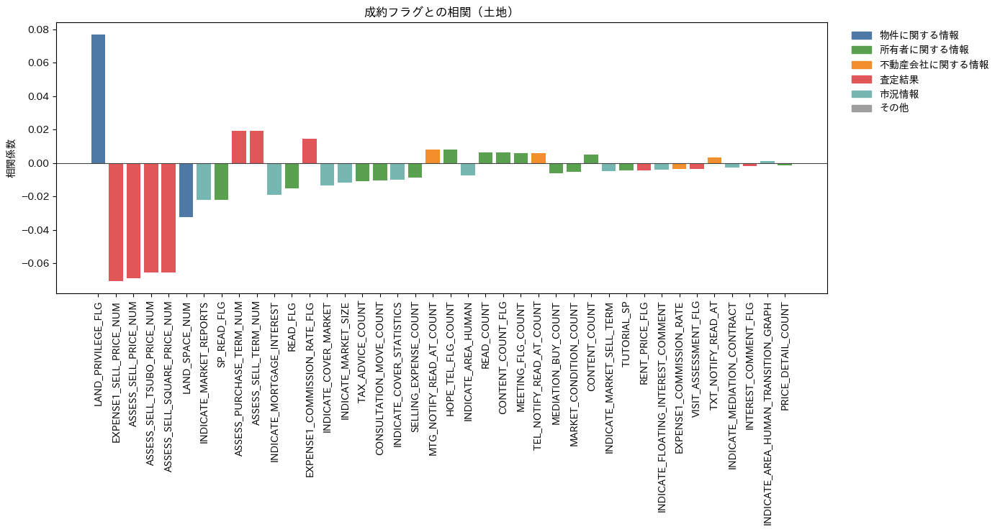

In [89]:


# ===== 2) カテゴリ定義（必要に応じて追記） =====
C_PROP   = '物件に関する情報'
C_OWNER  = '所有者に関する情報'
C_AGENT  = '不動産会社に関する情報'
C_RESULT = '査定結果'
C_MARKET = '市況情報'
C_OTHER  = 'その他'

# 画像の表に合わせて“明示的に”割り当てたい列をここで指定
EXPLICIT = {
    # 物件
    'OWNER_SPACE_NUM': C_PROP, 'FLOOR_NUMBER': C_PROP, 'BUILDING_AGE': C_PROP,
    'DIRECTION': C_PROP,'PROPERTY_KIND': C_PROP,'ABOUT_ADDRESS': C_PROP,
    'ABOUT_TRAFFIC': C_PROP, 'ABOUT_LAND_PRIVILEGE': C_PROP,
    'ABOUT_USAGE_AREA': C_PROP, 'ABOUT_STRUCTURE': C_PROP, 'BUILDING_AGE': C_PROP,
    'ABOUT_FLOOR': C_PROP, 'ABOUT_UNIT_AMOUNT': C_PROP,
    'ABOUT_SELLER': C_PROP,'LAND_PRIVILEGE_FLG': C_PROP,'BUILDING_AGE_BIN': C_PROP,

    # 査定結果
    'ASSESSED_ON': C_RESULT,'ASSESS_SELL_PRICE_NUM': C_RESULT, 
    'ASSESS_SELL_TSUBO_PRICE': C_RESULT, 'ASSESS_SELL_SQUARE_PRICE': C_RESULT,
    'ASSESS_SELL_TERM': C_RESULT, 'ASSESS_PURCHASE_TERM': C_RESULT,
    'RENT_PRICE_FLG': C_RESULT, 'EXPENSE1_SELL_PRICE': C_RESULT,
    'EXPENSE1_COMMISSION_RATE': C_RESULT, 'INTEREST_COMMENT_FLG': C_RESULT,
    'VISIT_ASSESSMENT_FLG': C_RESULT,
    'EXPENCE1_SELL_PRICE': C_RESULT,'EXPENSE1_COMMISSION_RATE_FLG': C_RESULT,
    # 市況
    'INDICATE_MARKET_REPORTS': C_MARKET, 'INDICATE_COVER_STATISTICS': C_MARKET,
    'INDICATE_PRICE_HISTORY': C_MARKET, 'INDICATE_PRICE_HISTORY_GRAPH': C_MARKET,
    'INDICATE_PRICE_HISTORY_SELF_COMPARE': C_MARKET, 'INDICATE_PRICE_HISTORY_AREA_COMPARE': C_MARKET,
    'INDICATE_AREA_HUMAN': C_MARKET, 'INDICATE_AREA_HUMAN_GRAPH': C_MARKET,
    'INDICATE_AREA_HUMAN_TRANSITION_GRAPH': C_MARKET, 'INDICATE_COVER_MARKET': C_MARKET,
    'INDICATE_MARKET_SIZE': C_MARKET, 'INDICATE_MARKET_SELL_TERM': C_MARKET,
    'INDICATE_MORTGAGE_INTEREST': C_MARKET, 'INDICATE_FLOATING_INTEREST_COMMENT': C_MARKET,
    'INDICATE_MEDIATION_CONTRACT': C_MARKET,
    # 不動産会社（接客/通知ログ系）
    'USER_ID': C_AGENT, 'THX_NOTIFY_READ_AT_COUNT': C_AGENT,'COVER_STAFF_AND_COMPANY_NAME': C_AGENT,
    'EXPENCE1_SELL_PRICE': C_AGENT, 'EXPENSE1_COMMISSION_RATE': C_AGENT,
    'TXT_NOTIFY_READ_AT': C_AGENT, 'MTG_NOTIFY_READ_AT_COUNT': C_AGENT,
    'TEL_NOTIFY_READ_AT_COUNT': C_AGENT,'USER_ID_3730_FLG': C_AGENT,
    # 所有者（必要なら追加）
    'SELLING_EXPENSE_COUNT': C_OWNER,'READ_FLG': C_OWNER,
    'MEDIATION_BUY_COUNT': C_OWNER, 'MARKET_CONDITION_COUNT': C_OWNER,
    'PRICE_DETAIL_COUNT': C_OWNER,'CONSULTATION_MOVE_COUNT': C_OWNER,
    'TUTORIAL_SP': C_OWNER,'READ_COUNT': C_OWNER, 'CONTENT_COUNT': C_OWNER, 
    'MEETING_FLG_COUNT': C_OWNER,'TAX_ADVICE_COUNT': C_OWNER,
    'HOPE_TEL_FLG_COUNT': C_OWNER,'THANKS_COUNT': C_OWNER,'CONTENT_COUNT_FLG': C_OWNER,'SP_READ_FLG': C_OWNER,
    # 迷うもの・未定義はその他に落とす
}

# ルール（接頭辞・含有語）での自動振り分け
def infer_category(col: str) -> str:
    if col in EXPLICIT: 
        return EXPLICIT[col]
    c = col.lower()
    if c.startswith('about_') or any(k in c for k in ['owner_space', 'floor_number', 'building_age', 'direction', 'land_space', 'building_space']):
        return C_PROP
    if c.startswith('assess') or c.startswith('expense'):
        return C_RESULT
    if c.startswith('indicate') or 'market' in c or 'price_history' in c:
        return C_MARKET
    if any(k in c for k in ['read', 'notify', 'content', 'meeting', 'consultation', 'advice', 'hope_tel', 'visit_assessment']):
        return C_AGENT
    if 'seller' in c or 'owner' in c:
        return C_OWNER
    return C_OTHER

# ===== 3) 可視化（色分けバー） =====
PALETTE = {
    C_PROP:   '#4E79A7',
    C_OWNER:  '#59A14F',
    C_AGENT:  '#F28E2B',
    C_RESULT: '#E15759',
    C_MARKET: '#76B7B2',
    C_OTHER:  '#9E9E9E'
}

def plot_corr_colored(corr_series: pd.Series, top_n=40, sort_abs=True, add_prefix=False):
    dfc = corr_series.rename('corr').to_frame()
    dfc['feature']  = dfc.index
    dfc['category'] = dfc['feature'].map(infer_category)
    if sort_abs:
        dfc = dfc.reindex(dfc['corr'].abs().sort_values(ascending=False).index)
    else:
        dfc = dfc.sort_values('corr', ascending=False)
    if top_n is not None:
        dfc = dfc.head(top_n)

    labels = (dfc['category'] + ':' + dfc['feature']) if add_prefix else dfc['feature']
    colors = dfc['category'].map(PALETTE)

    fig_h = max(3.0, 0.35 * len(dfc))
    plt.figure(figsize=(max(12, 0.35*len(dfc)), 7.5))
    plt.bar(range(len(dfc)), dfc['corr'].values, color=colors)
    plt.axhline(0, color='#444', linewidth=0.8)
    plt.xticks(range(len(dfc)), labels, rotation=90)
    plt.ylabel('相関係数')
    plt.title('成約フラグとの相関（土地）')

    # 凡例
    handles = [Patch(color=PALETTE[k], label=k) for k in [C_PROP, C_OWNER, C_AGENT, C_RESULT, C_MARKET, C_OTHER]]
    plt.legend(handles=handles, bbox_to_anchor=(1.02, 1), loc='upper left', frameon=False)

    plt.tight_layout()
    plt.show()

# 実行
plot_corr_colored(base, top_n=40, sort_abs=True, add_prefix=False)


In [90]:
# 相関係数の絶対値でソート → TOP10
top20 = (base.reindex(base.abs().sort_values(ascending=False).index)
              .head(20)
              .reset_index())

top20.columns = ["column", "correlation"]

# 小数点2桁に丸める
top20["correlation"] = top20["correlation"].round(2)

display(top20)

,column,correlation
0,LAND_PRIVILEGE_FLG,0.080
1,EXPENSE1_SELL_PRICE_NUM,-0.070
2,ASSESS_SELL_PRICE_NUM,-0.070
3,ASSESS_SELL_TSUBO_PRICE_NUM,-0.070
4,ASSESS_SELL_SQUARE_PRICE_NUM,-0.070
5,LAND_SPACE_NUM,-0.030
6,INDICATE_MARKET_REPORTS,-0.020
7,SP_READ_FLG,-0.020
8,ASSESS_PURCHASE_TERM_NUM,0.020
9,ASSESS_SELL_TERM_NUM,0.020


### 各説明変数と成約フラグとの関係（散布図・棒グラフの描画） ###

In [91]:
# 数値・バイナリ・カテゴリ列の定義
numeric_cols = [
    'LAND_SPACE_NUM',
    'ASSESS_SELL_PRICE_NUM',
    'ASSESS_SELL_SQUARE_PRICE_NUM',
    'ASSESS_SELL_TSUBO_PRICE_NUM',
    'ASSESS_SELL_TERM_NUM',
    'ASSESS_PURCHASE_TERM_NUM',
    'EXPENSE1_SELL_PRICE_NUM',
    'EXPENSE1_COMMISSION_RATE',
    'TUTORIAL_SP',
    'READ_COUNT',
    'CONTENT_COUNT',
    'PRICE_DETAIL_COUNT',
    'MEDIATION_BUY_COUNT',
    'MARKET_CONDITION_COUNT',
    'CONSULTATION_MOVE_COUNT',
    'TAX_ADVICE_COUNT',
    'SELLING_EXPENSE_COUNT',
    'THANKS_COUNT',
    'THX_NOTIFY_READ_AT_COUNT'
]

binary_cols  = [
    'LAND_PRIVILEGE_FLG',
    'VISIT_ASSESSMENT_FLG',
    'RENT_PRICE_FLG',
    'INDICATE_COVER_STATISTICS',
    'INDICATE_MARKET_REPORTS',
    'INDICATE_PRICE_HISTORY',
    'INDICATE_PRICE_HISTORY_GRAPH',
    'INDICATE_PRICE_HISTORY_SELF_COMPARE',
    'INDICATE_PRICE_HISTORY_AREA_COMPARE',
    'INDICATE_AREA_HUMAN',
    'INDICATE_AREA_HUMAN_AGE_GRAPH',
    'INDICATE_AREA_HUMAN_TRANSITION_GRAPH',
    'INDICATE_COVER_MARKET',
    'INDICATE_MARKET_SIZE',
    'INDICATE_MARKET_SELL_TERM',
    'INDICATE_MORTGAGE_INTEREST',
    'INDICATE_FLOATING_INTEREST_COMMENT',
    'INTEREST_COMMENT_FLG',
    'INDICATE_MEDIATION_CONTRACT',
    'EXPENSE1_COMMISSION_RATE_FLG',
    'SP_READ_FLG',
    'READ_FLG',
    'CONTENT_COUNT_FLG',
    'TXT_NOTIFY_READ_AT',
    'HOPE_TEL_FLG_COUNT',
    'TEL_NOTIFY_READ_AT_COUNT',
    'MEETING_FLG_COUNT',
    'MTG_NOTIFY_READ_AT_COUNT'
]
categorical_cols = [
    'PREFECTURE',
    'REGION',
    'USAGE_AREA_REP'
]

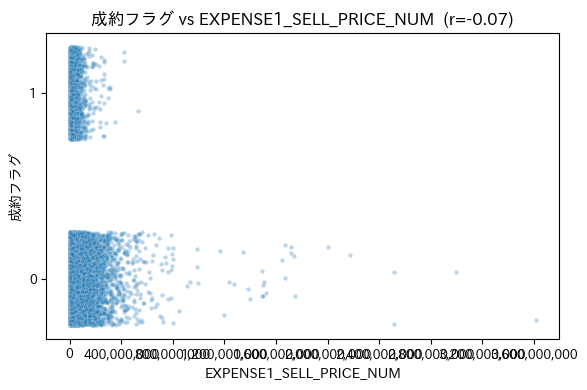

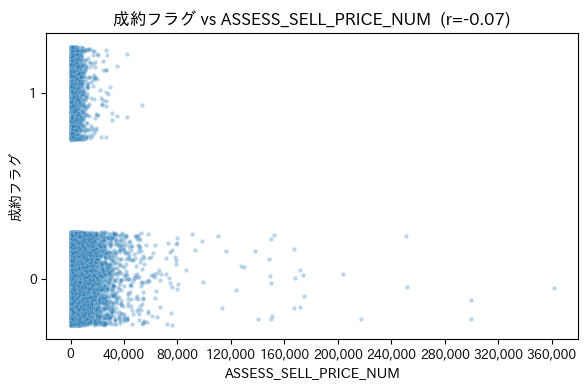

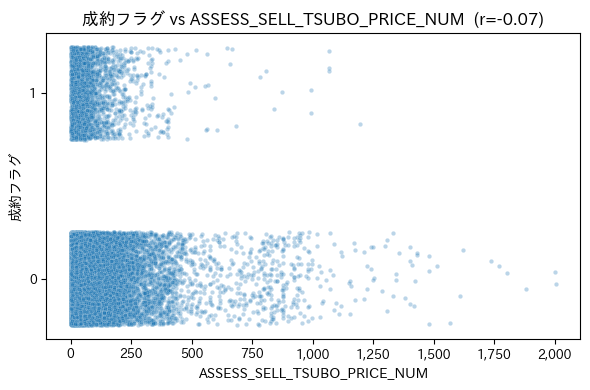

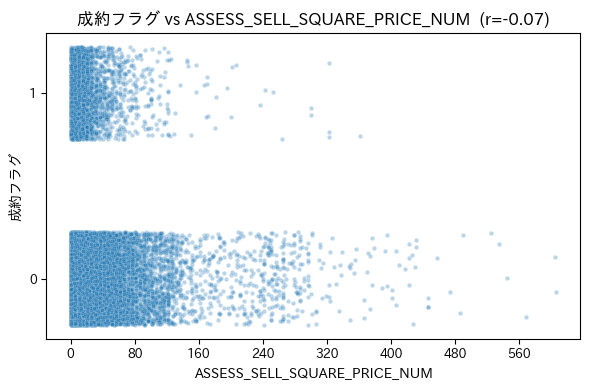

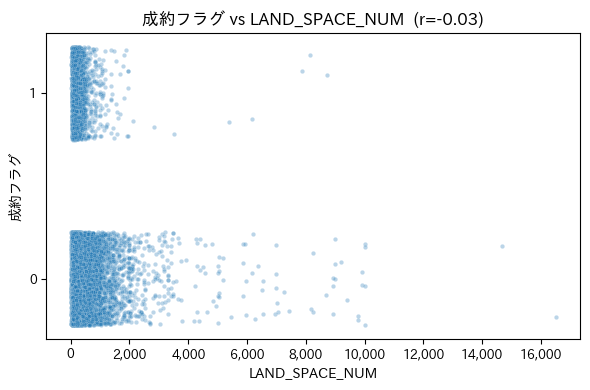

...

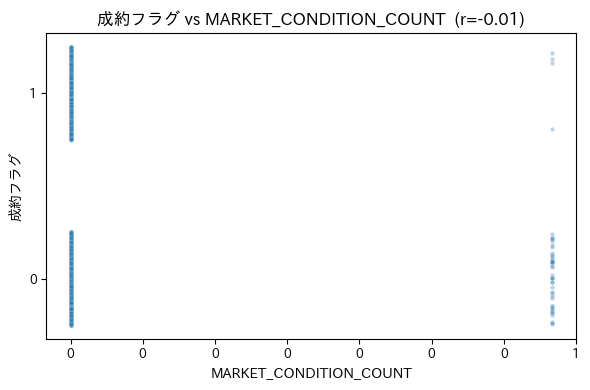

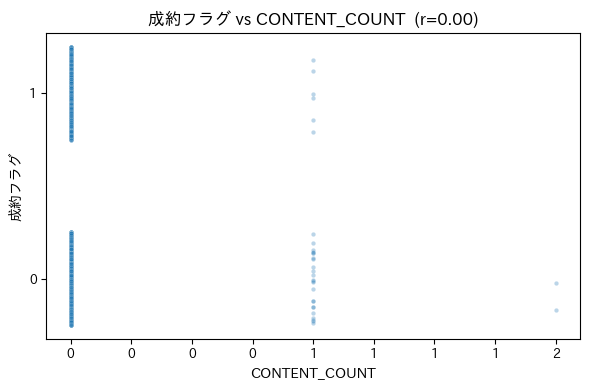

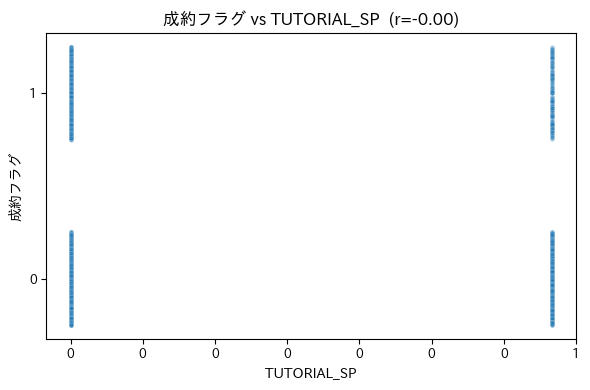

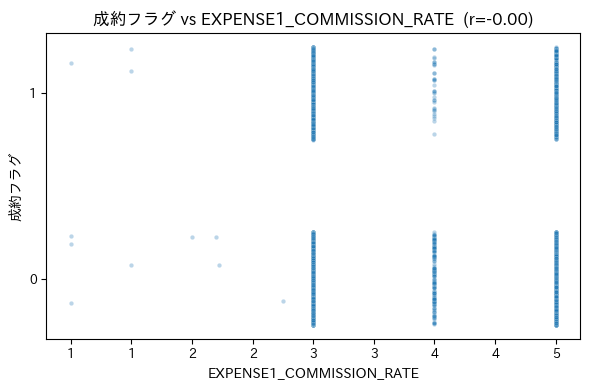

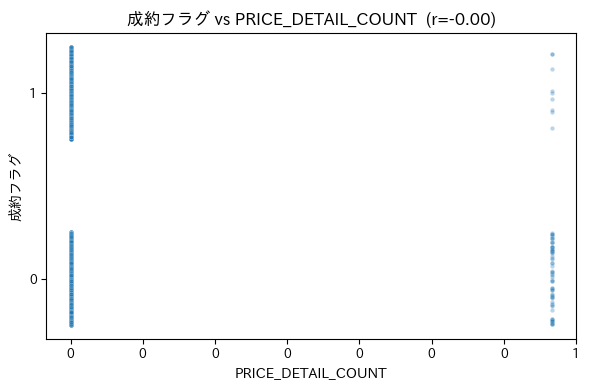


=== LAND_PRIVILEGE_FLG vs 成約フラグ ===
成約フラグ                  0     1  成約率差分(1-0)
LAND_PRIVILEGE_FLG                        
0                  0.946 0.054       0.085
1                  0.862 0.138       0.085


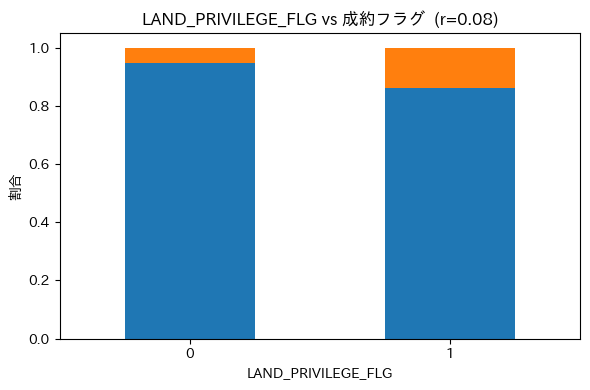


=== INDICATE_MARKET_REPORTS vs 成約フラグ ===
成約フラグ                       0     1  成約率差分(1-0)
INDICATE_MARKET_REPORTS                        
0                       0.861 0.139      -0.015
1                       0.876 0.124      -0.015


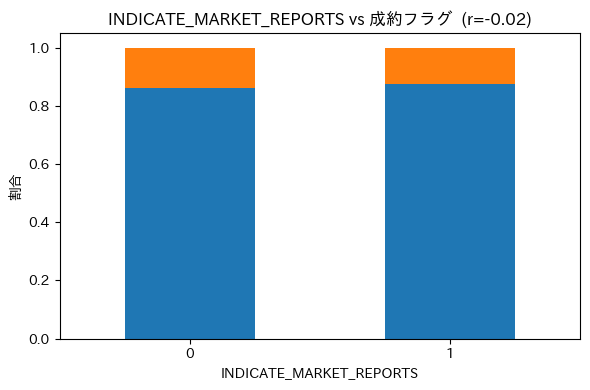


=== SP_READ_FLG vs 成約フラグ ===
成約フラグ           0     1  成約率差分(1-0)
SP_READ_FLG                        
0           0.869 0.131      -0.037
1           0.906 0.094      -0.037


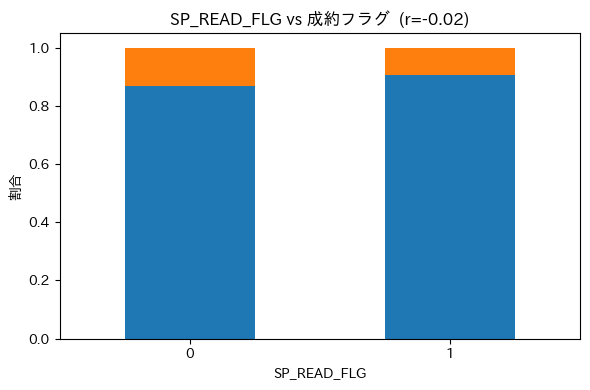


=== INDICATE_MORTGAGE_INTEREST vs 成約フラグ ===
成約フラグ                          0     1  成約率差分(1-0)
INDICATE_MORTGAGE_INTEREST                        
0                          0.808 0.192      -0.063
1                          0.871 0.129      -0.063


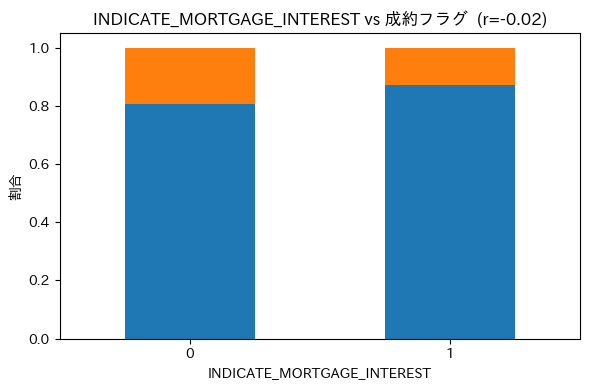


=== READ_FLG vs 成約フラグ ===
成約フラグ        0     1  成約率差分(1-0)
READ_FLG                        
0        0.869 0.131      -0.016
1        0.884 0.116      -0.016


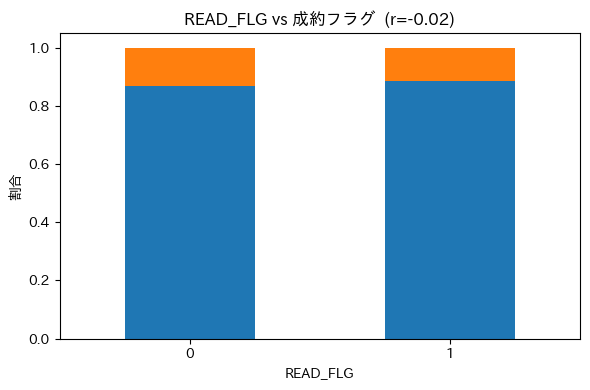


=== EXPENSE1_COMMISSION_RATE_FLG vs 成約フラグ ===
成約フラグ                            0     1  成約率差分(1-0)
EXPENSE1_COMMISSION_RATE_FLG                        
0                            0.879 0.121       0.011
1                            0.868 0.132       0.011


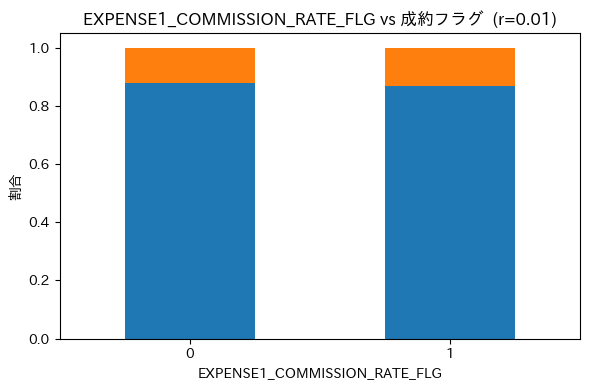


=== INDICATE_COVER_MARKET vs 成約フラグ ===
成約フラグ                     0     1  成約率差分(1-0)
INDICATE_COVER_MARKET                        
0                     0.776 0.224      -0.095
1                     0.871 0.129      -0.095


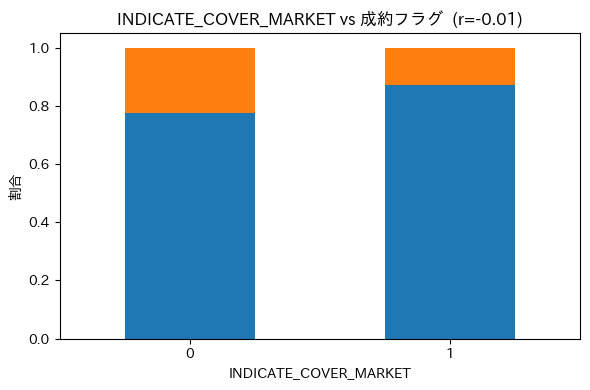


=== INDICATE_MARKET_SIZE vs 成約フラグ ===
成約フラグ                    0     1  成約率差分(1-0)
INDICATE_MARKET_SIZE                        
0                    0.817 0.183      -0.054
1                    0.871 0.129      -0.054


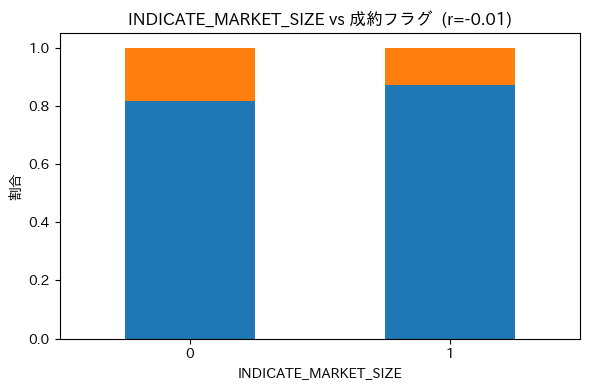


=== INDICATE_COVER_STATISTICS vs 成約フラグ ===
成約フラグ                         0     1  成約率差分(1-0)
INDICATE_COVER_STATISTICS                        
0                         0.812 0.188      -0.058
1                         0.871 0.129      -0.058


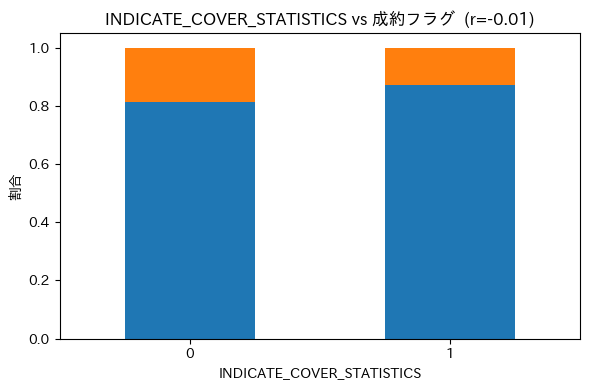


=== MTG_NOTIFY_READ_AT_COUNT vs 成約フラグ ===
成約フラグ                        0     1  成約率差分(1-0)
MTG_NOTIFY_READ_AT_COUNT                        
0                        0.870 0.130       0.120
1                        0.750 0.250       0.120


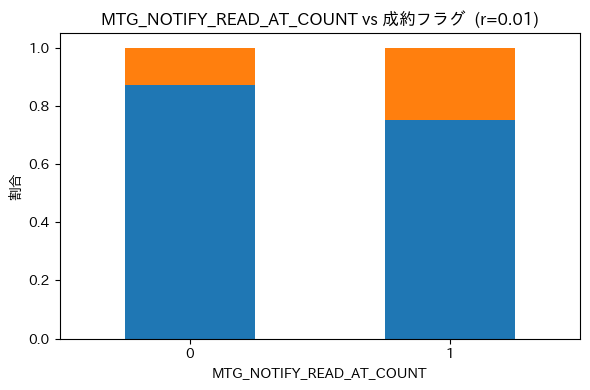


=== HOPE_TEL_FLG_COUNT vs 成約フラグ ===
成約フラグ                  0     1  成約率差分(1-0)
HOPE_TEL_FLG_COUNT                        
0                  0.870 0.130       0.120
1                  0.750 0.250       0.120


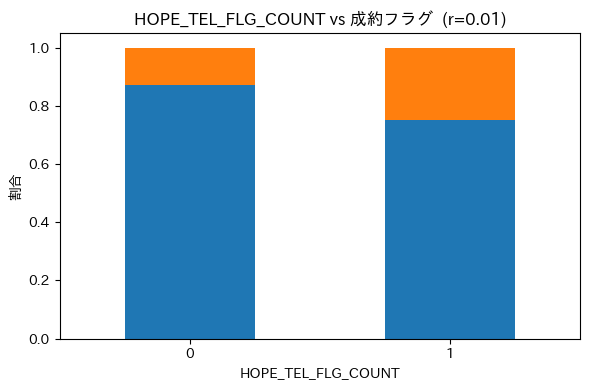


=== INDICATE_AREA_HUMAN vs 成約フラグ ===
成約フラグ                   0     1  成約率差分(1-0)
INDICATE_AREA_HUMAN                        
0                   0.844 0.156      -0.027
1                   0.871 0.129      -0.027


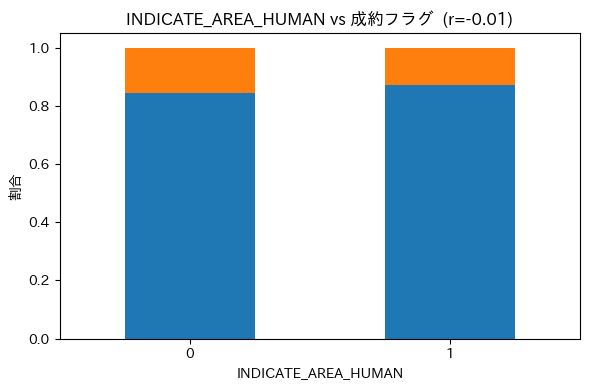


=== CONTENT_COUNT_FLG vs 成約フラグ ===
成約フラグ                 0     1  成約率差分(1-0)
CONTENT_COUNT_FLG                        
0                 0.870 0.130       0.058
1                 0.812 0.188       0.058


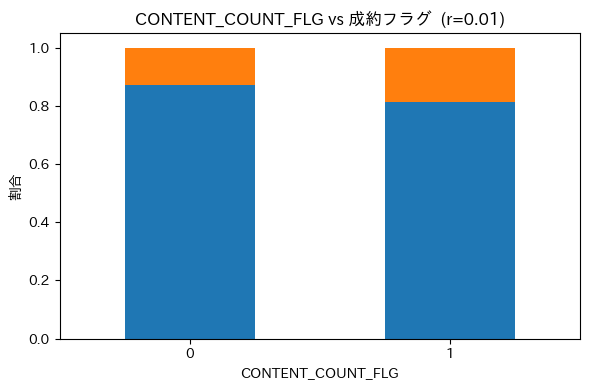


=== MEETING_FLG_COUNT vs 成約フラグ ===
成約フラグ                 0     1  成約率差分(1-0)
MEETING_FLG_COUNT                        
0                 0.870 0.130       0.085
1                 0.786 0.214       0.085


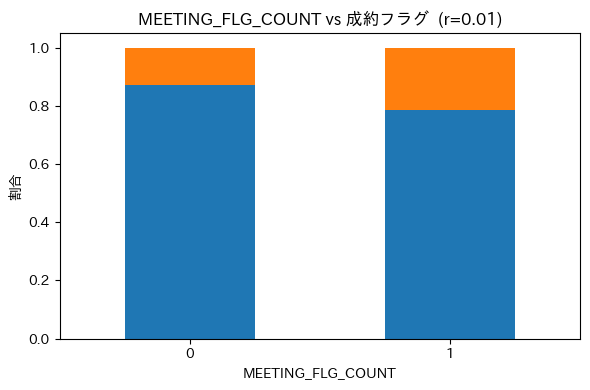


=== TEL_NOTIFY_READ_AT_COUNT vs 成約フラグ ===
成約フラグ                        0     1  成約率差分(1-0)
TEL_NOTIFY_READ_AT_COUNT                        
0                        0.870 0.130       0.085
1                        0.786 0.214       0.085


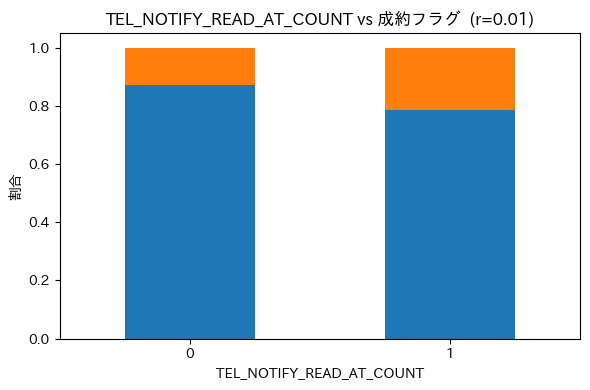


=== INDICATE_MARKET_SELL_TERM vs 成約フラグ ===
成約フラグ                         0     1  成約率差分(1-0)
INDICATE_MARKET_SELL_TERM                        
0                         0.851 0.149      -0.019
1                         0.871 0.129      -0.019


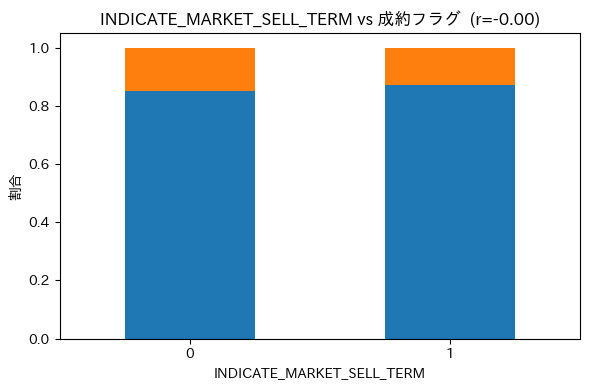


=== RENT_PRICE_FLG vs 成約フラグ ===
成約フラグ              0     1  成約率差分(1-0)
RENT_PRICE_FLG                        
0              0.870 0.130      -0.130
1              1.000 0.000      -0.130


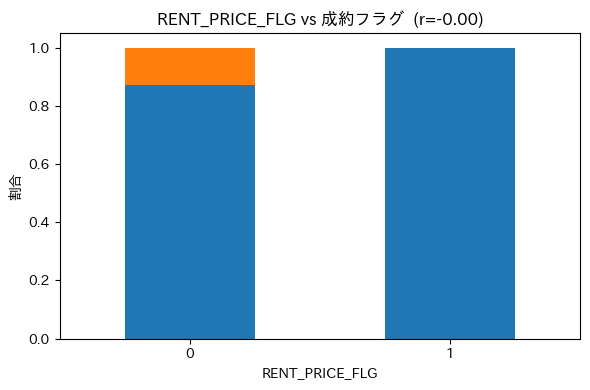


=== INDICATE_FLOATING_INTEREST_COMMENT vs 成約フラグ ===
成約フラグ                                  0     1  成約率差分(1-0)
INDICATE_FLOATING_INTEREST_COMMENT                        
0                                  0.840 0.160      -0.030
1                                  0.870 0.130      -0.030


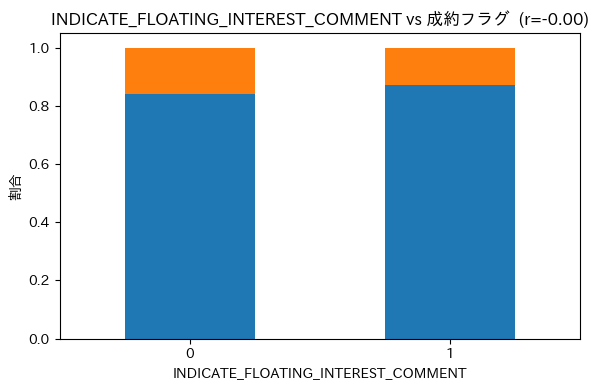


=== VISIT_ASSESSMENT_FLG vs 成約フラグ ===
成約フラグ                    0     1  成約率差分(1-0)
VISIT_ASSESSMENT_FLG                        
0                    0.870 0.130      -0.130
1                    1.000 0.000      -0.130


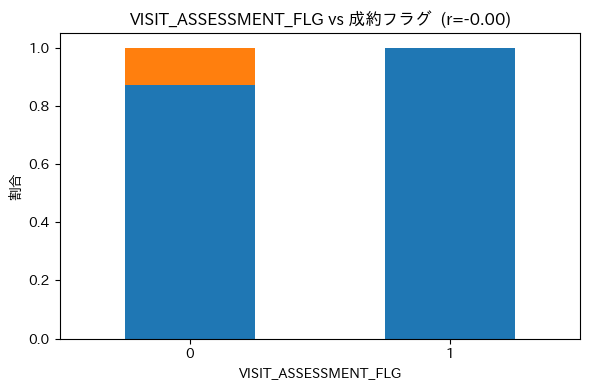


=== TXT_NOTIFY_READ_AT vs 成約フラグ ===
成約フラグ                  0     1  成約率差分(1-0)
TXT_NOTIFY_READ_AT                        
0.000              0.870 0.130       0.032
1.000              0.839 0.161       0.032


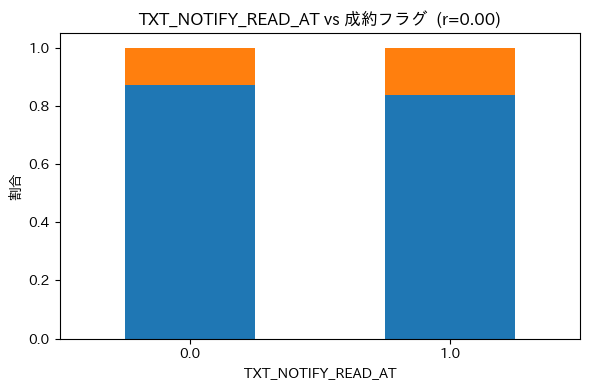


=== INDICATE_MEDIATION_CONTRACT vs 成約フラグ ===
成約フラグ                           0     1  成約率差分(1-0)
INDICATE_MEDIATION_CONTRACT                        
0                           0.860 0.140      -0.010
1                           0.870 0.130      -0.010


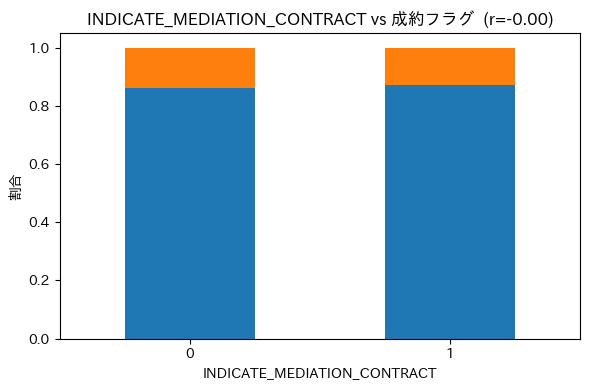


=== INTEREST_COMMENT_FLG vs 成約フラグ ===
成約フラグ                    0     1  成約率差分(1-0)
INTEREST_COMMENT_FLG                        
0                    0.870 0.130      -0.001
1                    0.871 0.129      -0.001


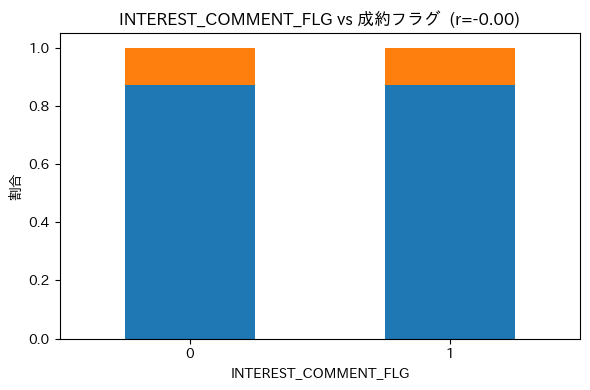


=== INDICATE_AREA_HUMAN_TRANSITION_GRAPH vs 成約フラグ ===
成約フラグ                                    0     1  成約率差分(1-0)
INDICATE_AREA_HUMAN_TRANSITION_GRAPH                        
0                                    0.885 0.115       0.014
1                                    0.870 0.130       0.014


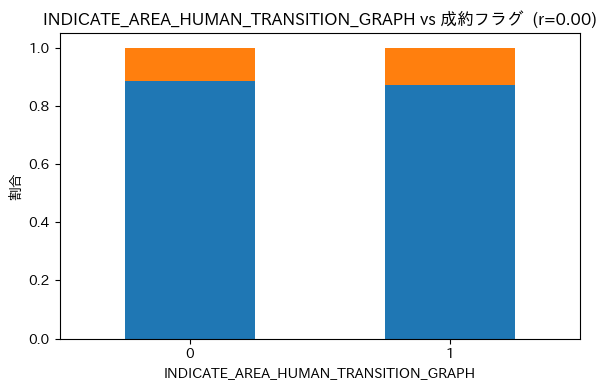


=== INDICATE_AREA_HUMAN_AGE_GRAPH vs 成約フラグ ===
成約フラグ                             0     1  成約率差分(1-0)
INDICATE_AREA_HUMAN_AGE_GRAPH                        
0                             0.880 0.120       0.010
1                             0.870 0.130       0.010


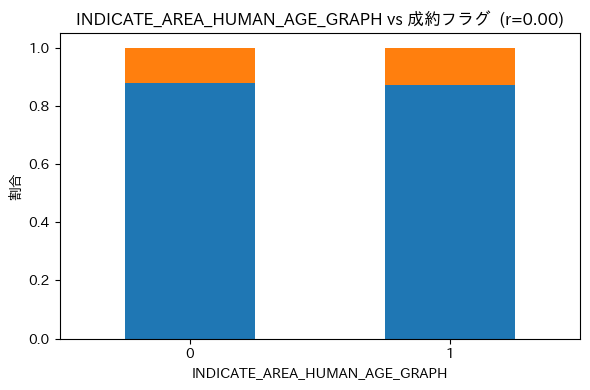


=== binary_cols まとめ表 ===


,カラム,成約率(0),成約率(1),差分(1-0),相関係数
0,LAND_PRIVILEGE_FLG,0.054,0.138,0.085,0.077
1,INDICATE_MARKET_REPORTS,0.139,0.124,-0.015,-0.022
2,SP_READ_FLG,0.131,0.094,-0.037,-0.022
3,INDICATE_MORTGAGE_INTEREST,0.192,0.129,-0.063,-0.019
4,READ_FLG,0.131,0.116,-0.016,-0.015
5,EXPENSE1_COMMISSION_RATE_FLG,0.121,0.132,0.011,0.014
6,INDICATE_COVER_MARKET,0.224,0.129,-0.095,-0.014
7,INDICATE_MARKET_SIZE,0.183,0.129,-0.054,-0.012
8,INDICATE_COVER_STATISTICS,0.188,0.129,-0.058,-0.010
9,MTG_NOTIFY_READ_AT_COUNT,0.130,0.250,0.120,0.008



=== PREFECTURE のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
PREFECTURE,,,,
北海道,941,0.827,0.173,17.300
青森県,6,0.833,0.167,16.700
岩手県,74,0.784,0.216,21.600
宮城県,275,0.742,0.258,25.800
秋田県,6,1.000,0.000,0.000
山形県,64,0.891,0.109,10.900
福島県,147,0.884,0.116,11.600
茨城県,637,0.846,0.154,15.400
栃木県,197,0.848,0.152,15.200


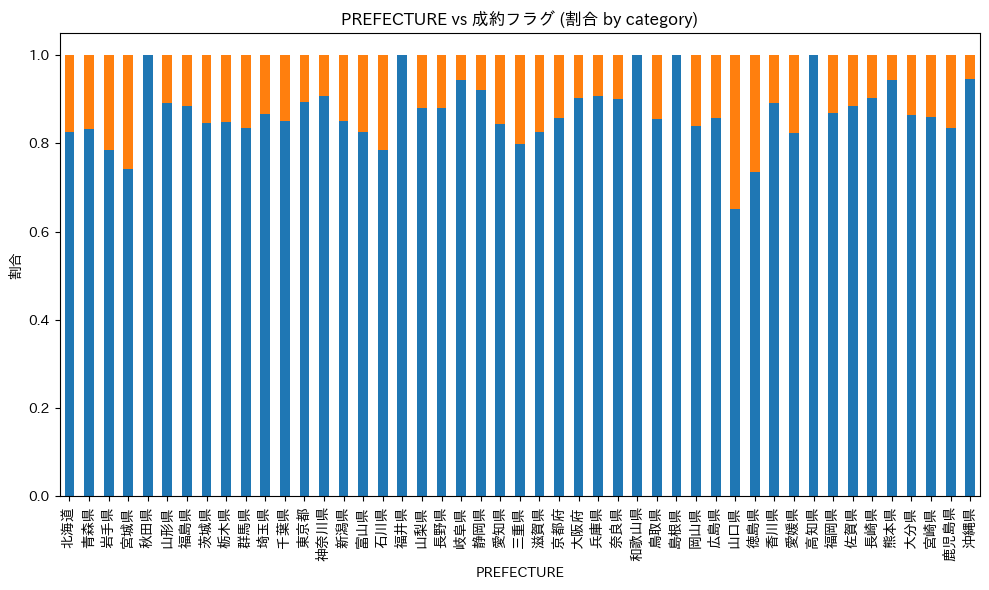


=== REGION のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
REGION,,,,
北海道,941,0.827,0.173,17.300
東北,572,0.804,0.196,19.600
関東,13423,0.880,0.120,12.000
中部,3533,0.853,0.147,14.700
近畿,1837,0.880,0.120,12.000
中国,725,0.847,0.153,15.300
四国,585,0.827,0.173,17.300
九州,2868,0.879,0.121,12.100
沖縄,150,0.947,0.053,5.300


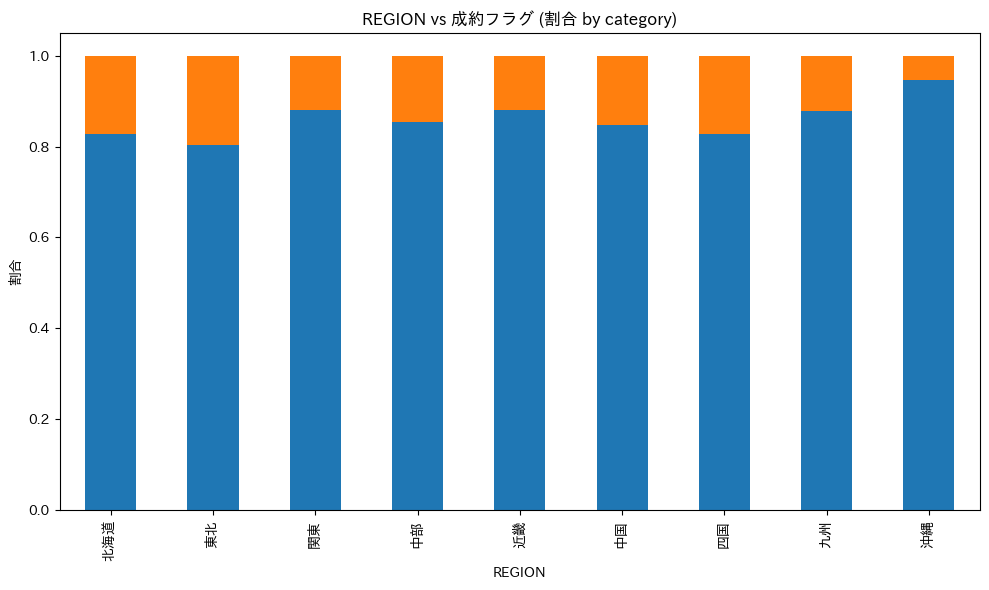


=== USAGE_AREA_REP のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
USAGE_AREA_REP,,,,
第一種低層住居専用地域,6358,0.839,0.161,16.100
第二種低層住居専用地域,166,0.867,0.133,13.300
第一種中高層住居専用地域,3146,0.881,0.119,11.900
第二種中高層住居専用地域,1453,0.889,0.111,11.100
第一種住居地域,4896,0.868,0.132,13.200
第二種住居地域,746,0.867,0.133,13.300
準住居地域,208,0.923,0.077,7.700
近隣商業地域,1072,0.884,0.116,11.600
商業地域,957,0.920,0.080,8.000


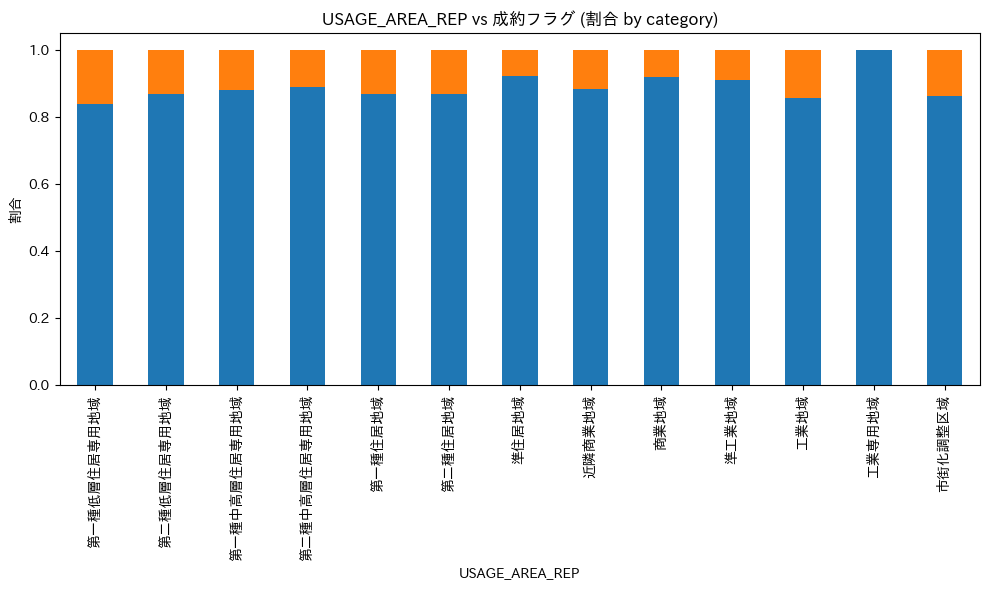

In [92]:
# 散布図・割合棒グラフ可視化
visualize_with_base(df_l, base, target="成約フラグ", top_n=100)

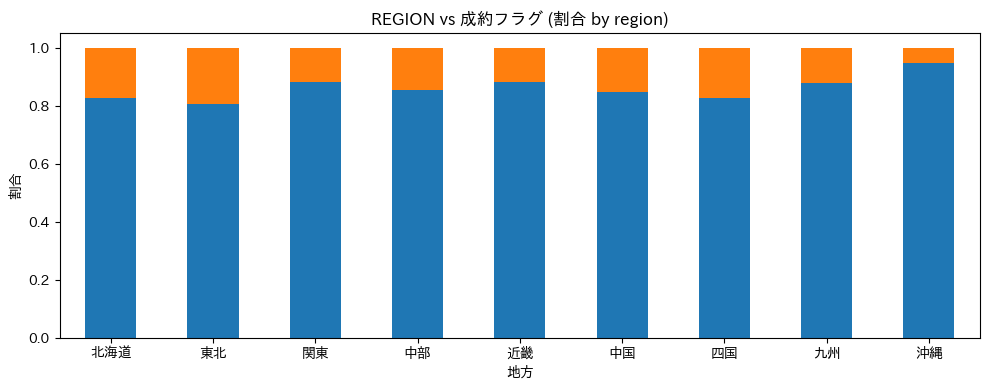

In [93]:
target="成約フラグ"
ct = pd.crosstab(df_l["REGION"], df_l[target], normalize="index")
region_order = ['北海道', '東北', '関東', '中部', '近畿', '中国', '四国', '九州', '沖縄']
ct = ct.reindex(region_order)

ax = ct.plot(kind="bar", stacked=True, figsize=(10, 4))
plt.title(f"REGION vs {target} (割合 by region)")
plt.ylabel("割合")
plt.xlabel("地方")
plt.xticks(rotation=0)
ax.get_legend().remove()
plt.tight_layout()
plt.show()

### カテゴリ変数の件数分布 ###

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


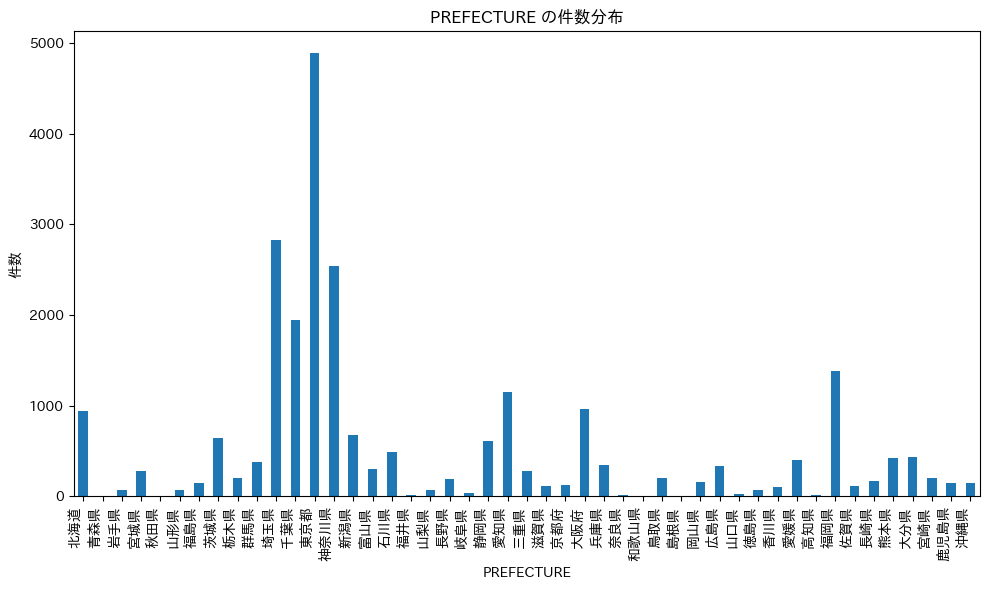

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


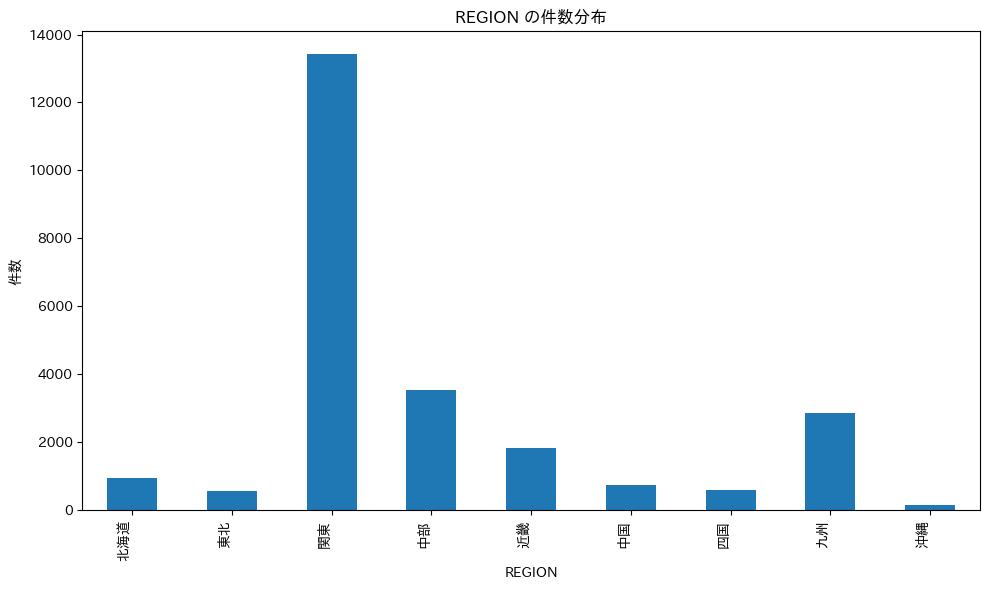

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


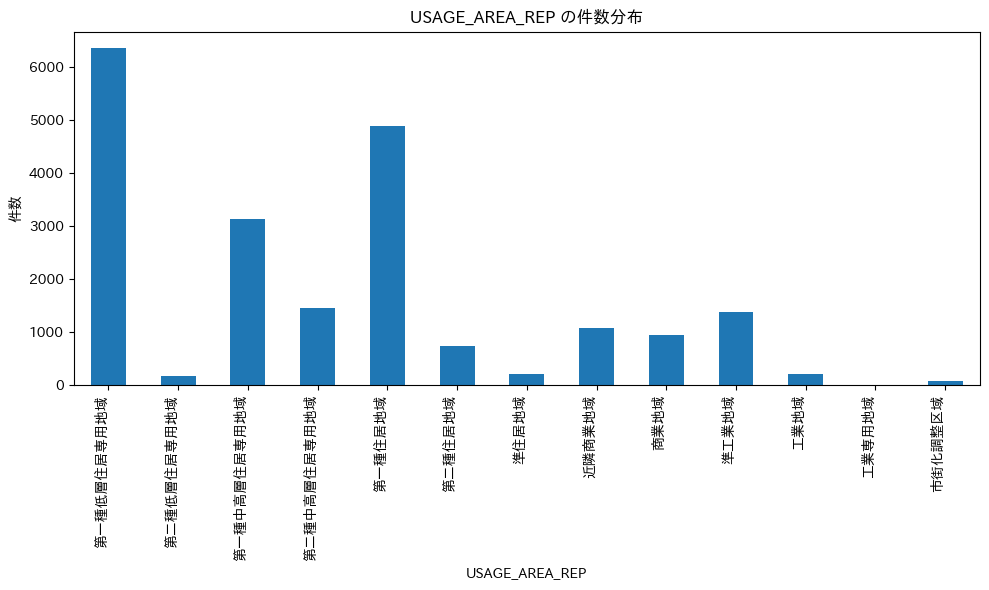

In [94]:
plot_categorical_distribution(df_l, categorical_cols)

### 欠損率の算出・保存 ###

In [95]:
# 関数の結果を変数に格納
missing_info = check_missing_info(df_l)

# CSVとして出力
missing_info.to_csv(os.path.join(OUTPUT_DIR, "missing_info_l.csv"), index=False, encoding="utf-8-sig")

### 考察(土地) ###

基本は相関係数の順番で関係はありそう  
・CONTENT_COUNTは現時点で相関はない。フラグ化をしても厳しそう、、、  
**----------------------------------------------------------**  
→→→基本は相関係数上位を特徴量として検討。CONTENT_COUNTは一応フラグ化して相関を見る

**【バイナリ変数について】**  
相関係数が小さい/0.0であっても、0と1で割合の差分が大きいものもあった  
◾️相関係数が0.01以上あるが、割合の差分かかなり小さい  
・RENT_PRICE_FLG  
・INTEREST_COMMENT_FLG  
は特徴量として入れても無意味  

◾️相関係数は0.00だが、割合の差分が3.5%以上ある  
・VISIT_ASSESSMENT_FLG  
は特徴量に入れた方が良い可能性  
**----------------------------------------------------------**  
→→→基本は相関係数上位を特徴量として検討。一部変数について特徴量に追加を検討  

**【カテゴリ変数について】**   
・USER_IDについては、そもそも頻出のUSER_IDでも件数が500件に満たない。
比較的多いUSER_IDについて、成約率も他のUSER_IDと比較してもあまり変化はないので、特徴量にするのは難しい
・都道府県別では、成約割合が高い/低い都道府県は全体に占める件数も少ない    
・地方別でも都道府県と同様で、比較的成約割合が高い/低い地方は全体に占める件数も少ない       
・用途地域については、第一種低層住居専用地域について、他より若干成約割合が高いかつ、全体に占める件数も多かった。特徴量として使える可能性がある。
（第一種低層住居専用地域は用途制限は厳しいが基本的に住環境がよく、人気である→成約率高い可能性）
**----------------------------------------------------------**  
→→→用途地域については特徴量として検討  





## 戸建 ##

### 前処理 ###

In [96]:
df_h['LAND_SPACE_NUM'] = (
    df_h['LAND_SPACE']
    .astype(str)
    .str.extract(r'([0-9]+(?:\.[0-9]+)?)')
    .astype(float)
)

df_h['BUILDING_SPACE_NUM'] = (
    df_h['BUILDING_SPACE']
    .astype(str)
    .str.extract(r'([0-9]+(?:\.[0-9]+)?)')
    .astype(float)
)

df_h[['LAND_SPACE', 'LAND_SPACE_NUM',
       'BUILDING_SPACE', 'BUILDING_SPACE_NUM']].head(10)

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/2609554050.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_h['LAND_SPACE_NUM'] = (
/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/2609554050.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_h['BUILDING_SPACE_NUM'] = (


,LAND_SPACE,LAND_SPACE_NUM,BUILDING_SPACE,BUILDING_SPACE_NUM
3,225.000,225.000,139.000,139.000
4,330.000,330.000,130.000,130.000
5,218.880,218.880,110.130,110.130
6,165.300,165.300,165.300,165.300
7,246.690,246.690,165.000,165.000
9,197.640,197.640,113.550,113.550
11,197.640,197.640,113.550,113.550
12,107.920,107.920,95.230,95.230
13,140.000,140.000,140.000,140.000
17,200.000,200.000,100.000,100.000


In [97]:
# もともと欠損していないのに、抽出後はNaNになったものを抽出
mask = df_h['LAND_SPACE'].notna() & df_h['LAND_SPACE_NUM'].isna()
problematic_rows = df_h.loc[mask, 'LAND_SPACE']

print("=== LAND_SPACE では値あり、LAND_SPACE_NUM で NaN になった例 ===")
print(problematic_rows.unique()[:50])  # 例として最大50種類だけ表示


=== LAND_SPACE では値あり、LAND_SPACE_NUM で NaN になった例 ===
[]


In [98]:
# もともと欠損していないのに、抽出後はNaNになったものを抽出
mask = df_h['BUILDING_SPACE'].notna() & df_h['BUILDING_SPACE_NUM'].isna()
problematic_rows = df_h.loc[mask, 'BUILDING_SPACE']

print("=== BUILDING_SPACE では値あり、BUILDING_SPACE_NUM で NaN になった例 ===")
print(problematic_rows.unique()[:50])  # 例として最大50種類だけ表示


=== BUILDING_SPACE では値あり、BUILDING_SPACE_NUM で NaN になった例 ===
[]


In [99]:

# def to_avg_number_series(s: pd.Series) -> pd.Series:
#     # 1) 文字前処理（全角→半角、カンマ/空白除去）
#     t = s.astype(str).map(lambda x: unicodedata.normalize('NFKC', x))\
#                      .str.replace(',', '', regex=False).str.strip()

#     # 2) 範囲（a〜b / a～b / a-b / a~b など）を抽出して平均
#     #    区切りは [~\-–—〜～]、前後の空白は許容
#     pat = r'^\s*(?P<a>\d+(?:\.\d+)?)\s*[~\-–—〜～]\s*(?P<b>\d+(?:\.\d+)?)\s*$'
#     rng = t.str.extract(pat)
#     rng_avg = rng.astype(float).mean(axis=1)  # 両端の平均

#     # 3) 単一値（純粋な数値）を抽出
#     single = pd.to_numeric(t, errors='coerce')

#     # 4) 範囲が取れたところは平均、そうでなければ単一値
#     return rng_avg.fillna(single)

# # 適用（SettingWithCopyWarning を避けるため loc を使う）
# df_h.loc[:, 'ASSESS_RENT_PRICE_NUM']  = to_avg_number_series(df_h['ASSESS_RENT_PRICE'])
# df_h.loc[:, 'ASSESS_SELL_PRICE_NUM']  = to_avg_number_series(df_h['ASSESS_SELL_PRICE'])
# df_h.loc[:, 'ASSESS_SELL_SQUARE_PRICE_NUM']  = to_avg_number_series(df_h['ASSESS_SELL_SQUARE_PRICE'])
# df_h.loc[:, 'ASSESS_SELL_TSUBO_PRICE_NUM']  = to_avg_number_series(df_h['ASSESS_SELL_TSUBO_PRICE'])
# df_h.loc[:, 'ASSESS_SELL_TERM_NUM']  = to_avg_number_series(df_h['ASSESS_SELL_TERM'])
# df_h.loc[:, 'ASSESS_PURCHASE_TERM_NUM']  = to_avg_number_series(df_h['ASSESS_PURCHASE_TERM'])
# df_h.loc[:, 'EXPENSE1_SELL_PRICE_NUM']  = to_avg_number_series(df_h['EXPENSE1_SELL_PRICE'])

# 'ASSESS_RENT_PRICE','ASSESS_SELL_PRICE','ASSESS_SELL_SQUARE_PRICE','ASSESS_SELL_TSUBO_PRICE','ASSESS_SELL_TERM','ASSESS_PURCHASE_TERM','EXPENSE1_SELL_PRICE'
# # 確認
# df_h[['ASSESS_RENT_PRICE', 'ASSESS_RENT_PRICE_NUM',
#     'ASSESS_SELL_PRICE_NUM', 'ASSESS_SELL_PRICE_NUM',
#     'ASSESS_SELL_SQUARE_PRICE_NUM', 'ASSESS_SELL_SQUARE_PRICE',
#     'ASSESS_SELL_TSUBO_PRICE_NUM', 'ASSESS_SELL_TSUBO_PRICE',
#     'ASSESS_SELL_TERM_NUM', 'ASSESS_SELL_TERM',
#     'ASSESS_PURCHASE_TERM_NUM', 'ASSESS_PURCHASE_TERM', 
#     'EXPENSE1_SELL_PRICE_NUM', 'EXPENSE1_SELL_PRICE']].head(10)

In [100]:
# 適用（SettingWithCopyWarning を避けるため loc を使う）
df_h.loc[:, 'ASSESS_RENT_PRICE_NUM']        = to_avg_number_series(df_h['ASSESS_RENT_PRICE'])
df_h.loc[:, 'ASSESS_SELL_PRICE_NUM']        = to_avg_number_series(df_h['ASSESS_SELL_PRICE'])
df_h.loc[:, 'ASSESS_SELL_SQUARE_PRICE_NUM'] = to_avg_number_series(df_h['ASSESS_SELL_SQUARE_PRICE'])
df_h.loc[:, 'ASSESS_SELL_TSUBO_PRICE_NUM']  = to_avg_number_series(df_h['ASSESS_SELL_TSUBO_PRICE'])
df_h.loc[:, 'ASSESS_SELL_TERM_NUM']         = to_avg_number_series(df_h['ASSESS_SELL_TERM'])
df_h.loc[:, 'ASSESS_PURCHASE_TERM_NUM']     = to_avg_number_series(df_h['ASSESS_PURCHASE_TERM'])
df_h.loc[:, 'EXPENSE1_SELL_PRICE_NUM']      = to_avg_number_series(df_h['EXPENSE1_SELL_PRICE'])

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/2959132596.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_h.loc[:, 'ASSESS_RENT_PRICE_NUM']        = to_avg_number_series(df_h['ASSESS_RENT_PRICE'])
/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/2959132596.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_h.loc[:, 'ASSESS_SELL_PRICE_NUM']        = to_avg_number_series(df_h['ASSESS_SELL_PRICE'])
/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/295

In [101]:
#元カラムではNaNではなかったのに、数値化後カラムではNaNになってしまったものを確認

# 対象の「元カラム → 数値化後カラム」ペアを定義
pairs = [
    ('ASSESS_RENT_PRICE',        'ASSESS_RENT_PRICE_NUM'),
    ('ASSESS_SELL_PRICE',        'ASSESS_SELL_PRICE_NUM'),
    ('ASSESS_SELL_SQUARE_PRICE', 'ASSESS_SELL_SQUARE_PRICE_NUM'),
    ('ASSESS_SELL_TSUBO_PRICE',  'ASSESS_SELL_TSUBO_PRICE_NUM'),
    ('ASSESS_SELL_TERM',         'ASSESS_SELL_TERM_NUM'),
    ('ASSESS_PURCHASE_TERM',     'ASSESS_PURCHASE_TERM_NUM'),
    ('EXPENSE1_SELL_PRICE',      'EXPENSE1_SELL_PRICE_NUM'),
]

# 1) 件数サマリ
rows = []
for src, num in pairs:
    mask = df_h[src].notna() & df_h[num].isna()
    rows.append({
        'src_col': src,
        'num_col': num,
        'n_problem': int(mask.sum()),
        'n_unique_problem_values': int(df_h.loc[mask, src].nunique(dropna=True))
    })
summary_parse_fail = pd.DataFrame(rows).sort_values('n_problem', ascending=False).reset_index(drop=True)
print("=== 変換失敗（元値あり→数値NaN） 件数サマリ ===")
print(summary_parse_fail)

# 2) 各列の「問題となった元値」を上位例で確認（value_counts 上位20）
for src, num in pairs:
    mask = df_h[src].notna() & df_h[num].isna()
    if mask.any():
        print(f"\n=== {src} → {num} 変換失敗: {mask.sum()}件 ===")
        # 問題となった値の上位20種を表示（頻度順）
        print(df_h.loc[mask, src].astype(str).value_counts().head(20))


=== 変換失敗（元値あり→数値NaN） 件数サマリ ===
                    src_col                       num_col  n_problem  \
0          ASSESS_SELL_TERM          ASSESS_SELL_TERM_NUM       3711   
1   ASSESS_SELL_TSUBO_PRICE   ASSESS_SELL_TSUBO_PRICE_NUM        131   
2  ASSESS_SELL_SQUARE_PRICE  ASSESS_SELL_SQUARE_PRICE_NUM        122   
3         ASSESS_SELL_PRICE         ASSESS_SELL_PRICE_NUM         33   
4      ASSESS_PURCHASE_TERM      ASSESS_PURCHASE_TERM_NUM         12   
5         ASSESS_RENT_PRICE         ASSESS_RENT_PRICE_NUM          4   
6       EXPENSE1_SELL_PRICE       EXPENSE1_SELL_PRICE_NUM          1   

   n_unique_problem_values  
0                       20  
1                        1  
2                        1  
3                       12  
4                        7  
5                        4  
6                        1  

=== ASSESS_RENT_PRICE → ASSESS_RENT_PRICE_NUM 変換失敗: 4件 ===
ASSESS_RENT_PRICE
aaaa    1
自由入力    1
要内見     1
〇〇      1
Name: count, dtype: int64

=== ASSESS_SELL

In [102]:

def extract_floor_number(s):
    if pd.isna(s):
        return np.nan
    # 「〇階」の数字部分だけ抽出
    m = re.search(r'(\d+)\s*階', str(s))
    if m:
        return int(m.group(1))
    return np.nan

df_h['ABOUT_FLOOR_NUM'] = df_h['ABOUT_FLOOR'].apply(extract_floor_number)
# 確認
print(df_h[['ABOUT_FLOOR', 'ABOUT_FLOOR_NUM']].head())


  ABOUT_FLOOR  ABOUT_FLOOR_NUM
3         2階建            2.000
4         2階建            2.000
5         2階建            2.000
6         2階建            2.000
7         2階建            2.000


/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/1492226836.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_h['ABOUT_FLOOR_NUM'] = df_h['ABOUT_FLOOR'].apply(extract_floor_number)


In [103]:

def to_avg_number_series(s: pd.Series) -> pd.Series:
    # 1) 文字前処理（全角→半角、カンマ/空白除去）
    t = s.astype(str).map(lambda x: unicodedata.normalize('NFKC', x))\
                     .str.replace(',', '', regex=False).str.strip()

    # 2) 範囲（a〜b / a～b / a-b / a~b など）を抽出して平均
    #    区切りは [~\-–—〜～]、前後の空白は許容
    pat = r'^\s*(?P<a>\d+(?:\.\d+)?)\s*[~\-–—〜～]\s*(?P<b>\d+(?:\.\d+)?)\s*$'
    rng = t.str.extract(pat)
    rng_avg = rng.astype(float).mean(axis=1)  # 両端の平均

    # 3) 単一値（純粋な数値）を抽出
    single = pd.to_numeric(t, errors='coerce')

    # 4) 範囲が取れたところは平均、そうでなければ単一値
    return rng_avg.fillna(single)

# 適用（SettingWithCopyWarning を避けるため loc を使う）
df_h.loc[:, 'ASSESS_RENT_PRICE_NUM']  = to_avg_number_series(df_h['ASSESS_RENT_PRICE'])
df_h.loc[:, 'ASSESS_SELL_PRICE_NUM']  = to_avg_number_series(df_h['ASSESS_SELL_PRICE'])

# 確認
df_h[['ASSESS_RENT_PRICE', 'ASSESS_RENT_PRICE_NUM',
      'ASSESS_SELL_PRICE', 'ASSESS_SELL_PRICE_NUM']].head(10)



,ASSESS_RENT_PRICE,ASSESS_RENT_PRICE_NUM,ASSESS_SELL_PRICE,ASSESS_SELL_PRICE_NUM
3,NaN,NaN,270,270.000
4,NaN,NaN,"7,520",7520.000
5,NaN,NaN,"2,210",2210.000
6,NaN,NaN,"7,390",7390.000
7,NaN,NaN,"6,460",6460.000
9,NaN,NaN,"2,720",2720.000
11,NaN,NaN,450,450.000
12,NaN,NaN,"2,220",2220.000
13,NaN,NaN,"3,660",3660.000
17,NaN,NaN,870,870.000


### 外れ値処理 ###

In [104]:
# READ_COUNT（100以上 → 異常値）
cond = df_h["READ_COUNT"] >= 100
print(f"READ_COUNTで外れ値として除外された件数: {cond.sum()}件")
df_h.loc[cond, "READ_COUNT"] = np.nan

# ASSESS_SELL_PRICE_NUM（2億円超）
cond = df_h["ASSESS_SELL_PRICE_NUM"] >= 200_000
print(f"ASSESS_SELL_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_h.loc[cond, "ASSESS_SELL_PRICE_NUM"] = np.nan

# ASSESS_SELL_SQUARE_PRICE_NUM（500万円/㎡超）
cond = df_h["ASSESS_SELL_SQUARE_PRICE_NUM"] >= 500
print(f"ASSESS_SELL_SQUARE_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_h.loc[cond, "ASSESS_SELL_SQUARE_PRICE_NUM"] = np.nan

# ASSESS_SELL_TSUBO_PRICE_NUM（2000万円/坪超）
cond = df_h["ASSESS_SELL_TSUBO_PRICE_NUM"] >= 2000
print(f"ASSESS_SELL_TSUBO_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_h.loc[cond, "ASSESS_SELL_TSUBO_PRICE_NUM"] = np.nan

# ASSESS_SELL_TERM_NUM（30ヶ月超）
cond = df_h["ASSESS_SELL_TERM_NUM"] >= 30
print(f"ASSESS_SELL_TERM_NUMで外れ値として除外された件数: {cond.sum()}件")
df_h.loc[cond, "ASSESS_SELL_TERM_NUM"] = np.nan

# ASSESS_PURCHASE_TERM_NUM（30ヶ月超）
cond = df_h["ASSESS_PURCHASE_TERM_NUM"] >= 30
print(f"ASSESS_PURCHASE_TERM_NUMで外れ値として除外された件数: {cond.sum()}件")
df_h.loc[cond, "ASSESS_PURCHASE_TERM_NUM"] = np.nan

# EXPENSE1_SELL_PRICE_NUM（10億円超）
cond = df_h["EXPENSE1_SELL_PRICE_NUM"] >= 1_000_000_000
print(f"EXPENSE1_SELL_PRICE_NUMで外れ値として除外された件数: {cond.sum()}件")
df_h.loc[cond, "EXPENSE1_SELL_PRICE_NUM"] = np.nan

# ABOUT_FLOOR_NUM（5階超）
cond = df_h["ABOUT_FLOOR_NUM"] >= 10
print(f"ABOUT_FLOOR_NUMで外れ値として除外された件数: {cond.sum()}件")
df_h.loc[cond, "ABOUT_FLOOR_NUM"] = np.nan


READ_COUNTで外れ値として除外された件数: 1件
ASSESS_SELL_PRICE_NUMで外れ値として除外された件数: 6件
ASSESS_SELL_SQUARE_PRICE_NUMで外れ値として除外された件数: 0件
ASSESS_SELL_TSUBO_PRICE_NUMで外れ値として除外された件数: 1件
ASSESS_SELL_TERM_NUMで外れ値として除外された件数: 7件
ASSESS_PURCHASE_TERM_NUMで外れ値として除外された件数: 4件
EXPENSE1_SELL_PRICE_NUMで外れ値として除外された件数: 9件
ABOUT_FLOOR_NUMで外れ値として除外された件数: 51件


In [105]:
print(df_h["ASSESS_SELL_TSUBO_PRICE_NUM"].value_counts())
# 最大値を表示
print(df_h["ASSESS_SELL_TSUBO_PRICE_NUM"].max())

# 上位15件の値を表示したい場合はこちら
print(df_h["ASSESS_SELL_TSUBO_PRICE_NUM"].nlargest(15))

ASSESS_SELL_TSUBO_PRICE_NUM
20.000      897
25.000      877
15.000      844
10.000      829
22.000      805
18.000      792
30.000      774
16.000      767
23.000      765
12.000      758
26.000      755
13.000      729
28.000      728
8.000       725
17.000      724
14.000      721
24.000      712
35.000      697
40.000      696
27.000      693
19.000      692
21.000      691
11.000      668
7.000       666
31.000      638
50.000      630
29.000      629
9.000       625
33.000      619
37.000      587
45.000      569
60.000      567
32.000      560
34.000      554
36.000      552
6.000       550
39.000      525
42.000      518
38.000      508
41.000      494
5.000       494
46.000      488
44.000      477
48.000      474
43.000      466
55.000      464
47.000      448
52.000      434
54.000      429
56.000      428
66.000      410
63.000      406
70.000      402
49.000      400
51.000      398
57.000      397
53.000      396
69.000      383
62.000      372
65.000      370
4.000       

### 保存 ###

In [106]:
df_h.to_csv(os.path.join(OUTPUT_DIR, "3.ASSESSMENT_REPORTS_WITH_FLG_EDA_house.csv"), index=False, encoding="utf-8-sig")

### 不要なカラムの削除 ###

In [107]:
#不要なカラムを削除
columns_to_drop = [
    'ID',
    'USER_ID',
    'USER_ID_3730_FLG',
    'IS_DEAL',
    'PROPERTY_KIND',
    'APARTMENT_ID',
    'FLOOR_NUMBER',
    'OWNER_SPACE',
    'OWNER_SPACE_NUM',
    'LAND_SPACE',
    'BUILDING_SPACE',
    'LAND_AND_BUILDING_SPACE',
    'DIRECTION',
    'DIRECTION_DEG',
    'DIRECTION_SIN',
    'DIRECTION_COS',
    'ASSESSED_ON',
    'CUSTOMER_NAME',
    'PROPERTY_NAME',
    'STAFF_NAME',
    'COMPANY_DESCRIPTION',
    'EMAIL',
    'TEL',
    'LINE_URL',
    'HOMEPAGE',
    'COVER_ASSESSED_ON',
    'COVER_TITLE',
    'TITLE_FONT_SIZE',
    'COVER_CUSTOMER_NAME',
    'COVER_STAFF_AND_COMPANY_NAME',
    'COVER_DESCRIPTION',
    'COVER_EMAIL',
    'COVER_TEL',
    'COVER_HOMEPAGE',
    'COVER_STAFF_ROUND_IMAGE',
    'COVER_STAFF_ROUND_IMAGE_COMMENT',
    'ABOUT_PROPERTY_NAME',
    'ABOUT_ADDRESS',
    'LATITUDE',
    'LONGITUDE',
    'C_ID',
    'ABOUT_TRAFFIC',
    'ABOUT_MANAGER',
    'ABOUT_LAND_PRIVILEGE',
    'ABOUT_REGISTRY_GROUND',
    'ABOUT_CITY_PLAN',
    'ABOUT_TERRAIN',
    'ABOUT_LAND_SHAPE',
    'ABOUT_SETBACK_SPACE',
    'ABOUT_CURRENT_STATE',
    'ABOUT_RECONSTRUCT_DISABLED',
    'ABOUT_USAGE_AREA',
    'ABOUT_STRUCTURE',
    'STRUCTURE_ID',
    'ABOUT_BUILT_IN',
    'ABOUT_FLOOR',
    'ABOUT_BUILDING_COVERAGE',
    'ABOUT_CONNECT_ROAD_STATE',
    'ABOUT_CONNECT_ROAD',
    'ABOUT_CAPACITY_RATIO',
    'ABOUT_BUILDING_COVERAGE_AND_CAPACITY_RATIO',
    'ABOUT_UNIT_AMOUNT',
    'ABOUT_SELLER',
    'ABOUT_CONSTRUCTOR',
    'ABOUT_REMARKS',
    'ASSESS_SELL_TITLE',
    'ASSESS_SELL_PRICE',
    'ASSESS_SELL_SQUARE_PRICE',
    'ASSESS_SELL_TSUBO_PRICE',
    'ASSESS_SELL_PRICE_FROM',
    'ASSESS_SELL_PRICE_TO',
    'ASSESS_SELL_SELF_STORY_COUNT',
    'ASSESS_SELL_SIMILAR_STORY_COUNT',
    'ASSESS_SELL_BUILDING_PRICE',
    'ASSESS_SELL_BUILDING_UNIT_PRICE',
    'ASSESS_SELL_HOUSE_LAND_PRICE',
    'ASSESS_SELL_COMMENT',
    'ASSESS_HOUSE_COMMENT',
    'ASSESS_SELL_PAGE_BREAK',
    'INDICATE_VISIT_ASSESSMENT',
    'VISIT_ASSESSMENT_PRICE',
    'VISIT_ASSESSMENT_COMMENT',
    'VISIT_ASSESSMENT_MEMO',
    'VISIT_ASSESSMENT_TITLE',
    'ASSESS_SUGGEST_PRICE',
    'ASSESS_SUGGEST_COMMENT',
    'ASSESS_SUGGEST_PAGE_BREAK',
    'CHALLENGE1_TITLE',
    'CHALLENGE1_PRICE',
    'CHALLENGE1_TSUBO_PRICE',
    'CHALLENGE1_TERM',
    'CHALLENGE1_COMMENT',
    'CHALLENGE1_PAGE_BREAK',
    'CHALLENGE2_TITLE',
    'CHALLENGE2_PRICE',
    'CHALLENGE2_TSUBO_PRICE',
    'CHALLENGE2_TERM',
    'CHALLENGE2_COMMENT',
    'CHALLENGE2_PAGE_BREAK',
    'CHALLENGE3_TITLE',
    'CHALLENGE3_PRICE',
    'CHALLENGE3_TSUBO_PRICE',
    'CHALLENGE3_TERM',
    'CHALLENGE3_COMMENT',
    'CHALLENGE3_PAGE_BREAK',
    'ASSESS_PURCHASE_PRICE',
    'ASSESS_PURCHASE_TERM',
    'ASSESS_PURCHASE_COMMENT',
    'ASSESS_PURCHASE_PAGE_BREAK',
    'ASSESS_RENT_TITLE',
    'ASSESS_RENT_PRICE',
    'ASSESS_RENT_YIELD',
    'ASSESS_RENT_COMMENT',
    'ASSESS_RENT_PAGE_BREAK',
    'INDICATE_DEMOLITION_COST',
    'DEMOLITION_P_NAME',
    'DEMOLITION_ABOUT_STRUCTURE',
    'DEMOLITION_BUILDING_SPACE_TSUBO',
    'DEMOLITION_ROAD_WIDTH',
    'DEMOLITION_HOUSE_DISTANCE',
    'DEMOLITION_COST',
    'DEMOLITION_MIN_COST',
    'DEMOLITION_MAX_COST',
    'COVER_STATISTICS_TITLE',
    'COVER_MARKET_TITLE',
    'ASSESS_VISIT_PAGE_BREAK',
    'ASSESS_STAFF_COMMENT',
    'ASSESS_STAFF_PAGE_BREAK',
    'AREA_HUMAN_COMMENT',
    'SELL_FLOW1_TITLE',
    'SELL_FLOW1_DETAIL',
    'SELL_FLOW2_TITLE',
    'SELL_FLOW2_DETAIL',
    'SELL_FLOW3_TITLE',
    'SELL_FLOW3_DETAIL',
    'SELL_FLOW4_TITLE',
    'SELL_FLOW4_DETAIL',
    'SELL_FLOW5_TITLE',
    'SELL_FLOW5_DETAIL',
    'SELL_FLOW6_TITLE',
    'SELL_FLOW6_DETAIL',
    'SELL_FLOW7_TITLE',
    'SELL_FLOW7_DETAIL',
    'LAST_COMMENT',
    'LAST_STAFF_IMAGE',
    'LAST_STAFF_NAME',
    'LAST_TEL',
    'LAST_EMAIL',
    'LAST_PROFILE',
    'INDICATE_COVER_ASSESSED_ON',
    'INDICATE_COVER_LOGO',
    'INDICATE_COVER_CUSTOMER_NAME',
    'INDICATE_COVER_ABOUT',
    'INDICATE_COVER_STAFF_AND_COMPANY_NAME',
    'INDICATE_COVER_DESCRIPTION',
    'INDICATE_COVER_EMAIL',
    'INDICATE_COVER_TEL',
    'INDICATE_COVER_HOMEPAGE',
    'INDICATE_COVER_STAFF_ROUND_IMAGE',
    'INDICATE_STAFF_ROUND_IMAGE',
    'INDICATE_COVER_STAFF_ROUND_IMAGE_COMMENT',
    'INDICATE_ABOUT_INFO',
    'INDICATE_ABOUT_EXCLUSIVE_INFO',
    'INDICATE_ABOUT_MAP',
    'INDICATE_ASSESS_VALUE',
    'INDICATE_ASSESS_SELL',
    'INDICATE_ASSESS_SELL_RANGE',
    'INDICATE_ASSESS_SELL_COUNT',
    'INDICATE_ASSESS_TK_BREAKDOWN',
    'INDICATE_ASSESS_SUGGEST',
    'INDICATE_ASSESS_PURCHASE',
    'INDICATE_ASSESS_RENT',
    'INDICATE_ASSESS_PROPERTY_INFO',
    'INDICATE_ASSESS_VISIT',
    'INDICATE_ASSESS_STAFF_COMMENT',
    'INDICATE_SELL_STORY_SELF',
    'INDICATE_SELL_STORY_SIMILAR',
    'INDICATE_RENT_STORY_SELF',
    'INDICATE_RENT_STORY_SIMILAR',
    'INDICATE_MARKET_LAYOUT_PRICE',
    'INDICATE_MARKET_TK_SPACE_PRICE',
    'INDICATE_MARKET_OLD_PRICE',
    'INDICATE_TEN_YEARS_FIXED_INTEREST_COMMENT',
    'INDICATE_ALL_YEARS_FIXED_INTEREST_COMMENT',
    'FLOATING_INTEREST_COMMENT',
    'TEN_YEARS_FIXED_INTEREST_COMMENT',
    'ALL_YEARS_FIXED_INTEREST_COMMENT',
    'INDICATE_EXPENSE',
    'INDICATE_EXPENSE1',
    'IS_EXPENSE1_REGULAR',
    'EXPENSE1_SELL_PRICE',
    'EXPENSE1_COMMISSION',
    'EXPENSE1_STAMP',
    'EXPENSE1_REGISTRATION',
    'EXPENSE1_RESIDUAL',
    'EXPENSE1_DEMOLITION_COST_INDICATE',
    'EXPENSE1_OTHER1_LABEL',
    'EXPENSE1_OTHER1',
    'EXPENSE1_OTHER2_LABEL',
    'EXPENSE1_OTHER2',
    'EXPENSE1_OTHER3_LABEL',
    'EXPENSE1_OTHER3',
    'EXPENSE1_COMMENT',
    'EXPENSE1_TITLE',
    'INDICATE_EXPENSE2',
    'IS_EXPENSE2_REGULAR',
    'EXPENSE2_SELL_PRICE',
    'EXPENSE2_COMMISSION',
    'EXPENSE2_COMMISSION_RATE',
    'EXPENSE2_STAMP',
    'EXPENSE2_REGISTRATION',
    'EXPENSE2_RESIDUAL',
    'EXPENSE2_DEMOLITION_COST_INDICATE',
    'EXPENSE2_OTHER1_LABEL',
    'EXPENSE2_OTHER1',
    'EXPENSE2_OTHER2_LABEL',
    'EXPENSE2_OTHER2',
    'EXPENSE2_OTHER3_LABEL',
    'EXPENSE2_OTHER3',
    'EXPENSE2_COMMENT',
    'EXPENSE2_TITLE',
    'INDICATE_EXPENSE3',
    'IS_EXPENSE3_REGULAR',
    'EXPENSE3_SELL_PRICE',
    'EXPENSE3_COMMISSION',
    'EXPENSE3_COMMISSION_RATE',
    'EXPENSE3_STAMP',
    'EXPENSE3_REGISTRATION',
    'EXPENSE3_RESIDUAL',
    'EXPENSE3_DEMOLITION_COST_INDICATE',
    'EXPENSE3_OTHER1_LABEL',
    'EXPENSE3_OTHER1',
    'EXPENSE3_OTHER2_LABEL',
    'EXPENSE3_OTHER2',
    'EXPENSE3_OTHER3_LABEL',
    'EXPENSE3_OTHER3',
    'EXPENSE3_COMMENT',
    'EXPENSE3_TITLE',
    'INDICATE_SELL_FLOW',
    'INDICATE_SELL_FLOW1',
    'INDICATE_SELL_FLOW2',
    'INDICATE_SELL_FLOW3',
    'INDICATE_SELL_FLOW4',
    'INDICATE_SELL_FLOW5',
    'INDICATE_SELL_FLOW6',
    'INDICATE_SELL_FLOW7',
    'INDICATE_CHALLENGE1',
    'INDICATE_CHALLENGE2',
    'INDICATE_CHALLENGE3',
    'INDICATE_LAST_COMMENT',
    'PAGE_BREAK_SELL_FLOW_AFTER4',
    'PAGE_BREAK_SELL_FLOW_AFTER5',
    'PAGE_BREAK_SELL_FLOW_AFTER6',
    'PAGE_BREAK_BEFORE_LAST_COMMENT',
    'CSS_DESIGN',
    'CSS_COLOR',
    'SP_DESIGN',
    'INDICATE_COVER_INFO',
    'INDICATE_ASSESS_INFO',
    'INDICATE_STORIES_INFO',
    'INDICATE_STATISTICS_INFO',
    'INDICATE_MARKET_INFO',
    'INDICATE_SELL_FLOW_INFO',
    'INDICATE_INSERT_PAGE_TITLE_COVER',
    'INDICATE_INSERT_PAGE_TITLE_ABOUT',
    'INDICATE_INSERT_PAGE_TITLE_ASSESS',
    'INDICATE_INSERT_PAGE_TITLE_STORIES',
    'INDICATE_INSERT_PAGE_TITLE_STATISTICS',
    'INDICATE_INSERT_PAGE_TITLE_MARKET',
    'INDICATE_INSERT_PAGE_TITLE_SELL_FLOW',
    'INDICATE_INSERT_PAGE_TITLE_EXPENSE',
    'INDICATE_PAGE_NUM',
    'COMPANY_SUMMARY',
    'ABOUT_LAND_SPACE',
    'ABOUT_BUILDING_SPACE',
    'ABOUT_BUILDING_COVERAGE_UNIT',
    'ABOUT_CAPACITY_RATIO_UNIT',
    'COVER_COMPANY_TEL',
    'INDICATE_COVER_COMPANY_TEL',
    'PDF',
    'COVER_PDF_TITLE',
    'ABOUT_PDF_TITLE',
    'ASSESS_PDF_TITLE',
    'STORIES_PDF_TITLE',
    'STATISTICS_PDF_TITLE',
    'MARKET_PDF_TITLE',
    'SELL_FLOW_PDF_TITLE',
    'EXPENSE_PDF_TITLE',
    'SECTION_ORDER',
    'FONT',
    'SP_READ_AT',
    'SP_TOKEN',
    'UPDATED_AT',
    'IS_DELETED',
    'join_inquiry',
    'ASSESSMENT_REPORT_ID',
    'FIRST_READ_AT',
    'LAST_READ_AT',
    'PREVIOUS_LAST_READ_AT',
    'LAST_FIRST_TIME',
    'LAST_PREVIOS_TIME',
    'IS_SEND_FIRST_SP_OPEN',
    'IS_SEND_SP_REOPEN',
    'CREATED_AT',
    'UPDATED_AT_read',
    'join_read',
    'USER_ID_txt',
    'ASSESSMENT_REPORT_ID_txt',
    'CONTENT',
    'CREATED_AT_txt',
    'UPDATED_AT_txt',
    'join_text',
    'USER_ID_inq',
    'ASSESSMENT_REPORT_ID_inq',
    'FP_UPDATED_AT',
    'FP_NOTIFY_READ_AT',
    'DELIVERY_SCHEDULE_FPS',
    'IS_FP_DELIVERY',
    'THX_UPDATED_AT',
    'TEL_DATE',
    'TEL_TIME_ZONE_0',
    'TEL_TIME_ZONE_1',
    'TEL_TIME_ZONE_2',
    'TEL_TIME_ZONE_3',
    'TEL_TIME_ZONE_4',
    'TEL_TIME_ZONE_5',
    'CUSTOMER_PHONE_NUMBER',
    'TEL_UPDATED_AT',
    'MEETING_DATETIME_0',
    'MEETING_DATETIME_1',
    'MEETING_DATETIME_2',
    'ONLINE_DESIRED',
    'MTG_UPDATED_AT',
    'CREATED_AT_inq',
    'UPDATED_AT_inq',
]
df_h = df_h.drop(columns=columns_to_drop)

### 相関係数の出力 ###

In [108]:
# 1. クラメールのVの結果を格納
cramers_results = []

for col in binary_cols:
    try:
        v = cramers_v(df_m[col], df_m[target])
        cramers_results.append((col, round(v, 4)))
    except Exception as e:
        cramers_results.append((col, f"Error: {e}"))  # エラーがあっても続行
        

# 2. DataFrame に変換
df_cramers = pd.DataFrame(cramers_results, columns=["変数", "クラメールV"])

# 3. クラメールV列を数値化（エラーはNaNにする）
df_cramers["クラメールV"] = pd.to_numeric(df_cramers["クラメールV"], errors="coerce")

# 4. 並び替え（降順）
df_cramers = df_cramers.sort_values(by="クラメールV", ascending=False)

# 5. 表示
display(df_cramers)

,変数,クラメールV
4,INDICATE_MARKET_REPORTS,0.013
9,INDICATE_AREA_HUMAN,0.010
19,EXPENSE1_COMMISSION_RATE_FLG,0.009
18,INDICATE_MEDIATION_CONTRACT,0.009
2,RENT_PRICE_FLG,0.007
17,INTEREST_COMMENT_FLG,0.007
20,SP_READ_FLG,0.006
0,LAND_PRIVILEGE_FLG,0.005
14,INDICATE_MARKET_SELL_TERM,0.005
6,INDICATE_PRICE_HISTORY_GRAPH,0.004


In [109]:
# ===== 1) 相関の準備（数値化→定数列除外） =====
ycol = '成約フラグ'
num = df_h.apply(pd.to_numeric, errors='coerce')              # 文字数値も強制数値化
const = num.columns[num.nunique(dropna=True) <= 1]  
# 3) 特定の列（カテゴリ変数など）を除外
exclude_cols = ['ID','USER_ID', 'DIRECTION']
num2 = num.drop(columns=exclude_cols, errors='ignore')
          # 分散0（定数）列
base = (num2.drop(columns=const, errors='ignore')
          .corrwith(num[ycol], method='pearson')    
          .drop(labels=[ycol], errors='ignore')
          .dropna())

In [110]:
pd.set_option('display.max_columns', None)  # 全カラム表示
num2.head()



,PRICE_DETAIL_COUNT,MEDIATION_BUY_COUNT,MARKET_CONDITION_COUNT,CONSULTATION_MOVE_COUNT,TAX_ADVICE_COUNT,SELLING_EXPENSE_COUNT,THANKS_COUNT,THX_NOTIFY_READ_AT_COUNT,TEL_NOTIFY_READ_AT_COUNT,MTG_NOTIFY_READ_AT_COUNT,HOPE_TEL_FLG_COUNT,MEETING_FLG_COUNT,CONTENT_COUNT,TXT_NOTIFY_READ_AT,ASSESS_SELL_TERM,INDICATE_COVER_STATISTICS,INDICATE_MARKET_REPORTS,INDICATE_PRICE_HISTORY,INDICATE_PRICE_HISTORY_GRAPH,INDICATE_PRICE_HISTORY_SELF_COMPARE,INDICATE_PRICE_HISTORY_AREA_COMPARE,INDICATE_AREA_HUMAN,INDICATE_AREA_HUMAN_AGE_GRAPH,INDICATE_AREA_HUMAN_TRANSITION_GRAPH,INDICATE_COVER_MARKET,INDICATE_MARKET_SIZE,INDICATE_MARKET_SELL_TERM,INDICATE_MORTGAGE_INTEREST,INDICATE_FLOATING_INTEREST_COMMENT,INDICATE_MEDIATION_CONTRACT,EXPENSE1_COMMISSION_RATE,TUTORIAL_SP,READ_COUNT,READ_FLG,RENT_PRICE_FLG,VISIT_ASSESSMENT_FLG,INTEREST_COMMENT_FLG,成約フラグ,BUILDING_AGE,BUILDING_AGE_BIN,CONTENT_COUNT_FLG,EXPENSE1_COMMISSION_RATE_FLG,LAND_PRIVILEGE_FLG,USAGE_AREA_REP,STRUCTURE_CAT,SP_READ_FLG,PREFECTURE,PREF_SOURCE,MUNI_CAND,REGION,LAND_SPACE_NUM,BUILDING_SPACE_NUM,ASSESS_RENT_PRICE_NUM,ASSESS_SELL_PRICE_NUM,ASSESS_SELL_SQUARE_PRICE_NUM,ASSESS_SELL_TSUBO_PRICE_NUM,ASSESS_SELL_TERM_NUM,ASSESS_PURCHASE_TERM_NUM,EXPENSE1_SELL_PRICE_NUM,ABOUT_FLOOR_NUM
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,NaN,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,NaN,0,0.000,0,0,0,0,0,27.100,NaN,0,0,0,NaN,NaN,0,NaN,<NA>,NaN,NaN,225.000,139.000,NaN,270.000,0.000,0.000,NaN,1.000,2700000.000,2.000
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,3.000,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,NaN,0,0.000,0,0,0,0,0,32.100,NaN,0,0,1,NaN,NaN,0,NaN,<NA>,NaN,NaN,330.000,130.000,NaN,7520.000,22.000,73.000,3.000,1.000,75200000.000,2.000
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,3.000,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,NaN,0,0.000,0,0,0,0,0,0.100,NaN,0,0,1,NaN,NaN,1,NaN,<NA>,NaN,NaN,218.880,110.130,NaN,2210.000,1.000,4.000,3.000,1.000,22100000.000,2.000
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,3.000,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,NaN,0,0.000,0,0,0,0,0,43.100,NaN,0,0,0,NaN,NaN,0,NaN,<NA>,NaN,NaN,165.300,165.300,NaN,7390.000,43.000,141.000,3.000,1.000,73900000.000,2.000
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,3.000,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,NaN,0,0.000,0,0,0,0,0,13.100,NaN,0,0,1,NaN,NaN,0,NaN,<NA>,NaN,NaN,246.690,165.000,NaN,6460.000,21.000,71.000,3.000,1.000,64600000.000,2.000


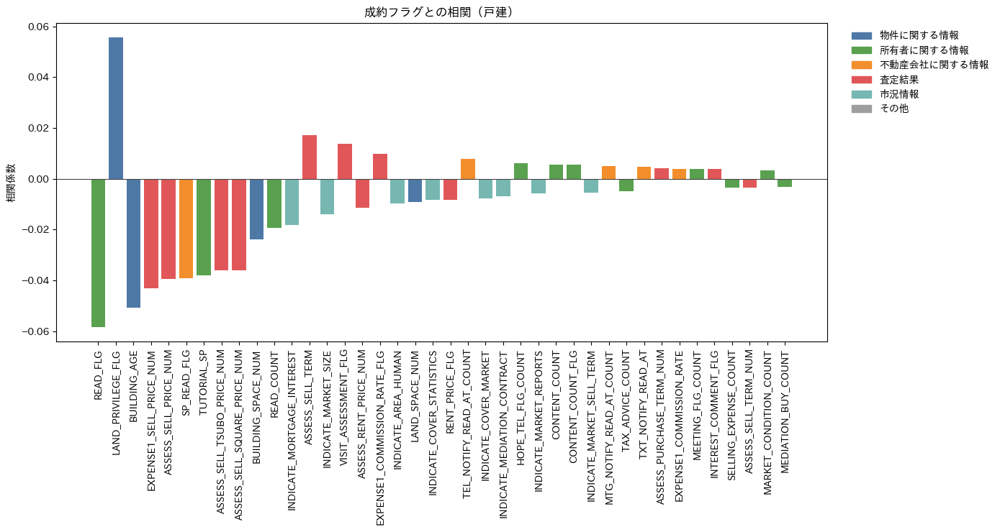

In [111]:

# ===== 1) 相関の準備（数値化→定数列除外） =====
ycol = '成約フラグ'
num = df_h.apply(pd.to_numeric, errors='coerce')              # 文字数値も強制数値化
const = num.columns[num.nunique(dropna=True) <= 1]  
# 3) 特定の列（カテゴリ変数など）を除外
exclude_cols = ['ID','USER_ID', 'DIRECTION']
num2 = num.drop(columns=exclude_cols, errors='ignore')
          # 分散0（定数）列
base = (num2.drop(columns=const, errors='ignore')
          .corrwith(num[ycol], method='pearson')    
          .drop(labels=[ycol], errors='ignore')
          .dropna())

# ===== 2) カテゴリ定義（必要に応じて追記） =====
C_PROP   = '物件に関する情報'
C_OWNER  = '所有者に関する情報'
C_AGENT  = '不動産会社に関する情報'
C_RESULT = '査定結果'
C_MARKET = '市況情報'
C_OTHER  = 'その他'

# 画像の表に合わせて“明示的に”割り当てたい列をここで指定
EXPLICIT = {
    # 物件
    'OWNER_SPACE_NUM': C_PROP, 'FLOOR_NUMBER': C_PROP, 'BUILDING_AGE': C_PROP,
    'DIRECTION': C_PROP,'PROPERTY_KIND': C_PROP,'ABOUT_ADDRESS': C_PROP,
    'ABOUT_TRAFFIC': C_PROP, 'ABOUT_LAND_PRIVILEGE': C_PROP,
    'ABOUT_USAGE_AREA': C_PROP, 'ABOUT_STRUCTURE': C_PROP, 'BUILDING_AGE': C_PROP,
    'ABOUT_FLOOR': C_PROP, 'ABOUT_UNIT_AMOUNT': C_PROP,
    'ABOUT_SELLER': C_PROP,'LAND_PRIVILEGE_FLG': C_PROP,'BUILDING_AGE_BIN': C_PROP,
    
    # 査定結果
    'ASSESSED_ON': C_RESULT,'ASSESS_SELL_PRICE': C_RESULT, 
    'ASSESS_SELL_TSUBO_PRICE': C_RESULT, 'ASSESS_SELL_SQUARE_PRICE': C_RESULT,
    'ASSESS_SELL_TERM': C_RESULT, 'ASSESS_PURCHASE_TERM': C_RESULT,
    'RENT_PRICE_FLG': C_RESULT, 'EXPENSE1_SELL_PRICE': C_RESULT,
    'EXPENSE1_COMMISSION_RATE': C_RESULT, 'INTEREST_COMMENT_FLG': C_RESULT,
    'VISIT_ASSESSMENT_FLG': C_RESULT,
    'EXPENCE1_SELL_PRICE': C_RESULT,'EXPENSE1_COMMISSION_RATE_FLG': C_RESULT,
    # 市況
    'INDICATE_MARKET_REPORTS': C_MARKET, 'INDICATE_COVER_STATISTICS': C_MARKET,
    'INDICATE_PRICE_HISTORY': C_MARKET, 'INDICATE_PRICE_HISTORY_GRAPH': C_MARKET,
    'INDICATE_PRICE_HISTORY_SELF_COMPARE': C_MARKET, 'INDICATE_PRICE_HISTORY_AREA_COMPARE': C_MARKET,
    'INDICATE_AREA_HUMAN': C_MARKET, 'INDICATE_AREA_HUMAN_GRAPH': C_MARKET,
    'INDICATE_AREA_HUMAN_TRANSITION_GRAPH': C_MARKET, 'INDICATE_COVER_MARKET': C_MARKET,
    'INDICATE_MARKET_SIZE': C_MARKET, 'INDICATE_MARKET_SELL_TERM': C_MARKET,
    'INDICATE_MORTGAGE_INTEREST': C_MARKET, 'INDICATE_FLOATING_INTEREST_COMMENT': C_MARKET,
    'INDICATE_MEDIATION_CONTRACT': C_MARKET,
    # 不動産会社（接客/通知ログ系）
    'USER_ID': C_AGENT, 'THX_NOTIFY_READ_AT_COUNT': C_AGENT,'COVER_STAFF_AND_COMPANY_NAME': C_AGENT,
    'EXPENCE1_SELL_PRICE': C_AGENT, 'EXPENSE1_COMMISSION_RATE': C_AGENT,
    'TXT_NOTIFY_READ_AT': C_AGENT, 'MTG_NOTIFY_READ_AT_COUNT': C_AGENT,
    'TEL_NOTIFY_READ_AT_COUNT': C_AGENT,'USER_ID_3730_FLG': C_AGENT,
    # 所有者（必要なら追加）
    'SELLING_EXPENSE_COUNT': C_OWNER,'READ_FLG': C_OWNER,
    'MEDIATION_BUY_COUNT': C_OWNER, 'MARKET_CONDITION_COUNT': C_OWNER,
    'PRICE_DETAIL_COUNT': C_OWNER,'CONSULTATION_MOVE_COUNT': C_OWNER,
    'TUTORIAL_SP': C_OWNER,'READ_COUNT': C_OWNER, 'CONTENT_COUNT': C_OWNER, 
    'MEETING_FLG_COUNT': C_OWNER,'TAX_ADVICE_COUNT': C_OWNER,
    'HOPE_TEL_FLG_COUNT': C_OWNER,'THANKS_COUNT': C_OWNER,'CONTENT_COUNT_FLG': C_OWNER,
    # 迷うもの・未定義はその他に落とす
}

# ルール（接頭辞・含有語）での自動振り分け
def infer_category(col: str) -> str:
    if col in EXPLICIT: 
        return EXPLICIT[col]
    c = col.lower()
    if c.startswith('about_') or any(k in c for k in ['owner_space', 'floor_number', 'building_age', 'direction', 'land_space', 'building_space']):
        return C_PROP
    if c.startswith('assess') or c.startswith('expense'):
        return C_RESULT
    if c.startswith('indicate') or 'market' in c or 'price_history' in c:
        return C_MARKET
    if any(k in c for k in ['read', 'notify', 'content', 'meeting', 'consultation', 'advice', 'hope_tel', 'visit_assessment']):
        return C_AGENT
    if 'seller' in c or 'owner' in c:
        return C_OWNER
    return C_OTHER

# ===== 3) 可視化（色分けバー） =====
PALETTE = {
    C_PROP:   '#4E79A7',
    C_OWNER:  '#59A14F',
    C_AGENT:  '#F28E2B',
    C_RESULT: '#E15759',
    C_MARKET: '#76B7B2',
    C_OTHER:  '#9E9E9E'
}

def plot_corr_colored(corr_series: pd.Series, top_n=40, sort_abs=True, add_prefix=False):
    dfc = corr_series.rename('corr').to_frame()
    dfc['feature']  = dfc.index
    dfc['category'] = dfc['feature'].map(infer_category)
    if sort_abs:
        dfc = dfc.reindex(dfc['corr'].abs().sort_values(ascending=False).index)
    else:
        dfc = dfc.sort_values('corr', ascending=False)
    if top_n is not None:
        dfc = dfc.head(top_n)

    labels = (dfc['category'] + ':' + dfc['feature']) if add_prefix else dfc['feature']
    colors = dfc['category'].map(PALETTE)

    fig_h = max(3.0, 0.35 * len(dfc))
    plt.figure(figsize=(max(12, 0.35*len(dfc)), 7.5))
    plt.bar(range(len(dfc)), dfc['corr'].values, color=colors)
    plt.axhline(0, color='#444', linewidth=0.8)
    plt.xticks(range(len(dfc)), labels, rotation=90)
    plt.ylabel('相関係数')
    plt.title('成約フラグとの相関（戸建）')

    # 凡例
    handles = [Patch(color=PALETTE[k], label=k) for k in [C_PROP, C_OWNER, C_AGENT, C_RESULT, C_MARKET, C_OTHER]]
    plt.legend(handles=handles, bbox_to_anchor=(1.02, 1), loc='upper left', frameon=False)

    plt.tight_layout()
    plt.show()

# 実行
plot_corr_colored(base, top_n=40, sort_abs=True, add_prefix=False)


In [112]:
# 相関係数の絶対値でソート → TOP10
top20 = (base.reindex(base.abs().sort_values(ascending=False).index)
              .head(20)
              .reset_index())

top20.columns = ["column", "correlation"]

# 小数点2桁に丸める
top20["correlation"] = top20["correlation"].round(2)

display(top20)

,column,correlation
0,READ_FLG,-0.060
1,LAND_PRIVILEGE_FLG,0.060
2,BUILDING_AGE,-0.050
3,EXPENSE1_SELL_PRICE_NUM,-0.040
4,ASSESS_SELL_PRICE_NUM,-0.040
5,SP_READ_FLG,-0.040
6,TUTORIAL_SP,-0.040
7,ASSESS_SELL_TSUBO_PRICE_NUM,-0.040
8,ASSESS_SELL_SQUARE_PRICE_NUM,-0.040
9,BUILDING_SPACE_NUM,-0.020


### 各説明変数と成約フラグとの関係（散布図・棒グラフの描画） ###

In [113]:
numeric_cols = [
    'LAND_SPACE_NUM',
    'BUILDING_SPACE_NUM',
    'BUILDING_AGE',
    'ABOUT_FLOOR_NUM',
    'ASSESS_SELL_PRICE_NUM',
    'ASSESS_SELL_SQUARE_PRICE_NUM',
    'ASSESS_SELL_TSUBO_PRICE_NUM',
    'ASSESS_SELL_TERM',
    'ASSESS_SELL_TERM_NUM',
    'ASSESS_PURCHASE_TERM_NUM',
    'EXPENSE1_SELL_PRICE_NUM',
    'EXPENSE1_COMMISSION_RATE',
    'READ_COUNT',
    'CONTENT_COUNT',
    'PRICE_DETAIL_COUNT',
    'MEDIATION_BUY_COUNT',
    'MARKET_CONDITION_COUNT',
    'CONSULTATION_MOVE_COUNT',
    'TAX_ADVICE_COUNT',
    'SELLING_EXPENSE_COUNT',
    'THANKS_COUNT',
    'THX_NOTIFY_READ_AT_COUNT'
]

binary_cols  = [
    'LAND_PRIVILEGE_FLG',
    'VISIT_ASSESSMENT_FLG',
    'RENT_PRICE_FLG',
    'INDICATE_COVER_STATISTICS',
    'INDICATE_MARKET_REPORTS',
    'INDICATE_PRICE_HISTORY',
    'INDICATE_PRICE_HISTORY_GRAPH',
    'INDICATE_PRICE_HISTORY_SELF_COMPARE',
    'INDICATE_PRICE_HISTORY_AREA_COMPARE',
    'INDICATE_AREA_HUMAN',
    'INDICATE_AREA_HUMAN_AGE_GRAPH',
    'INDICATE_AREA_HUMAN_TRANSITION_GRAPH',
    'INDICATE_COVER_MARKET',
    'INDICATE_MARKET_SIZE',
    'INDICATE_MARKET_SELL_TERM',
    'INDICATE_MORTGAGE_INTEREST',
    'INDICATE_FLOATING_INTEREST_COMMENT',
    'INTEREST_COMMENT_FLG',
    'INDICATE_MEDIATION_CONTRACT',
    'EXPENSE1_COMMISSION_RATE_FLG',
    'SP_READ_FLG',
    'TUTORIAL_SP',
    'READ_FLG',
    'CONTENT_COUNT_FLG',
    'TXT_NOTIFY_READ_AT',
    'HOPE_TEL_FLG_COUNT',
    'TEL_NOTIFY_READ_AT_COUNT',
    'MEETING_FLG_COUNT',
    'MTG_NOTIFY_READ_AT_COUNT'
]

categorical_cols = [
"PREFECTURE","REGION","USAGE_AREA_REP","STRUCTURE_CAT",'BUILDING_AGE_BIN'
]

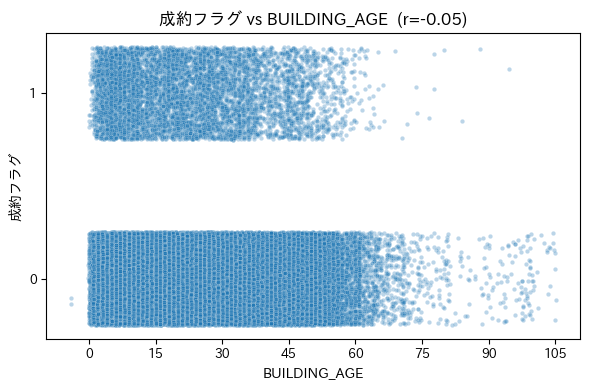

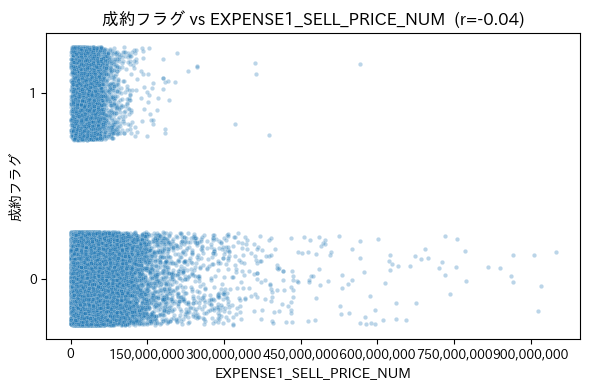

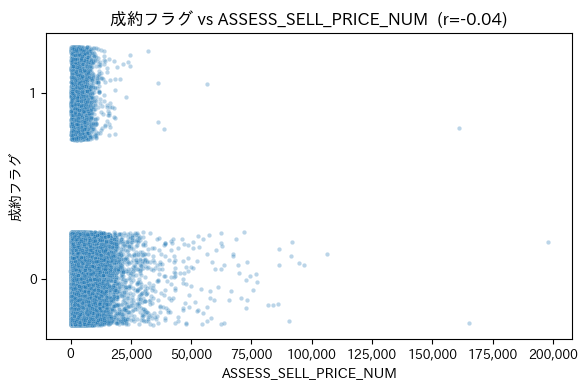

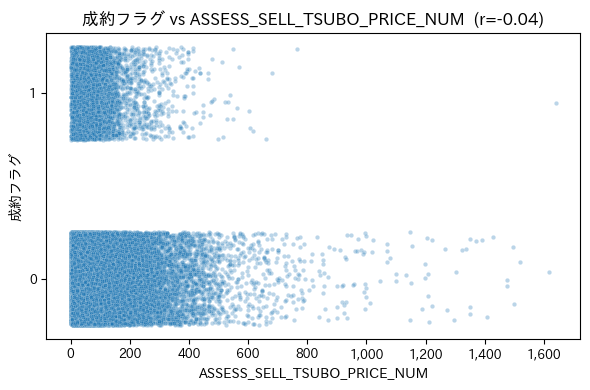

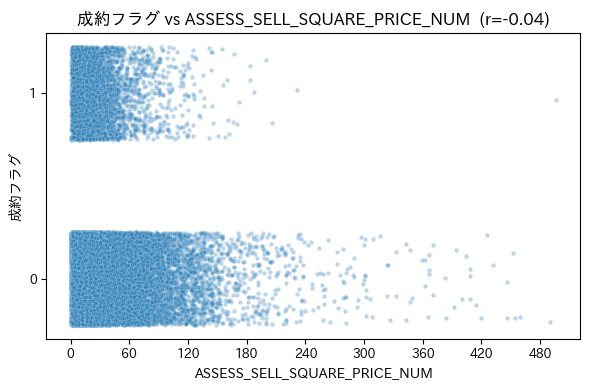

...

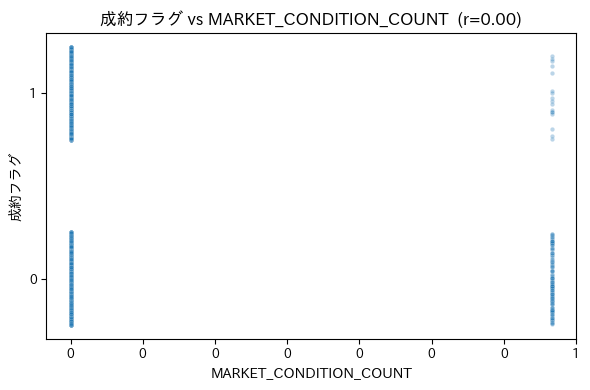

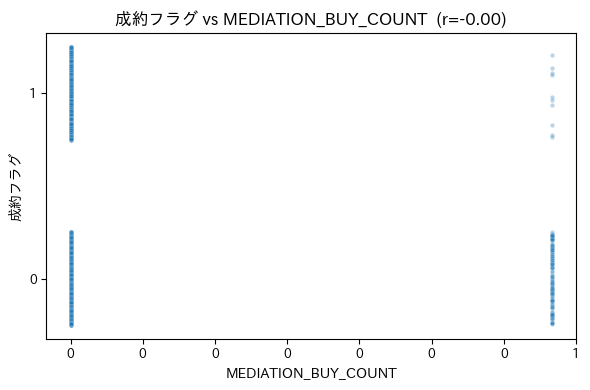

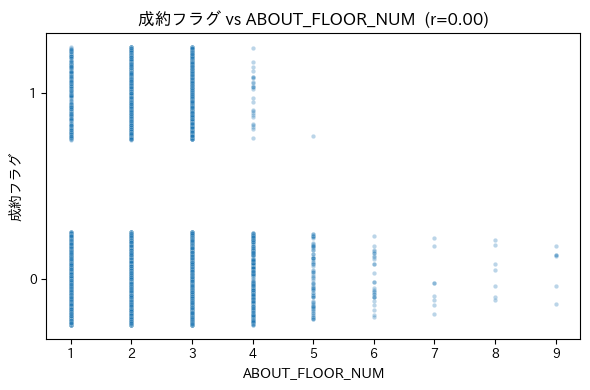

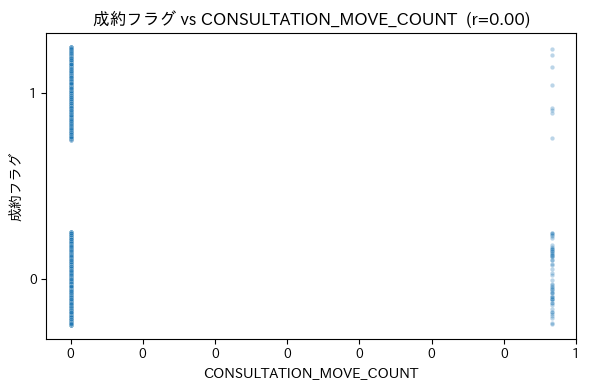

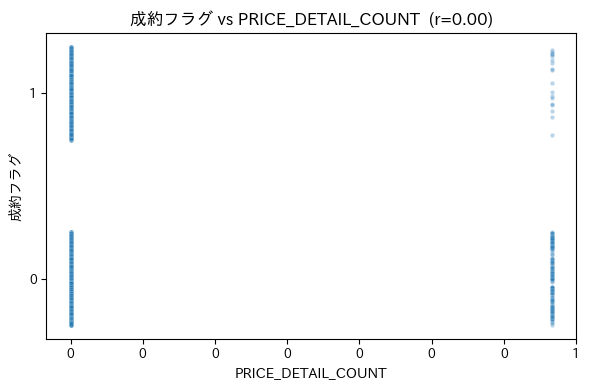


=== READ_FLG vs 成約フラグ ===
成約フラグ        0     1  成約率差分(1-0)
READ_FLG                        
0        0.886 0.114      -0.046
1        0.932 0.068      -0.046


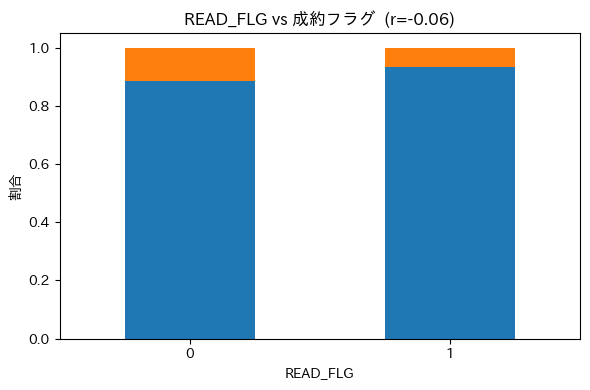


=== LAND_PRIVILEGE_FLG vs 成約フラグ ===
成約フラグ                  0     1  成約率差分(1-0)
LAND_PRIVILEGE_FLG                        
0                  0.943 0.057       0.054
1                  0.889 0.111       0.054


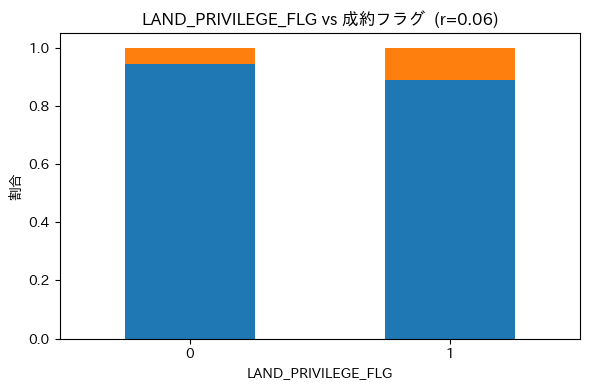


=== SP_READ_FLG vs 成約フラグ ===
成約フラグ           0     1  成約率差分(1-0)
SP_READ_FLG                        
0           0.891 0.109      -0.047
1           0.938 0.062      -0.047


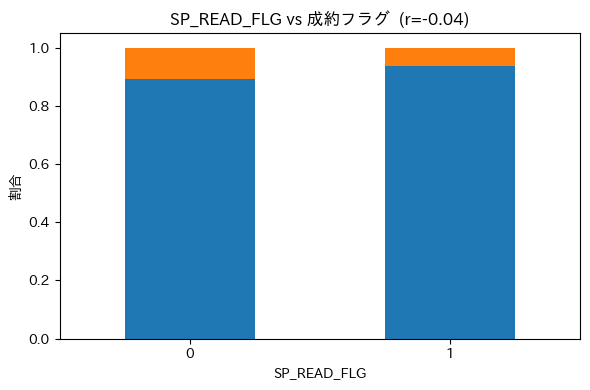


=== TUTORIAL_SP vs 成約フラグ ===
成約フラグ           0     1  成約率差分(1-0)
TUTORIAL_SP                        
0           0.891 0.109      -0.040
1           0.931 0.069      -0.040


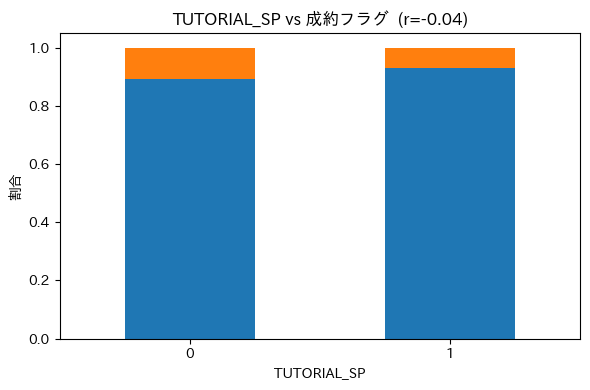


=== INDICATE_MORTGAGE_INTEREST vs 成約フラグ ===
成約フラグ                          0     1  成約率差分(1-0)
INDICATE_MORTGAGE_INTEREST                        
0                          0.825 0.175      -0.071
1                          0.895 0.105      -0.071


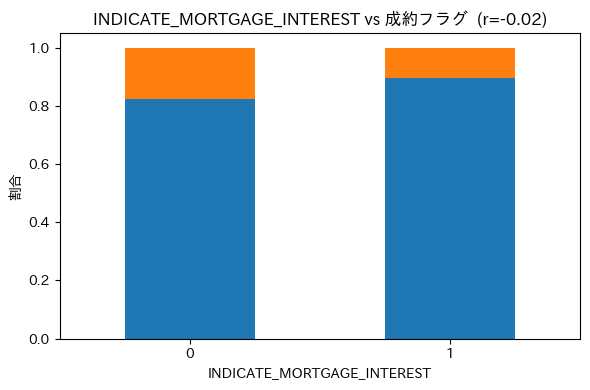


=== INDICATE_MARKET_SIZE vs 成約フラグ ===
成約フラグ                    0     1  成約率差分(1-0)
INDICATE_MARKET_SIZE                        
0                    0.810 0.190      -0.085
1                    0.895 0.105      -0.085


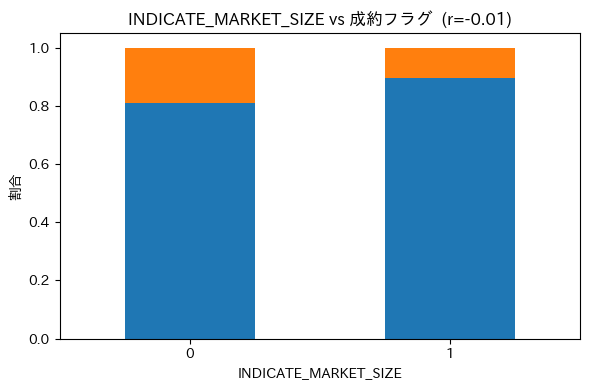


=== VISIT_ASSESSMENT_FLG vs 成約フラグ ===
成約フラグ                    0     1  成約率差分(1-0)
VISIT_ASSESSMENT_FLG                        
0                    0.895 0.105       0.228
1                    0.667 0.333       0.228


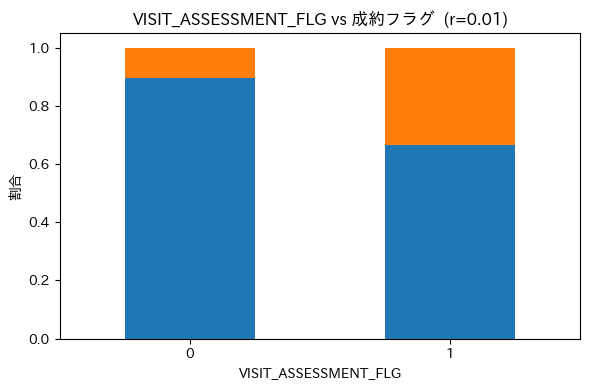


=== EXPENSE1_COMMISSION_RATE_FLG vs 成約フラグ ===
成約フラグ                            0     1  成約率差分(1-0)
EXPENSE1_COMMISSION_RATE_FLG                        
0                            0.900 0.100       0.007
1                            0.893 0.107       0.007


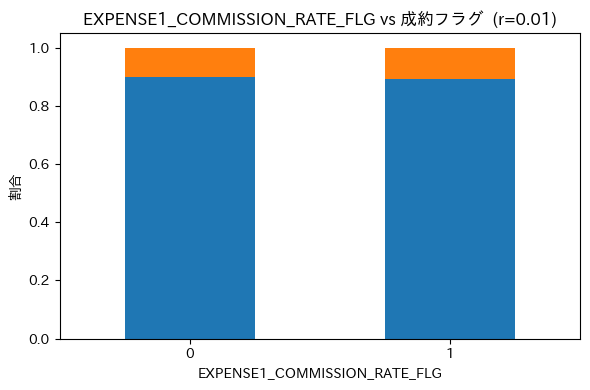


=== INDICATE_AREA_HUMAN vs 成約フラグ ===
成約フラグ                   0     1  成約率差分(1-0)
INDICATE_AREA_HUMAN                        
0                   0.852 0.148      -0.043
1                   0.895 0.105      -0.043


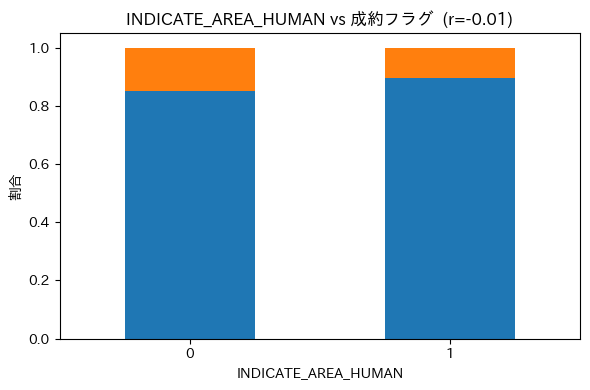


=== INDICATE_COVER_STATISTICS vs 成約フラグ ===
成約フラグ                         0     1  成約率差分(1-0)
INDICATE_COVER_STATISTICS                        
0                         0.836 0.164      -0.059
1                         0.895 0.105      -0.059


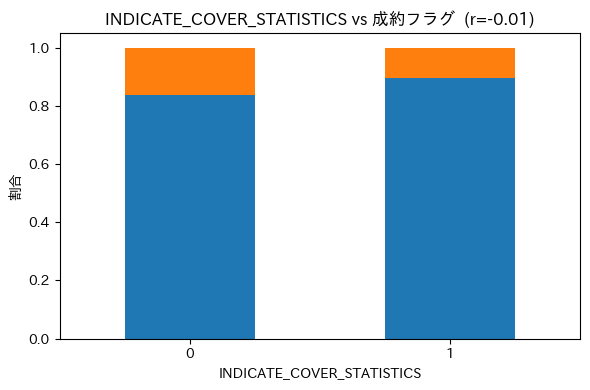


=== RENT_PRICE_FLG vs 成約フラグ ===
成約フラグ              0     1  成約率差分(1-0)
RENT_PRICE_FLG                        
0              0.894 0.106      -0.039
1              0.934 0.066      -0.039


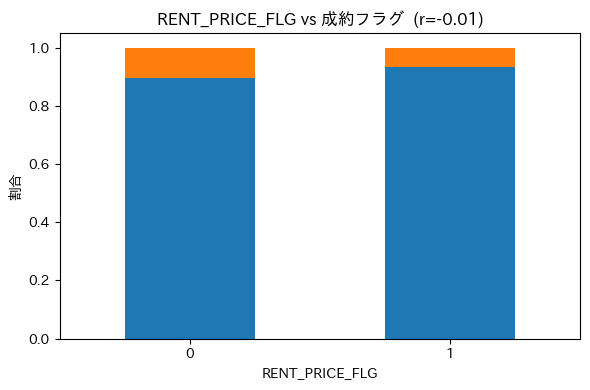


=== TEL_NOTIFY_READ_AT_COUNT vs 成約フラグ ===
成約フラグ                        0     1  成約率差分(1-0)
TEL_NOTIFY_READ_AT_COUNT                        
0                        0.895 0.105       0.125
1                        0.769 0.231       0.125


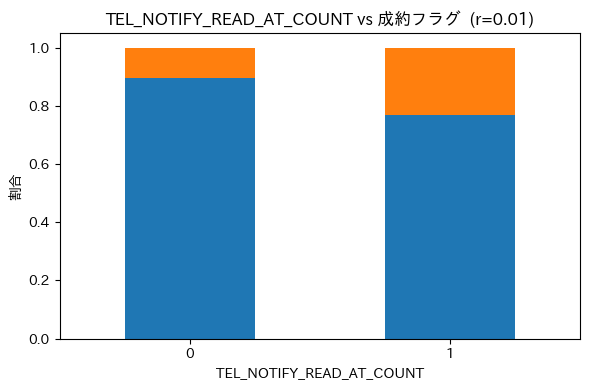


=== INDICATE_COVER_MARKET vs 成約フラグ ===
成約フラグ                     0     1  成約率差分(1-0)
INDICATE_COVER_MARKET                        
0                     0.832 0.168      -0.063
1                     0.895 0.105      -0.063


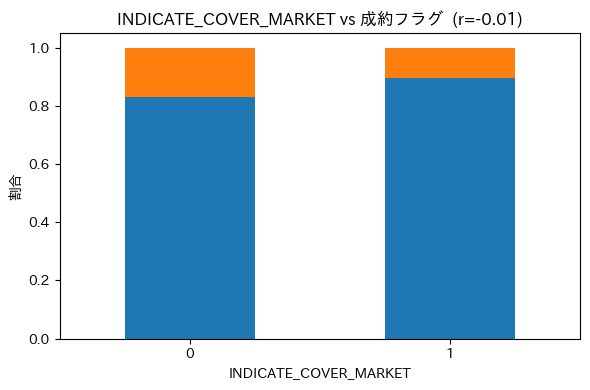


=== INDICATE_MEDIATION_CONTRACT vs 成約フラグ ===
成約フラグ                           0     1  成約率差分(1-0)
INDICATE_MEDIATION_CONTRACT                        
0                           0.857 0.143      -0.038
1                           0.895 0.105      -0.038


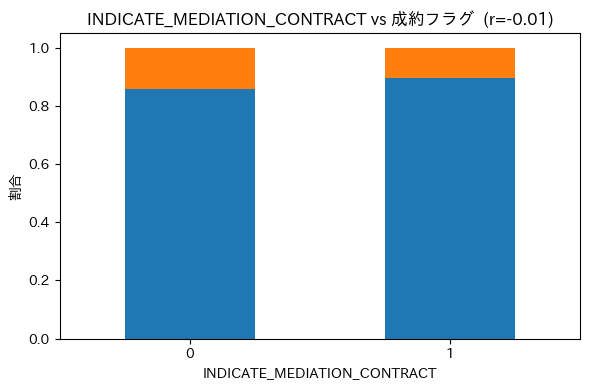


=== HOPE_TEL_FLG_COUNT vs 成約フラグ ===
成約フラグ                  0     1  成約率差分(1-0)
HOPE_TEL_FLG_COUNT                        
0                  0.895 0.105       0.088
1                  0.806 0.194       0.088


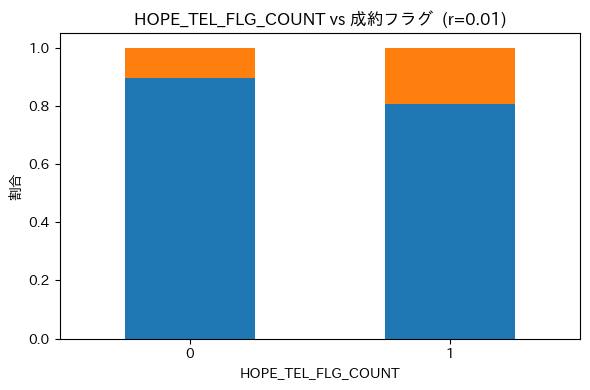


=== INDICATE_MARKET_REPORTS vs 成約フラグ ===
成約フラグ                       0     1  成約率差分(1-0)
INDICATE_MARKET_REPORTS                        
0                       0.892 0.108      -0.004
1                       0.896 0.104      -0.004


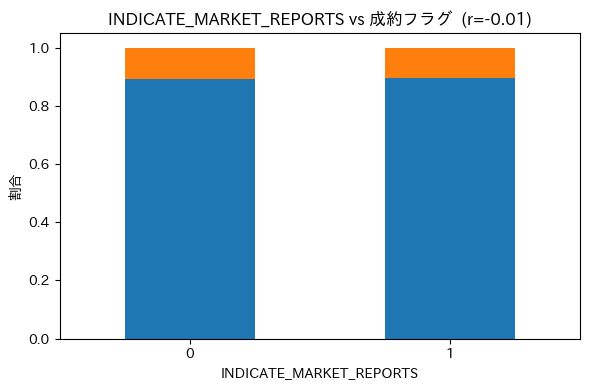


=== CONTENT_COUNT_FLG vs 成約フラグ ===
成約フラグ                 0     1  成約率差分(1-0)
CONTENT_COUNT_FLG                        
0                 0.895 0.105       0.041
1                 0.853 0.147       0.041


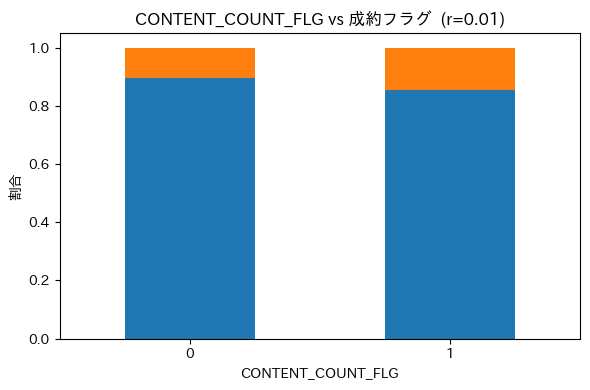


=== INDICATE_MARKET_SELL_TERM vs 成約フラグ ===
成約フラグ                         0     1  成約率差分(1-0)
INDICATE_MARKET_SELL_TERM                        
0                         0.867 0.133      -0.028
1                         0.895 0.105      -0.028


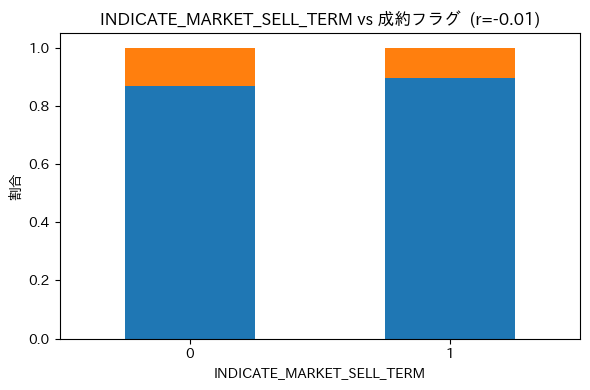


=== MTG_NOTIFY_READ_AT_COUNT vs 成約フラグ ===
成約フラグ                        0     1  成約率差分(1-0)
MTG_NOTIFY_READ_AT_COUNT                        
0                        0.895 0.105       0.080
1                        0.815 0.185       0.080


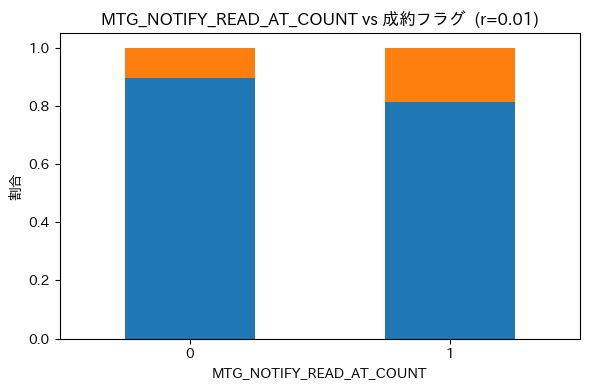


=== TXT_NOTIFY_READ_AT vs 成約フラグ ===
成約フラグ                  0     1  成約率差分(1-0)
TXT_NOTIFY_READ_AT                        
0.000              0.895 0.105       0.038
1.000              0.857 0.143       0.038


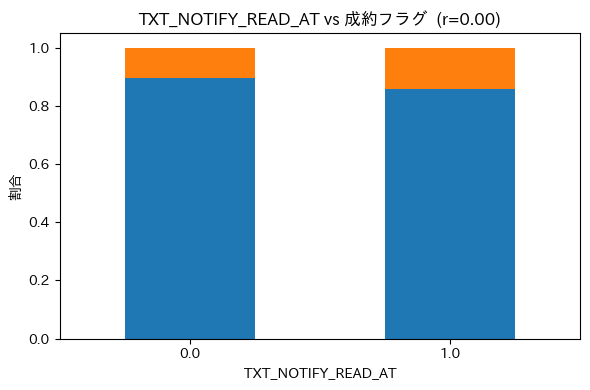


=== MEETING_FLG_COUNT vs 成約フラグ ===
成約フラグ                 0     1  成約率差分(1-0)
MEETING_FLG_COUNT                        
0                 0.895 0.105       0.056
1                 0.839 0.161       0.056


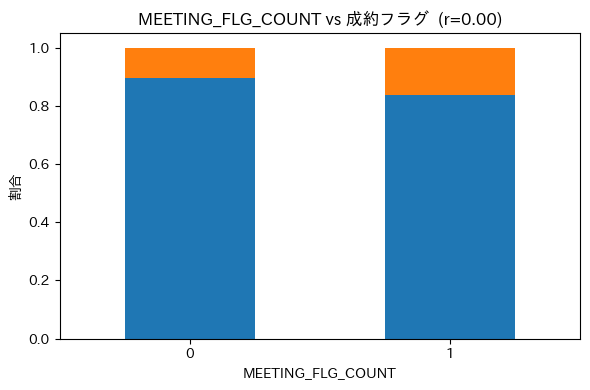


=== INTEREST_COMMENT_FLG vs 成約フラグ ===
成約フラグ                    0     1  成約率差分(1-0)
INTEREST_COMMENT_FLG                        
0                    0.896 0.104       0.002
1                    0.893 0.107       0.002


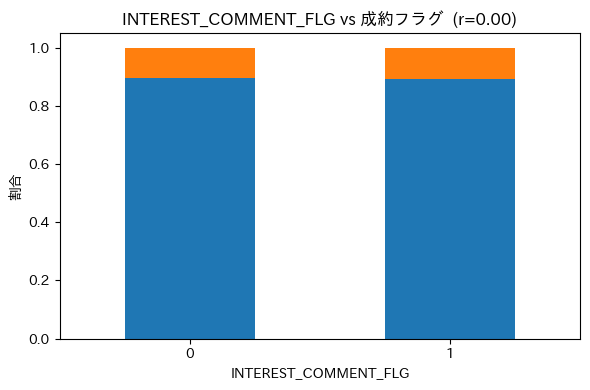


=== INDICATE_AREA_HUMAN_AGE_GRAPH vs 成約フラグ ===
成約フラグ                             0     1  成約率差分(1-0)
INDICATE_AREA_HUMAN_AGE_GRAPH                        
0                             0.923 0.077       0.028
1                             0.895 0.105       0.028


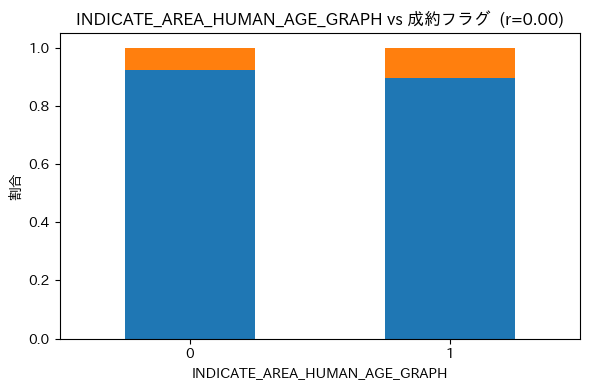


=== INDICATE_FLOATING_INTEREST_COMMENT vs 成約フラグ ===
成約フラグ                                  0     1  成約率差分(1-0)
INDICATE_FLOATING_INTEREST_COMMENT                        
0                                  0.875 0.125      -0.020
1                                  0.895 0.105      -0.020


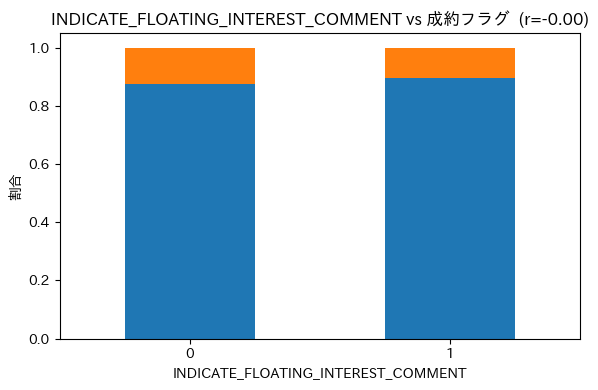


=== INDICATE_AREA_HUMAN_TRANSITION_GRAPH vs 成約フラグ ===
成約フラグ                                    0     1  成約率差分(1-0)
INDICATE_AREA_HUMAN_TRANSITION_GRAPH                        
0                                    0.895 0.105       0.000
1                                    0.895 0.105       0.000


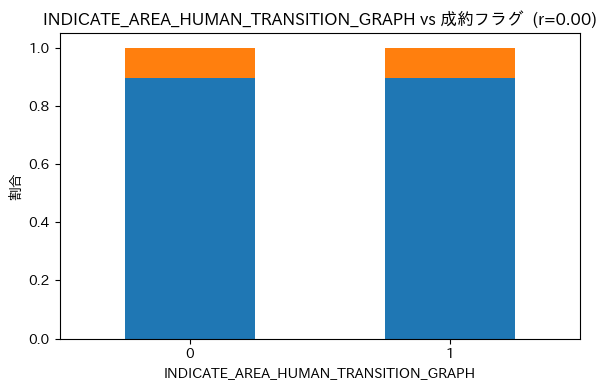


=== binary_cols まとめ表 ===


,カラム,成約率(0),成約率(1),差分(1-0),相関係数
0,READ_FLG,0.114,0.068,-0.046,-0.058
1,LAND_PRIVILEGE_FLG,0.057,0.111,0.054,0.056
2,SP_READ_FLG,0.109,0.062,-0.047,-0.039
3,TUTORIAL_SP,0.109,0.069,-0.040,-0.038
4,INDICATE_MORTGAGE_INTEREST,0.175,0.105,-0.071,-0.018
5,INDICATE_MARKET_SIZE,0.190,0.105,-0.085,-0.014
6,VISIT_ASSESSMENT_FLG,0.105,0.333,0.228,0.014
7,EXPENSE1_COMMISSION_RATE_FLG,0.100,0.107,0.007,0.010
8,INDICATE_AREA_HUMAN,0.148,0.105,-0.043,-0.010
9,INDICATE_COVER_STATISTICS,0.164,0.105,-0.059,-0.008



=== PREFECTURE のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
PREFECTURE,,,,
北海道,2764,0.881,0.119,11.900
青森県,14,0.929,0.071,7.100
岩手県,238,0.908,0.092,9.200
宮城県,435,0.768,0.232,23.200
秋田県,19,1.000,0.000,0.000
山形県,221,0.932,0.068,6.800
福島県,446,0.850,0.150,15.000
茨城県,2615,0.906,0.094,9.400
栃木県,392,0.862,0.138,13.800


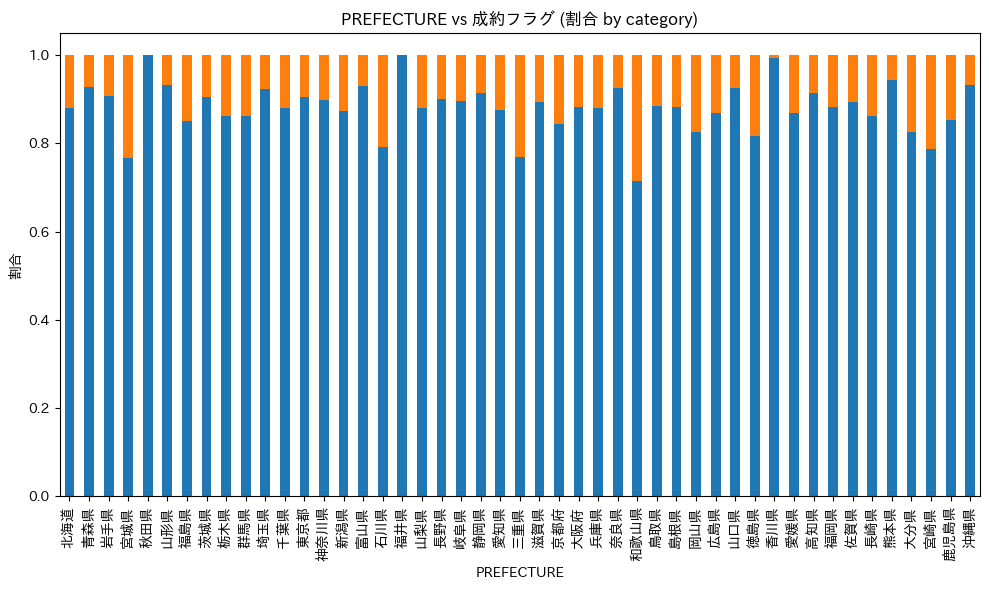


=== REGION のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
REGION,,,,
北海道,2764,0.881,0.119,11.900
東北,1373,0.850,0.150,15.000
関東,41266,0.904,0.096,9.600
中部,5464,0.887,0.113,11.300
近畿,9069,0.876,0.124,12.400
中国,1896,0.864,0.136,13.600
四国,1184,0.899,0.101,10.100
九州,5772,0.887,0.113,11.300
沖縄,266,0.932,0.068,6.800


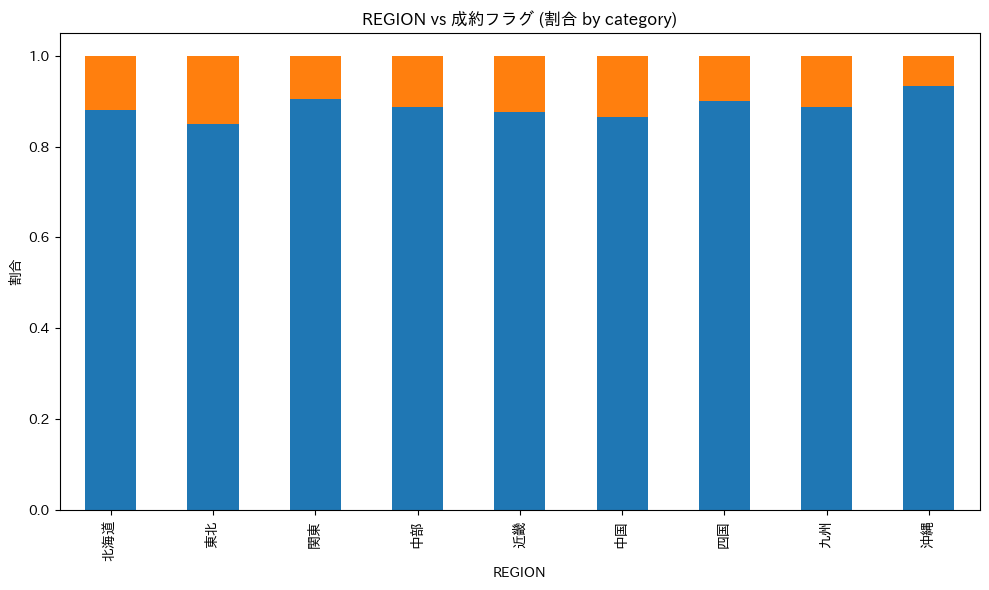


=== USAGE_AREA_REP のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
USAGE_AREA_REP,,,,
第一種低層住居専用地域,20803,0.885,0.115,11.500
第二種低層住居専用地域,568,0.914,0.086,8.600
第一種中高層住居専用地域,9938,0.895,0.105,10.500
第二種中高層住居専用地域,4056,0.898,0.102,10.200
第一種住居地域,12239,0.893,0.107,10.700
第二種住居地域,1636,0.901,0.099,9.900
準住居地域,489,0.924,0.076,7.600
近隣商業地域,1457,0.908,0.092,9.200
商業地域,845,0.933,0.067,6.700


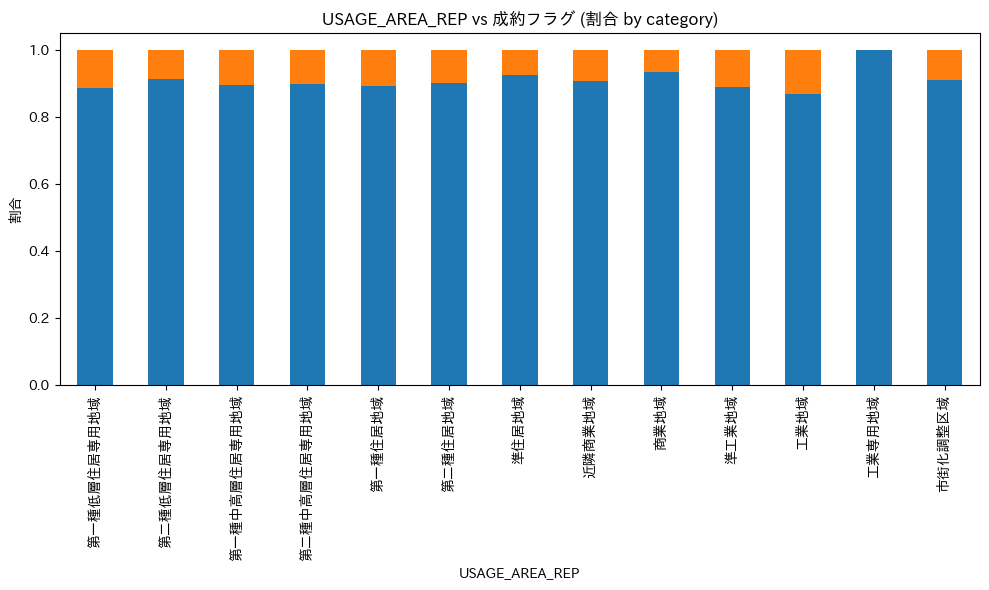


=== STRUCTURE_CAT のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
STRUCTURE_CAT,,,,
SRC,92,1.000,0.000,0.000
RC,1257,0.893,0.107,10.700
鉄骨,1826,0.893,0.107,10.700
軽量鉄骨,3378,0.850,0.150,15.000
木造,61840,0.896,0.104,10.400
その他,536,0.944,0.056,5.600


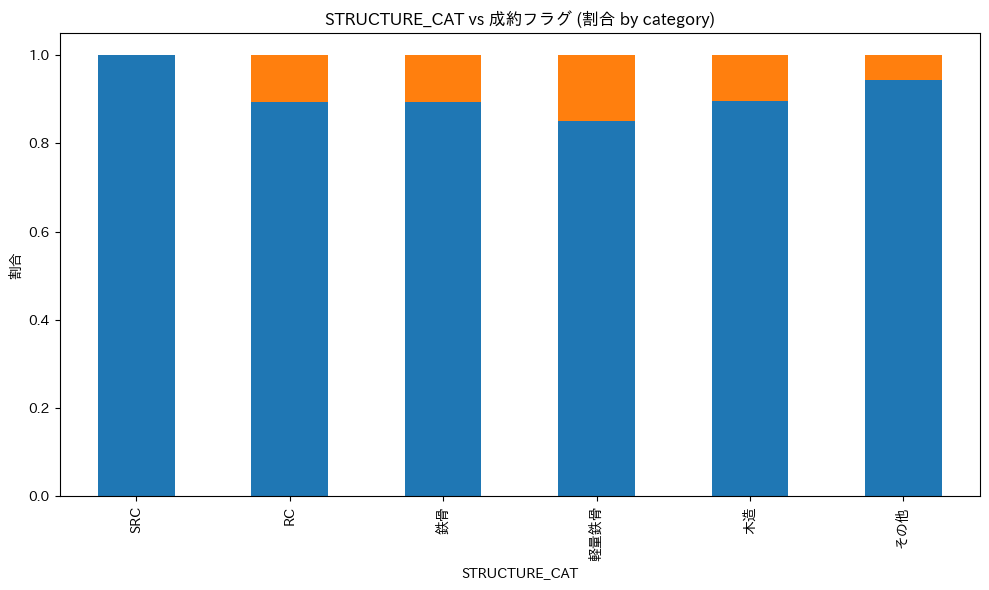


=== BUILDING_AGE_BIN のまとめ表 ===


,件数,非成約割合(0),成約割合(1),成約率(%)
BUILDING_AGE_BIN,,,,
1年目,718,0.955,0.045,4.500
2-9年,13490,0.874,0.126,12.600
10-19年,14869,0.889,0.111,11.100
20-29年,13652,0.888,0.112,11.200
30-39年,10464,0.894,0.106,10.600
40-49年,8503,0.917,0.083,8.300
50-59年,4806,0.931,0.069,6.900
60-69年,947,0.949,0.051,5.100
70-79年,211,0.967,0.033,3.300


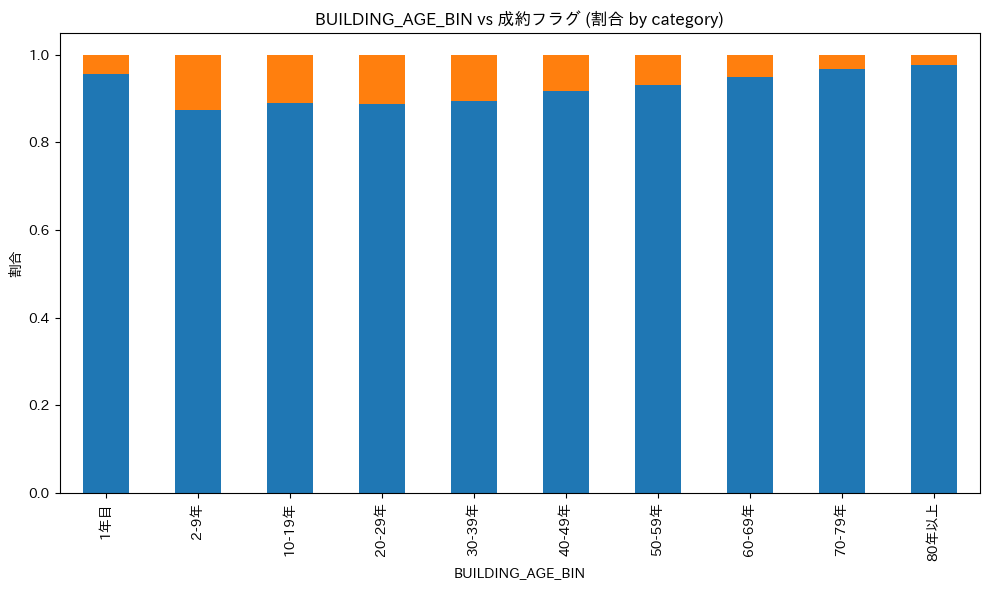

In [114]:
# すでに numeric_cols / binary_cols / categorical_cols を定義済みとする

visualize_with_base(df_h, base, target="成約フラグ", top_n=100)

### カテゴリ変数の件数分布 ###

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


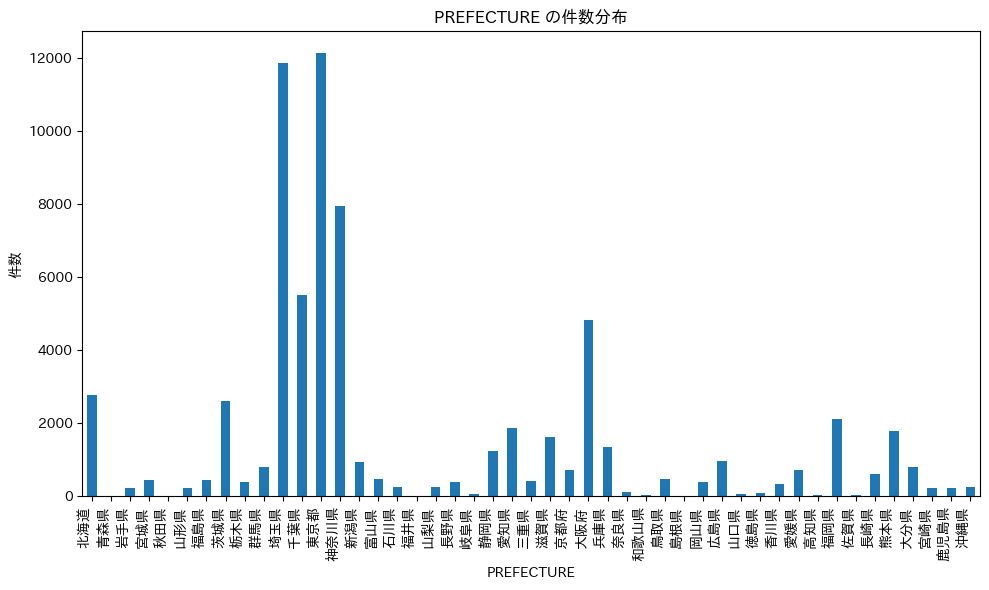

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


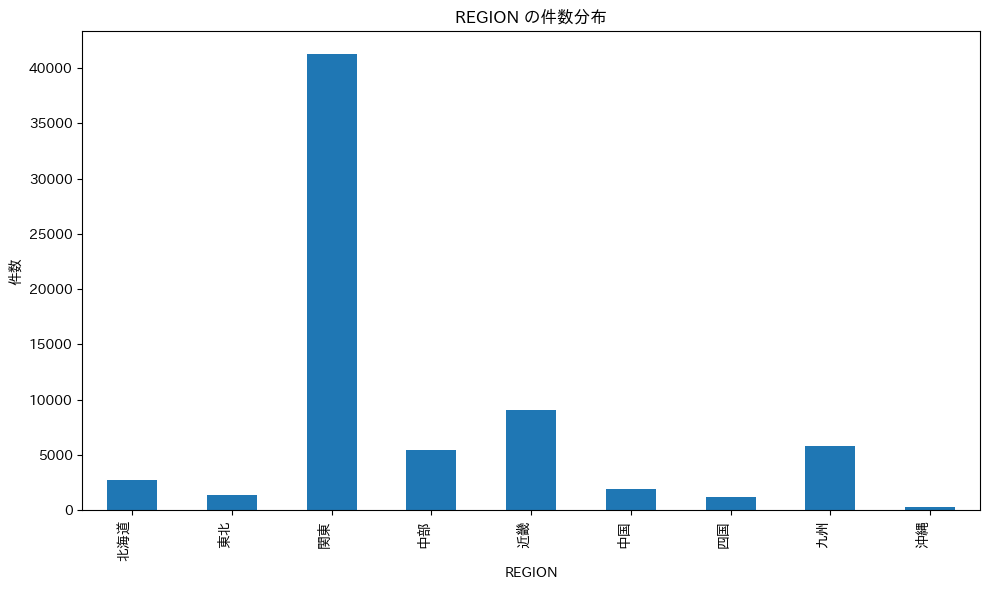

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


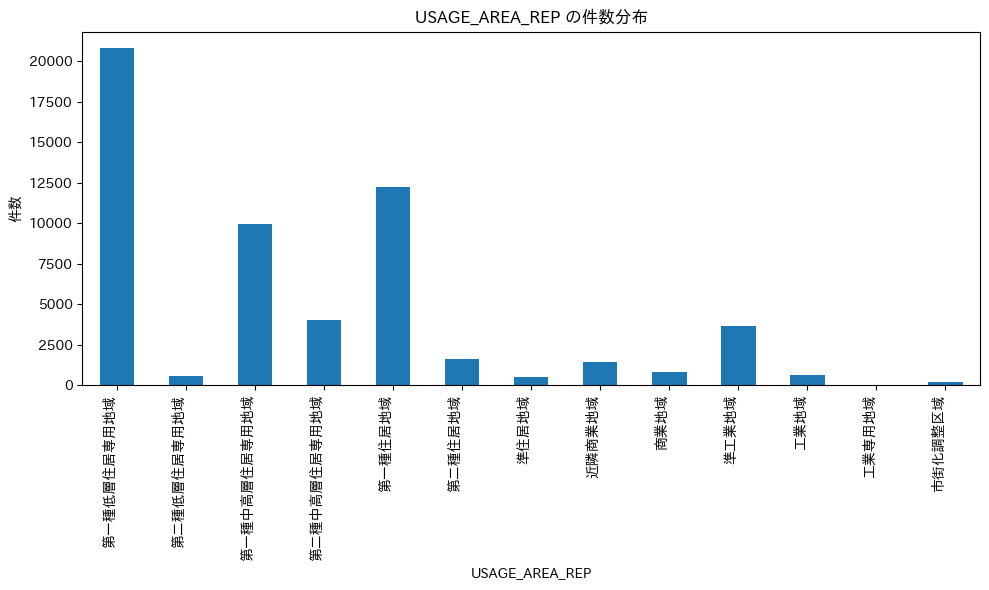

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


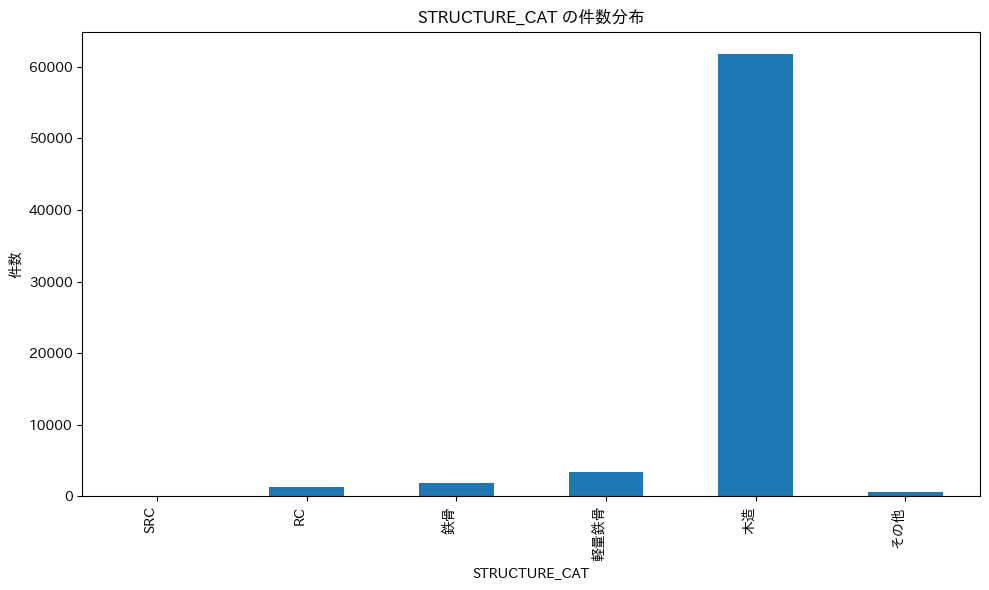

/var/folders/g0/2b_vns0j58s8vjrwhmlk88l40000gn/T/ipykernel_12593/3316245976.py:12: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(s):


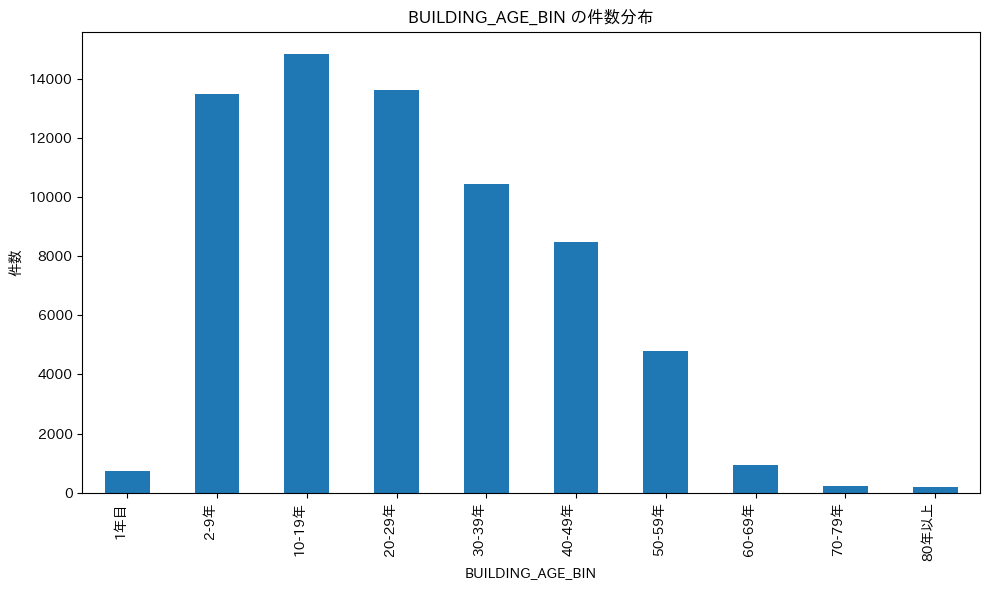

In [115]:
plot_categorical_distribution(df_h, categorical_cols)

### 欠損率の算出・保存 ###

In [116]:
# 関数の結果を変数に格納
missing_info = check_missing_info(df_h)

# CSVとして出力
missing_info.to_csv(os.path.join(OUTPUT_DIR, "missing_info_h.csv"), index=False, encoding="utf-8-sig")

### 考察(戸建) ###

**【数値変数について】**  
基本は相関係数の順番で関係はありそう  
・BUILDING_AGEは築年数が新すぎても古すぎても成約に繋がっていない  
→築年数をbinに分けて改めて相関をみる  
・CONTENT_COUNTはフラグ化検討  
・EXPENCE１_COMISSION_RATE  (手数料率）は、３％、5%以外は０の割合多いようにみえる  
→3%,5%とそれ以外でフラグ化を検討  
・ABOUT_FLOOR_NUMは相関係数０だが、階数が多くなるほど０である傾向が読み取れる  
→特徴量として検討  
**----------------------------------------------------------**  
→→→基本は相関係数上位を特徴量として検討。ABOUT_FLOOR_NUMについては特徴量として追加検討  
BUILDING_AGEはbinに分けて相関を見る  
CONTENT_COUNT、EXPENCE１_COMISSION_RATEはフラグ化検討  


**【バイナリ変数について】**  
相関係数が小さい/0.0であっても、0と1で割合の差分が大きいものもあった  
◾️相関係数が0.01以上あるが、割合の差分かかなり小さい  
・INDICATE_MARKET_REPORTS 
は特徴量として入れても無意味  

◾️相関係数は0.00だが、割合の差分が3.5%以上ある  
・TAX_ADVICE_COUNT  
・TXT_NOTIFY_READ_AT  
・MEETING_FLG_COUNT  
は特徴量に入れた方が良い可能性  
**----------------------------------------------------------**  
→→→基本は相関係数上位を特徴量として検討。一部変数について特徴量に追加を検討  

**【カテゴリ変数について】**   
・USER_IDについては、件数が2500件超と比較的多いUSER_ID=3730について、成約率も１０％以下と他のUSER_IDと比較しても低めなので特徴量として検討  
→USER_ID=3730とそれ以外のフラグ作成？  
・都道府県別では、埼玉県が成約割合が若干低いかつ、全体に占める件数も多い    
・地方別でも関東が最も成約数が多く、成約率も他地方より若干低め  
→特徴量として検討  
・用途地域については、第一種低層住居専用地域が若干成約割合が高いかつ全体に占める件数も少ない  
（第一種低層住居専用地域は用途制限は厳しいが基本的に住環境がよく、人気である→成約率高い可能性）  
→特徴量として検討  
・構造については、成約割合が高い/低い構造は全体に占める件数も少ない（そもそもほぼ木造である）  
**----------------------------------------------------------**  
→→→USER_ID、用途地域、都道府県/地方については特徴量として検討  

### 全体の欠損率の算出・保存 ###

In [117]:
df_all = pd.concat([df_m,df_l, df_h], ignore_index=True)

# 関数の結果を変数に格納
missing_info = check_missing_info(df_all)

# CSVとして出力
missing_info.to_csv(os.path.join(OUTPUT_DIR, "missing_info_all.csv"), index=False, encoding="utf-8-sig")